# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [ ]:
# if plotnine is not installed in Jupter then use the following command to install it 


Running this project require the following imports 

In [16]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN

from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

%matplotlib inline

In [18]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = ['blue', 'red', 'green', 'cyan', 'magenta', 'yellow', 'black', 'orange', 'purple', 'brown']
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 




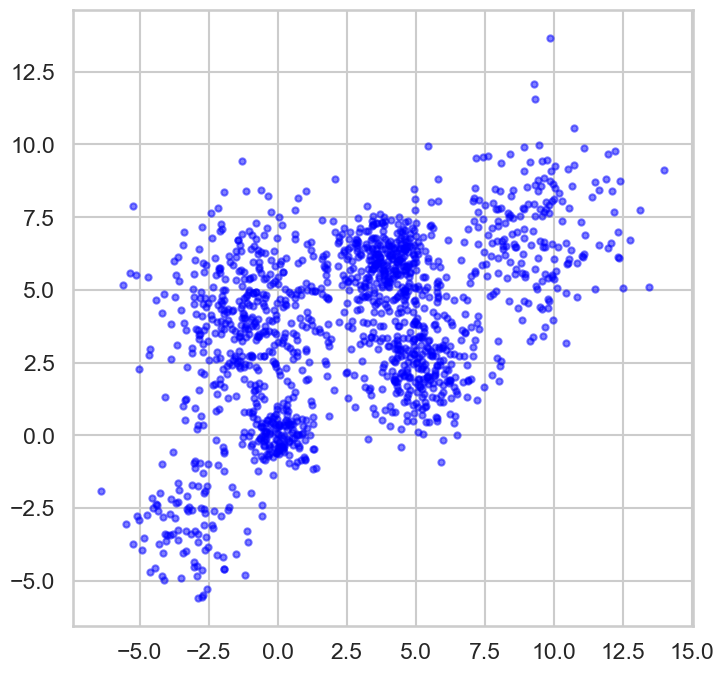

In [20]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

In [21]:
Best_Silhouettes=[]    #store the best Silhouette for every Clustering Approach to compare between them

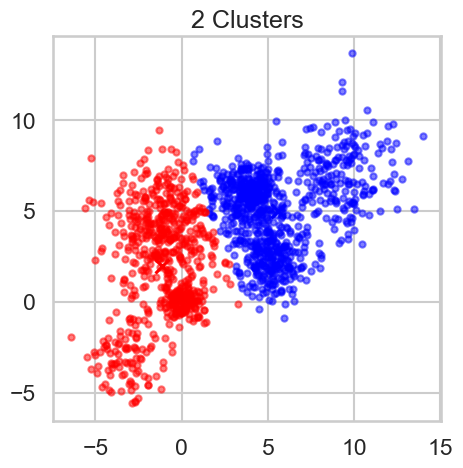

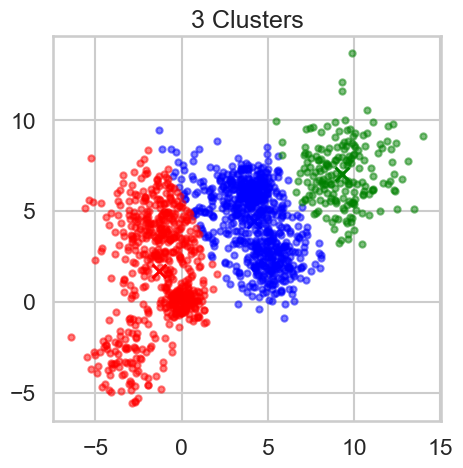

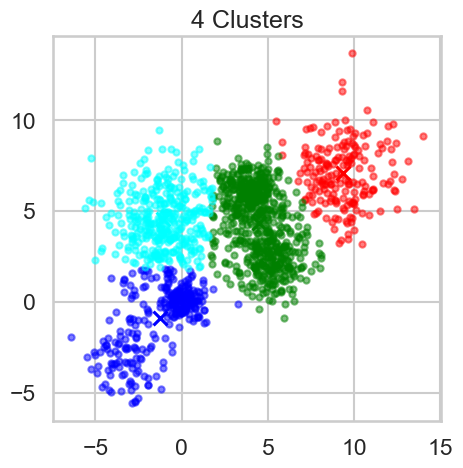

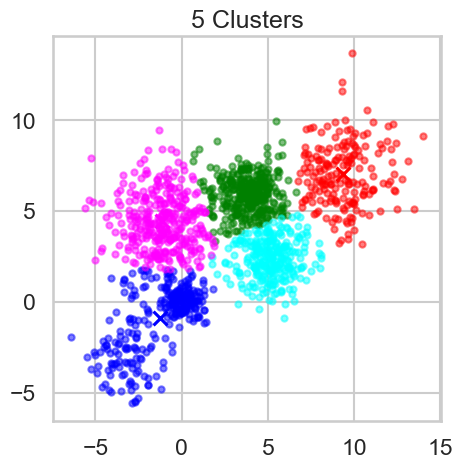

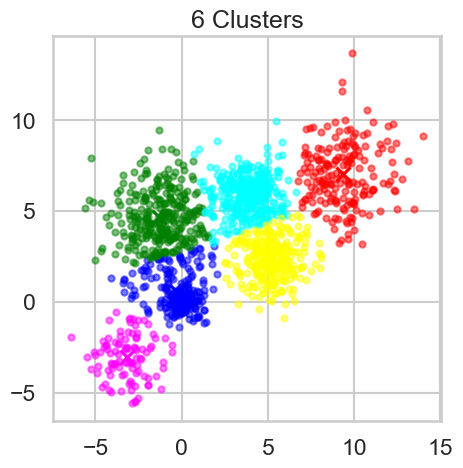

...

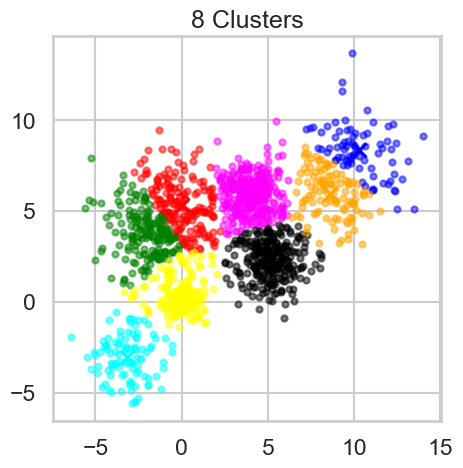

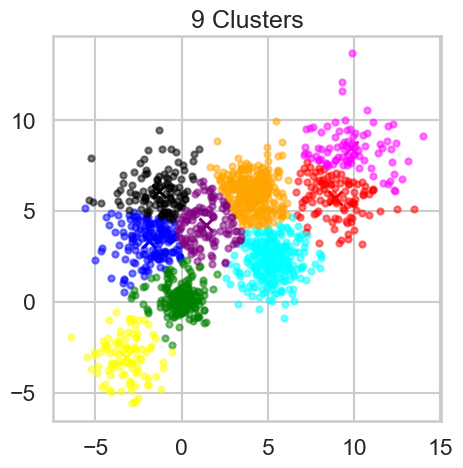

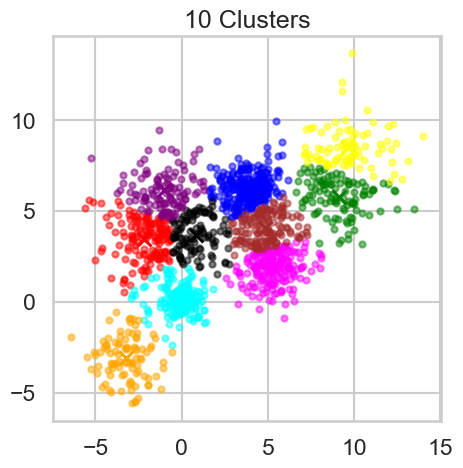

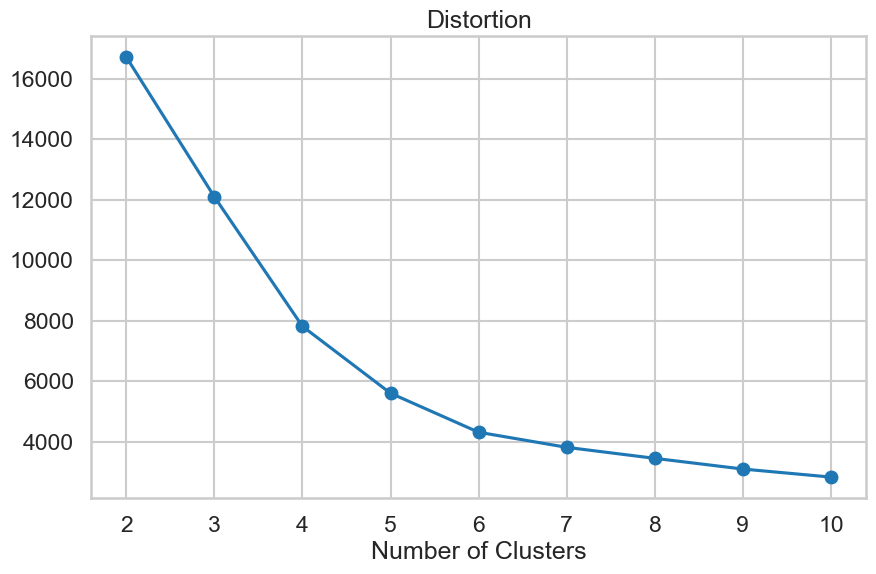

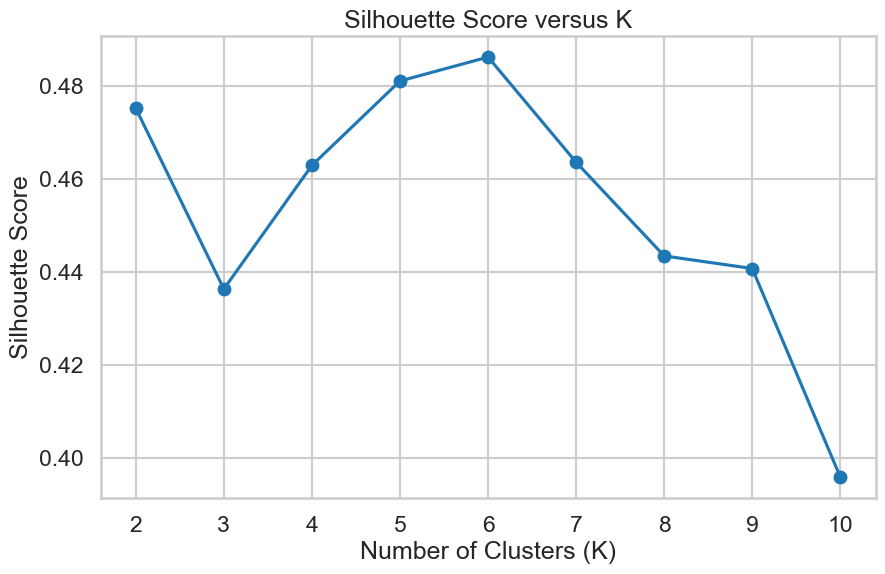

Best K based on silhouette score: 6 , Best Value: 0.48614459735646176
[0.48614459735646176]


In [22]:

k_values = range(2, 11)  # Tying clustering for K=2,3,4,......,10
distortions = []  # Store distortion value for each K
silhouette_scores_Kmean = []  # Store silhouette score for each K

# Perform KMeans clustering for different values of K
for k in k_values:
    #K_mean Clustering
    kmeans = KMeans(n_clusters=k, random_state=42)
    
    kmeans.fit(Multi_blob_Data)

    # Storing Distortion value for this number of clusters
    distortions.append(kmeans.inertia_)  
    # Storing silhouette value for this number of clusters
    silhouette_scores_Kmean.append(silhouette_score(Multi_blob_Data, kmeans.labels_,metric = 'euclidean'))

    # Plotting the clusters for the current K value
    plt.figure(figsize=(5, 5))
    display_cluster(Multi_blob_Data, kmeans, k)
    plt.title(f'{k} Clusters')
    

# Plotting distortion function versus K
plt.figure(figsize=(10, 6))
plt.plot(k_values, distortions, marker='o')
plt.title('Distortion')
plt.xlabel('Number of Clusters')
plt.xticks(k_values)
plt.show()

# Plotting silhouette score versus K
plt.figure(figsize=(10, 6))
plt.plot(k_values, silhouette_scores_Kmean, marker='o')
plt.title('Silhouette Score versus K')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')
plt.xticks(k_values)
plt.show()

# Choose the best K based on silhouette score
best_k = k_values[silhouette_scores_Kmean.index(max(silhouette_scores_Kmean))]
best_silhouette_value=max(silhouette_scores_Kmean)
print(f'Best K based on silhouette score: {best_k} , Best Value: {best_silhouette_value}')
Best_Silhouettes.append(best_silhouette_value)
print(Best_Silhouettes)


### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

<h1>Notes:</h1>
<h3>1)Dendograms depend only on Linkage and Affinity not the distance_threshold, so we plot the dendograms of the different combinations of Affinity and Linkage regardless the distance_threshold to avoid redundancy</h3>
<h3>2)The range of possible distance_thresholds depends on the combination of Affinity and Linkage : available distance_threshold for one combination may not be possible for another combination, the non possible distance_threshold will result in no clustering or putting every point in a unique cluster, which will result in ValueError when computing the sillhouette value  </h3> 
--> so I chose a general distance_threshold array that has at least a value that could fit in every combination of Affinities and Linkages, However, using a bigger array could be more usefull to find the absolute maximum silhouette value but this will be very computationaly and time expensive.  


In [23]:
Linkages=["single","average"]
Affinities=["euclidean","manhattan","cosine"]
Distance_thresholds=[0.0001,0.001,0.01,0.1,0,1,10,100,200,300]

# Initialize variables to store best parameters and silhouette score
best_params = {'affinity': None, 'linkage': None, 'distance_threshold': None}
best_silhouette_H = float('-inf')

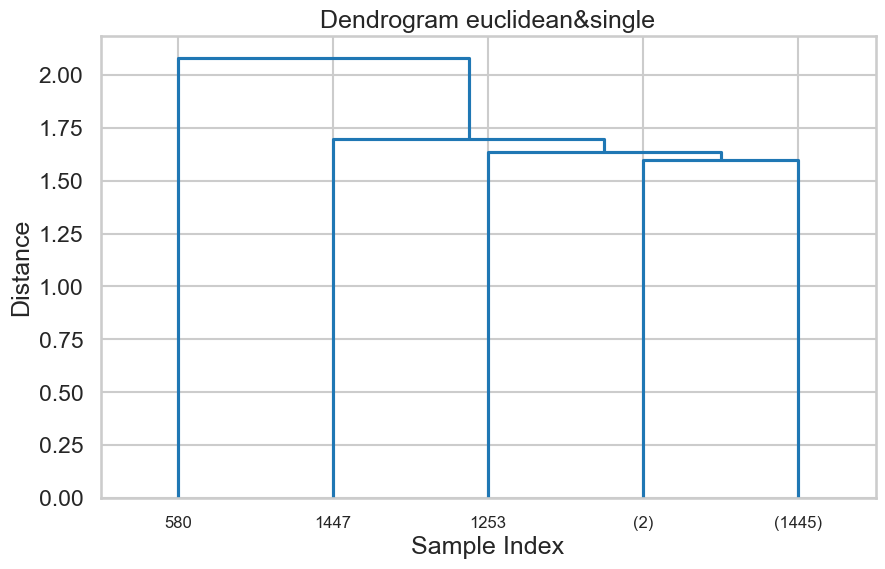

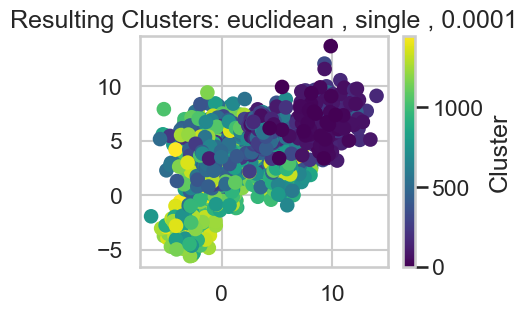

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


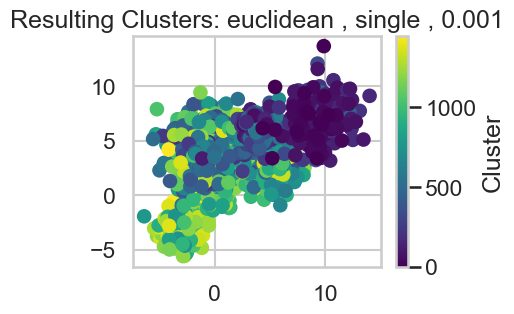

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


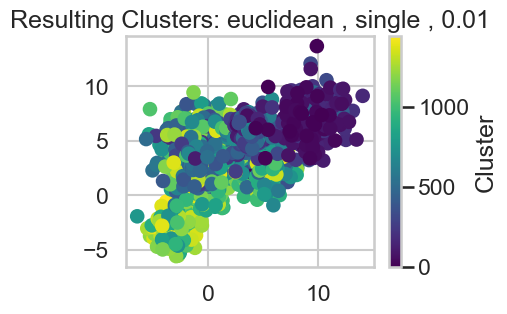

Silhouette Score: 0.004954541906625821


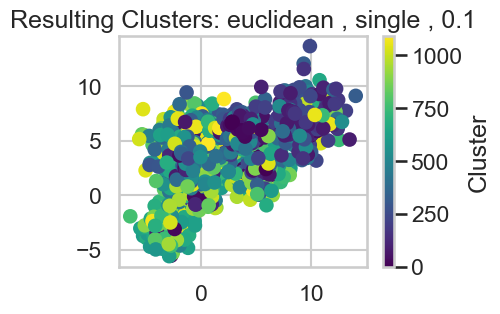

Silhouette Score: 0.1764277949915988


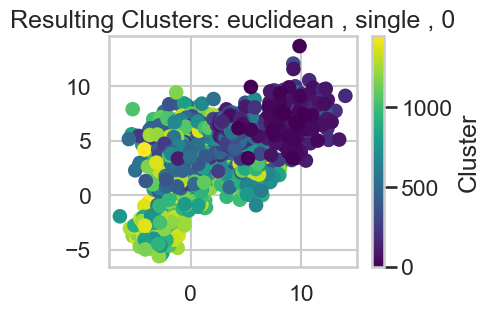

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


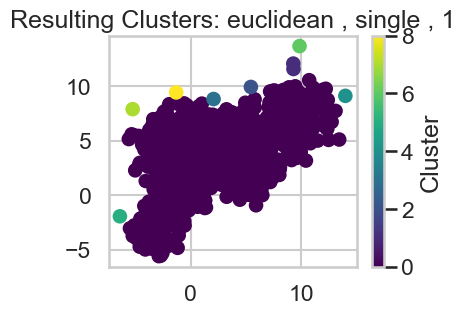

Silhouette Score: -0.14944154607335855


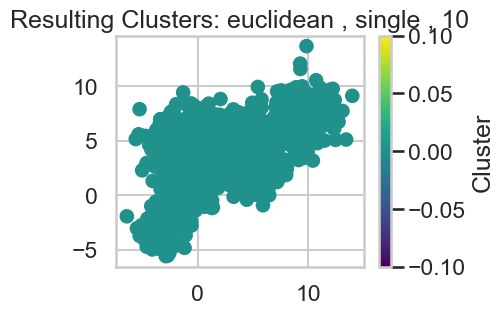

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


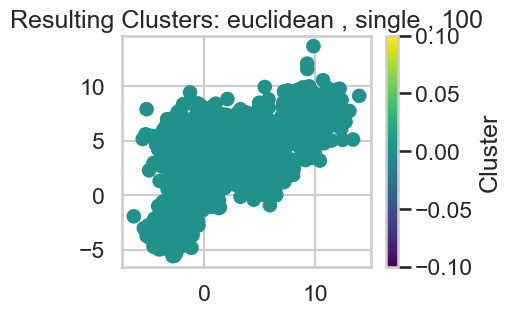

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


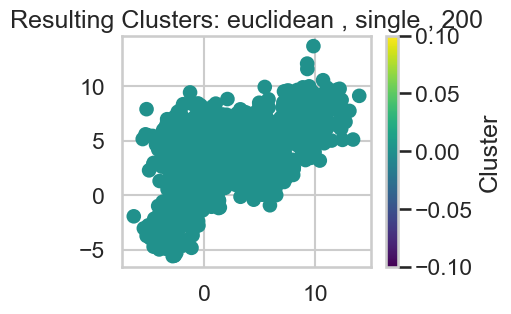

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


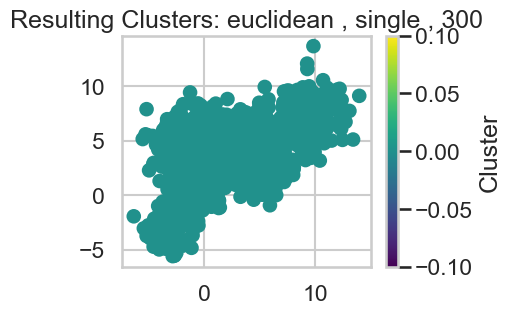

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


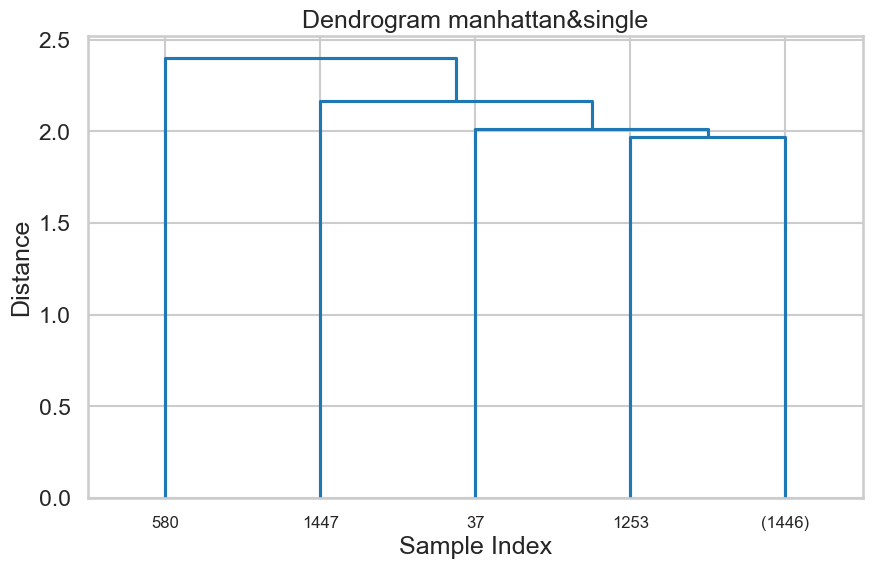

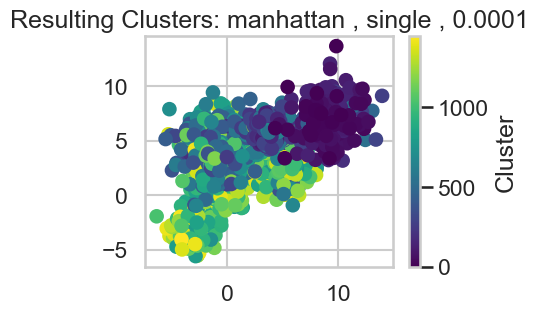

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


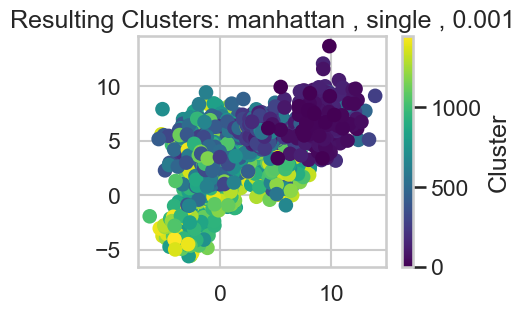

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


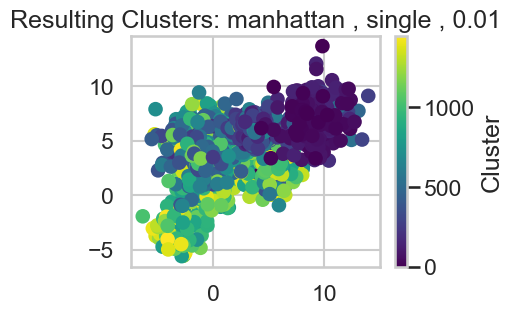

Silhouette Score: 0.002529173589646519


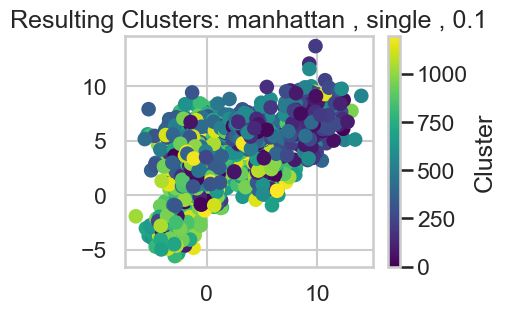

Silhouette Score: 0.15183196444771982


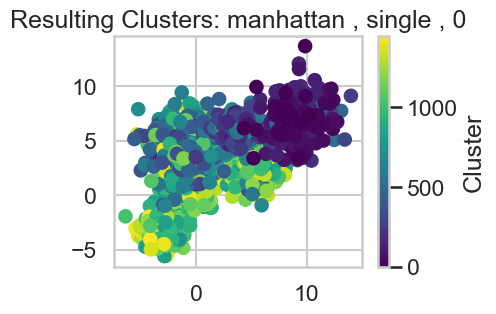

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


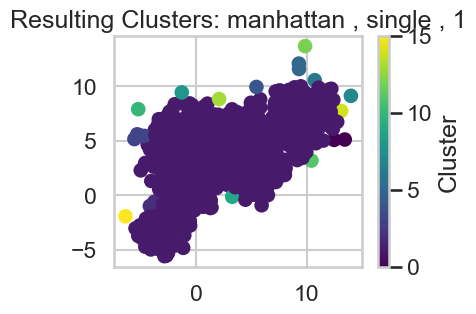

Silhouette Score: -0.4080040507331309


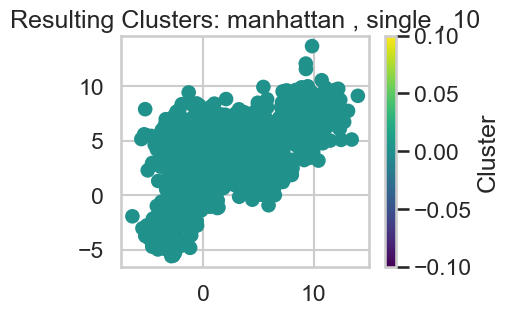

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


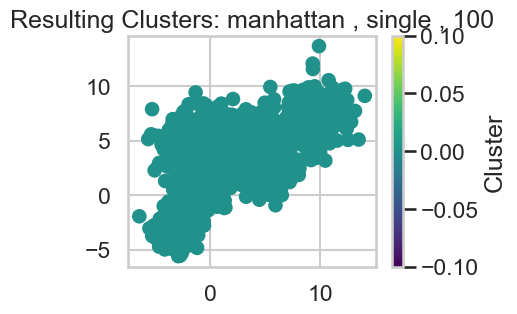

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


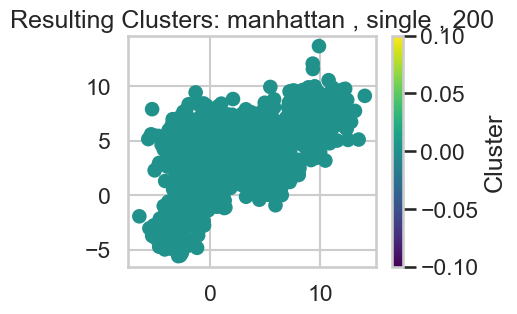

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


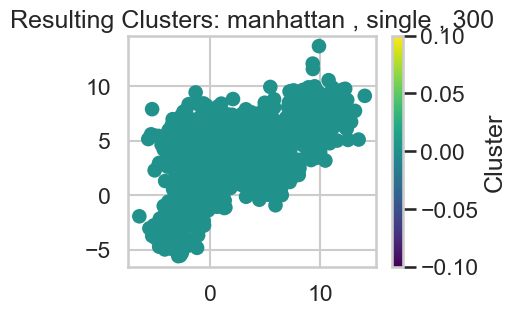

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


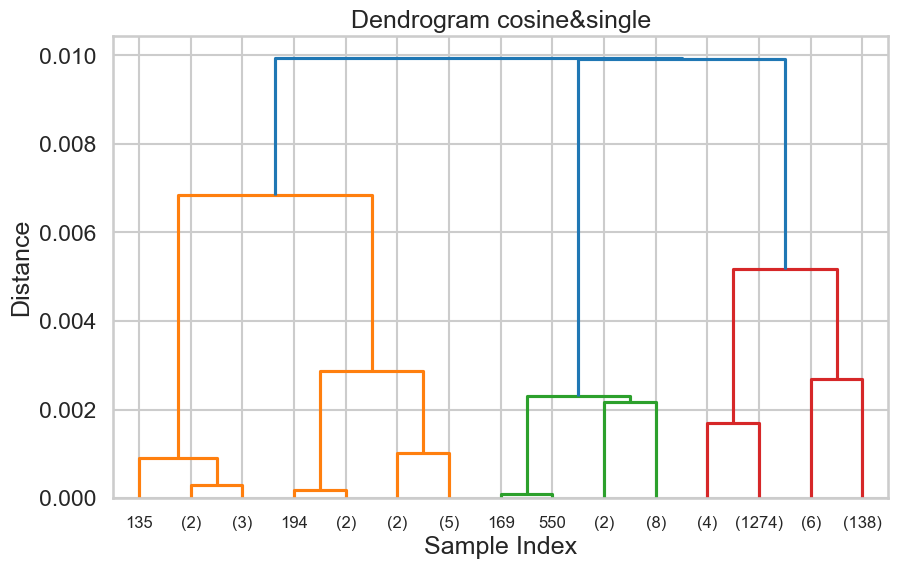

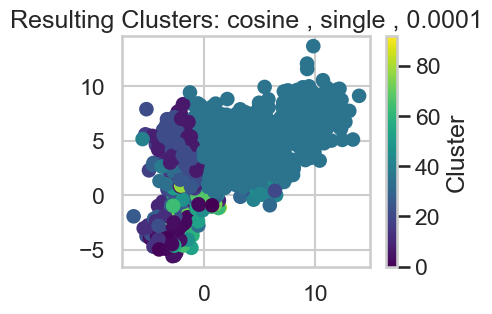

Silhouette Score: -0.15657577768412256


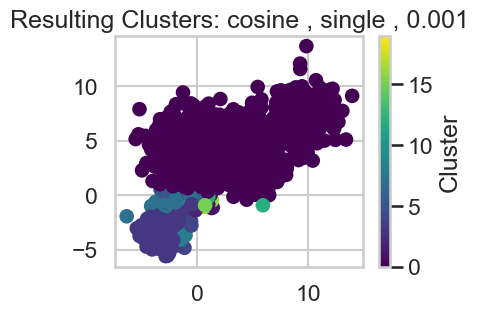

Silhouette Score: -0.000797820579782275


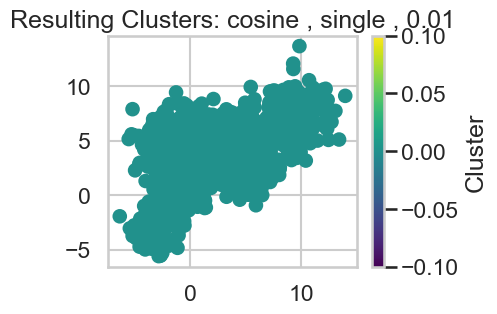

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


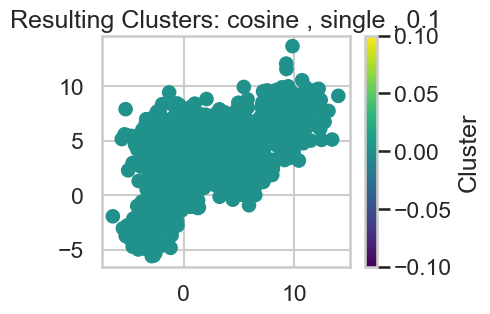

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


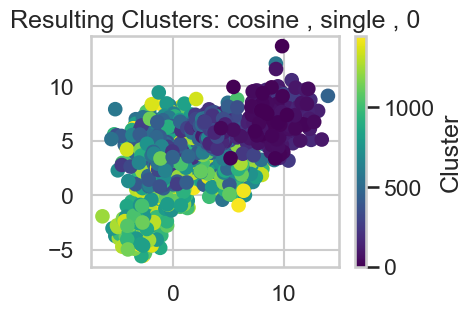

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


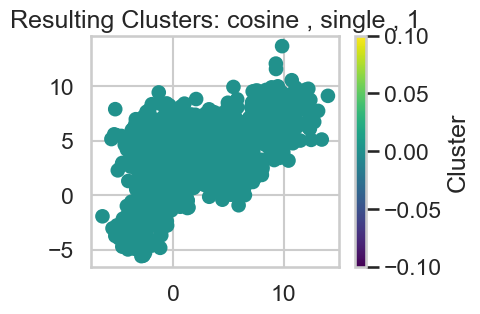

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


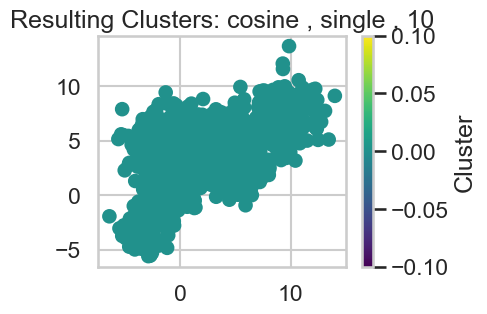

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


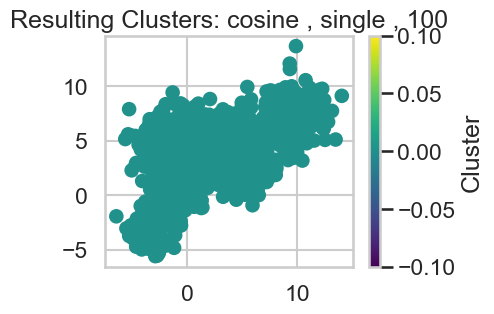

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


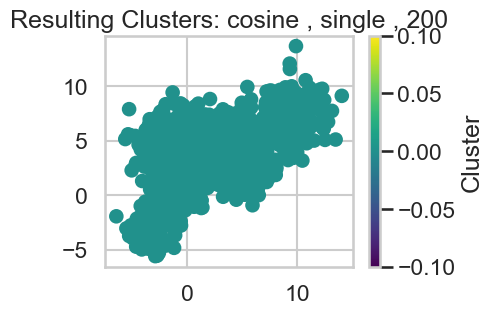

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


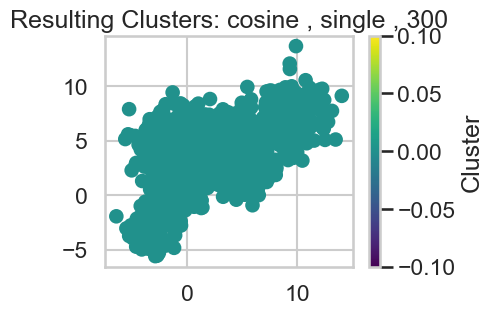

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


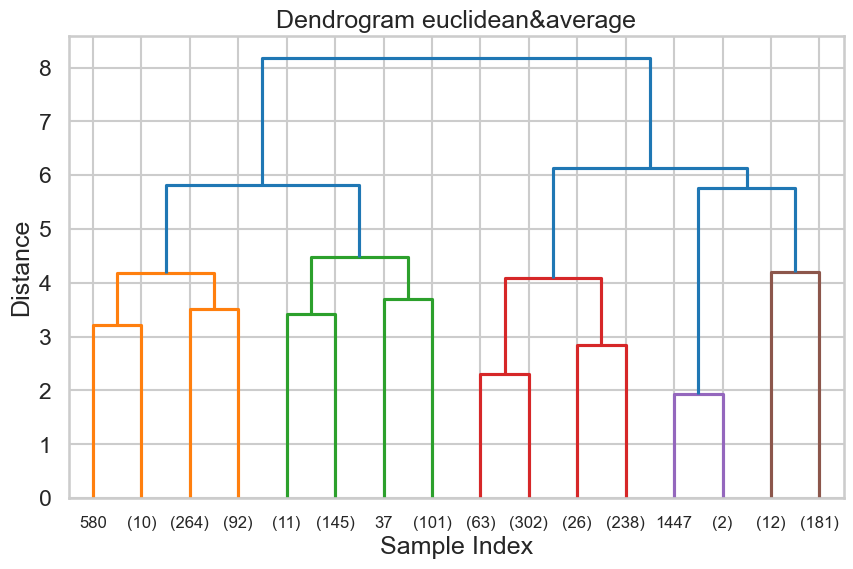

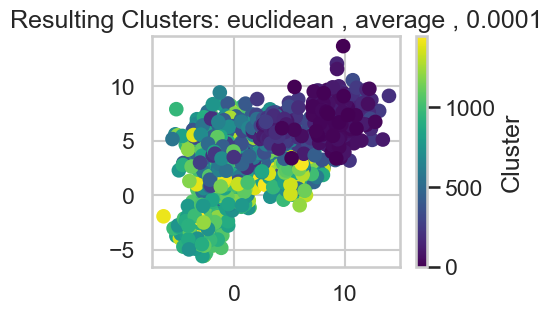

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


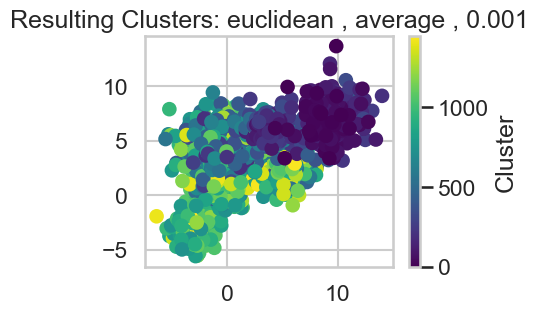

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


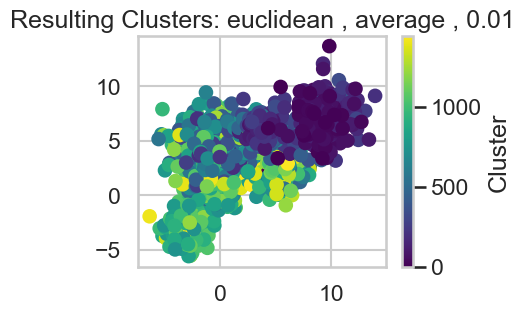

Silhouette Score: 0.004954541906625821


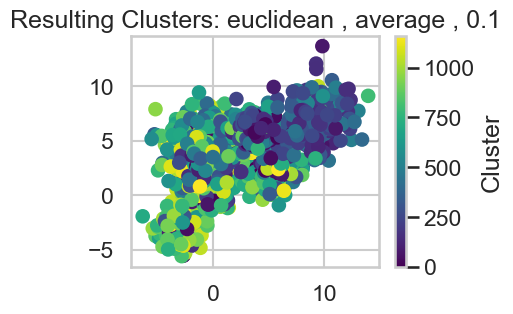

Silhouette Score: 0.18751896464403853


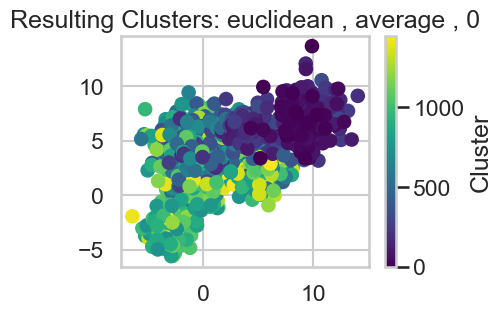

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


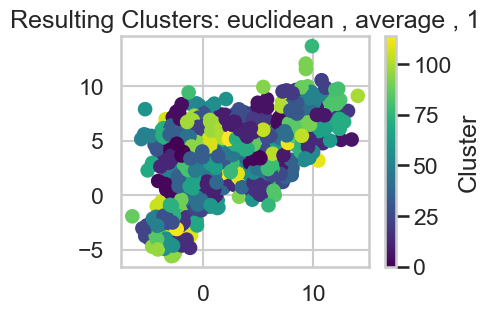

Silhouette Score: 0.32384977908646284


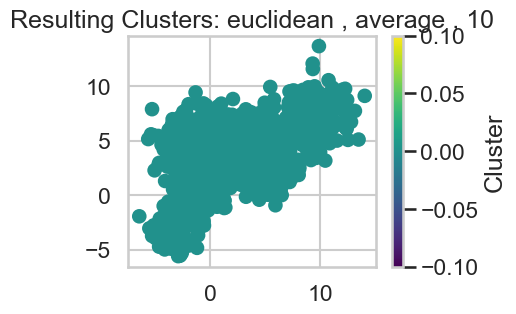

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


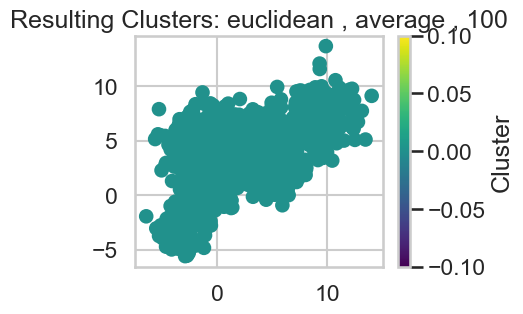

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


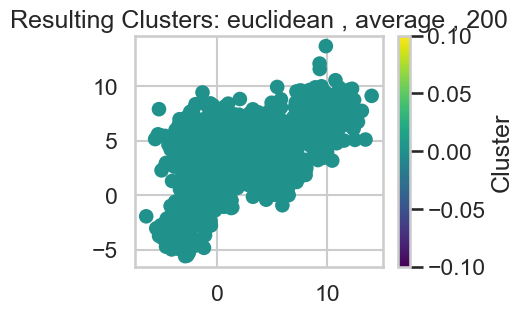

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


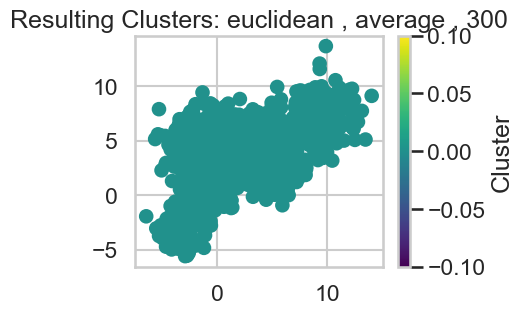

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


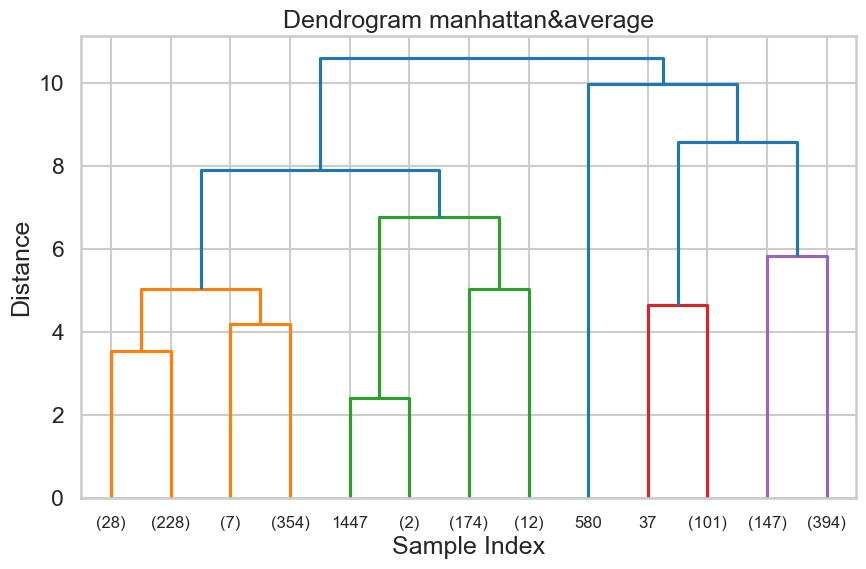

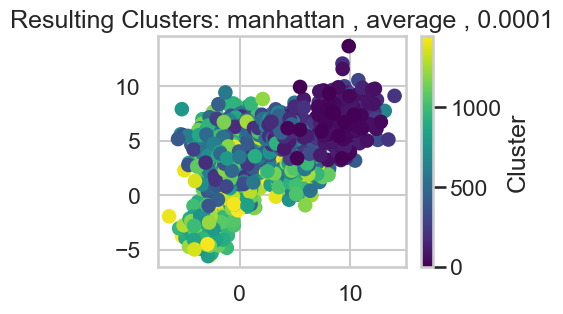

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


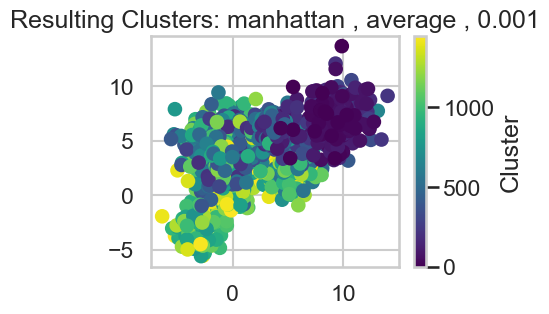

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


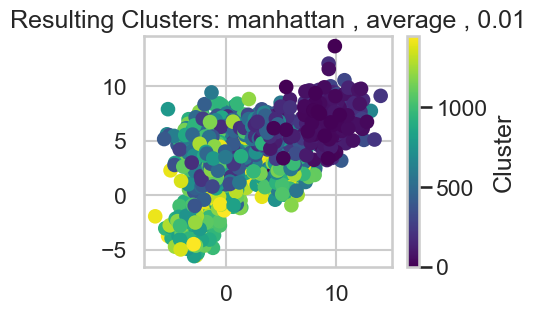

Silhouette Score: 0.002529173589646519


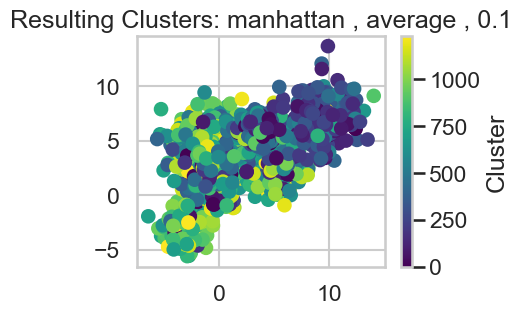

Silhouette Score: 0.15171114923101417


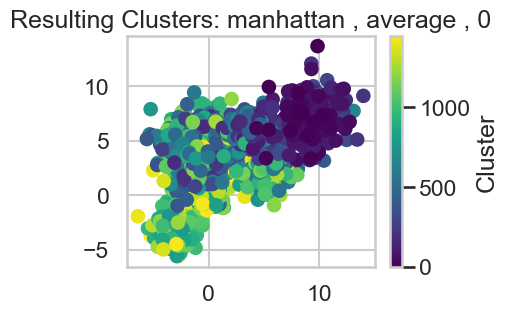

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


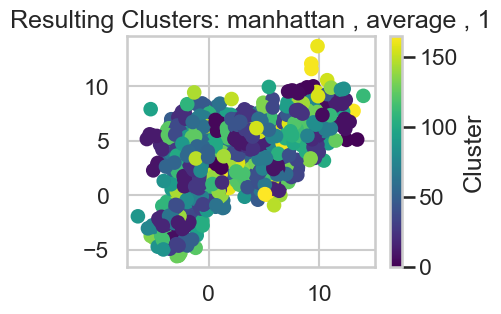

Silhouette Score: 0.34093328073765305


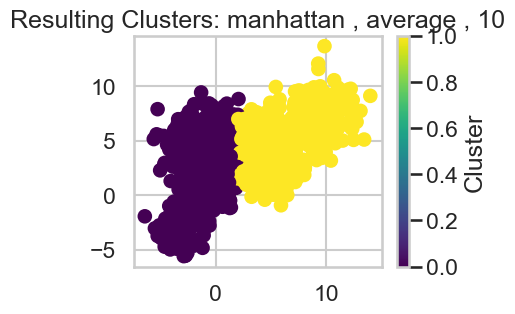

Silhouette Score: 0.46762361386512785


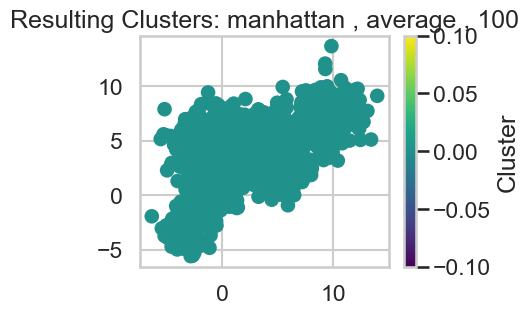

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


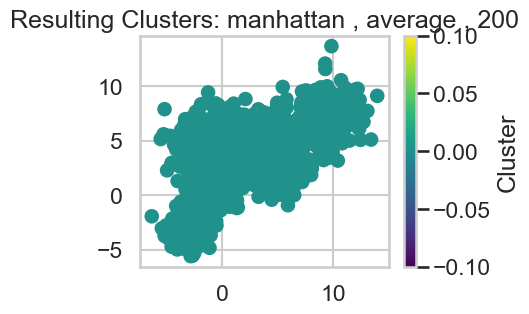

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


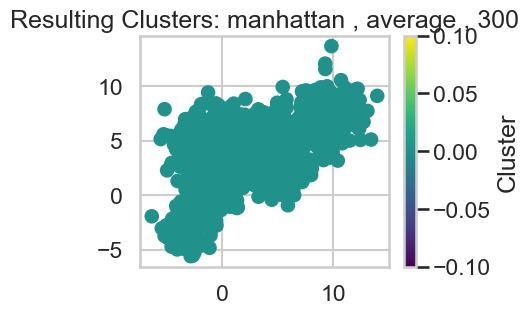

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


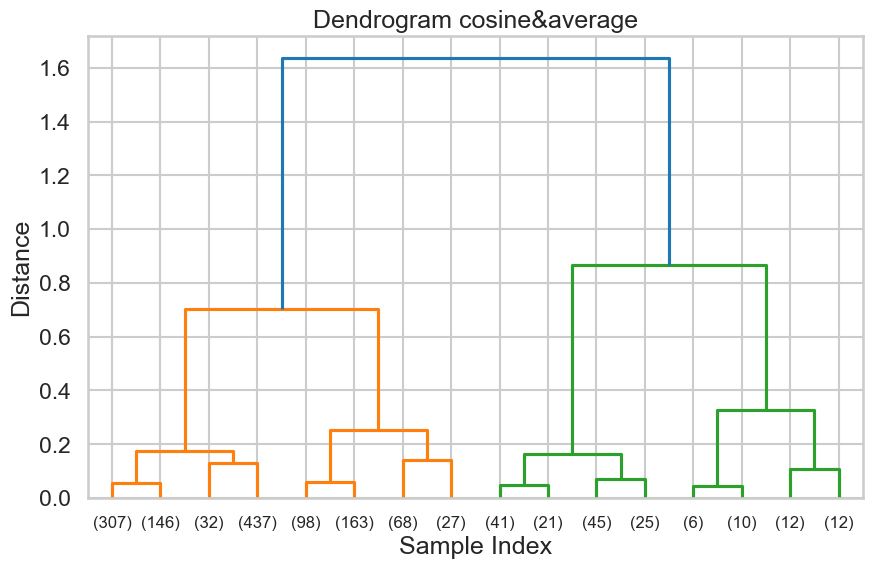

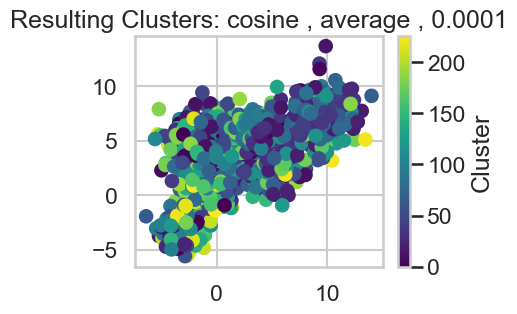

Silhouette Score: -0.35235062118280547


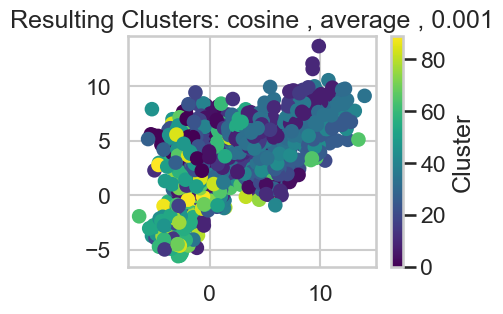

Silhouette Score: -0.18515993669634961


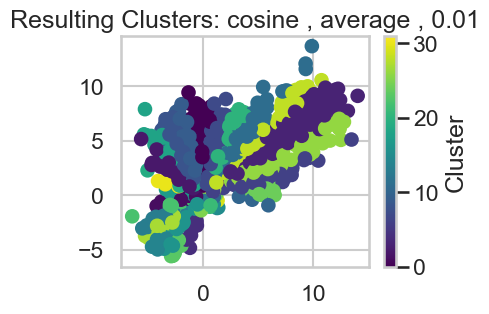

Silhouette Score: -0.030538706841782524


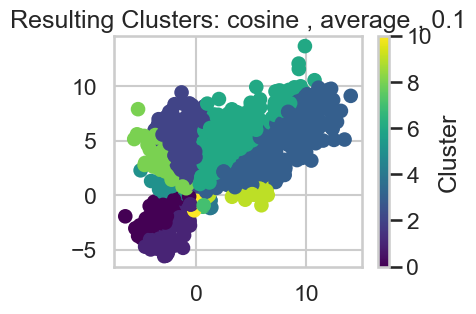

Silhouette Score: 0.12458952872807098


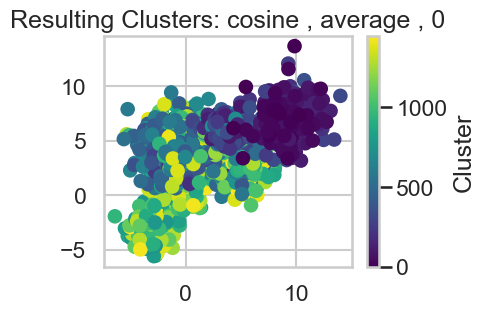

Silhouette score calculation failed: Number of labels is 1450. Valid values are 2 to n_samples - 1 (inclusive)


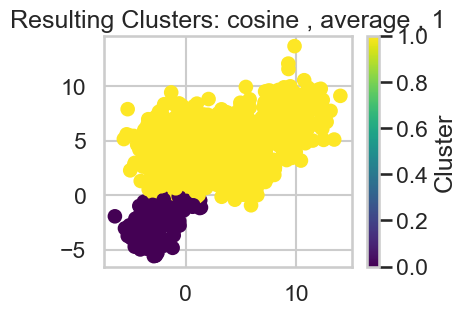

Silhouette Score: 0.35251834131557364


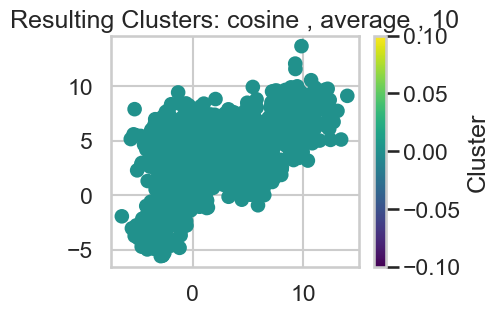

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


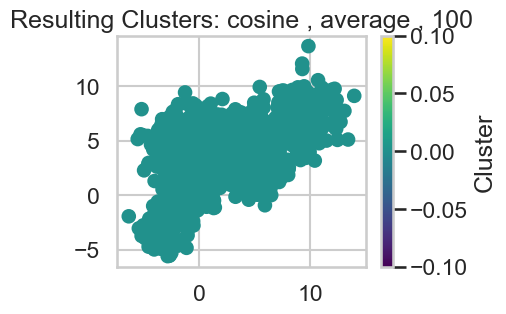

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


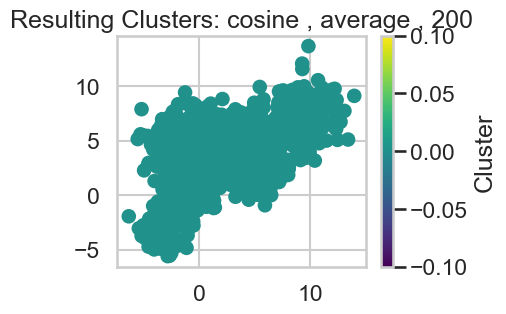

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


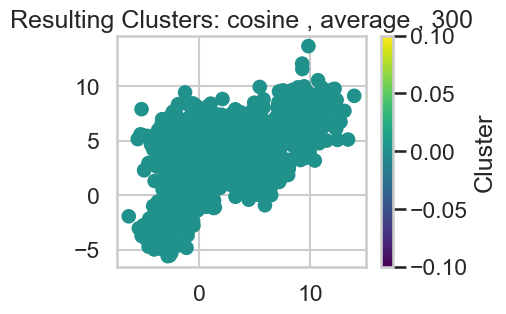

Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Best Parameters: {'affinity': 'manhattan', 'linkage': 'average', 'distance_threshold': 10}
Best Silhouette Score: 0.46762361386512785
[0.48614459735646176, 0.46762361386512785]


In [24]:
for Linkage in Linkages:
    for Affinity in Affinities:
        #Plotting the dendogram
        Affinity2=Affinity
        if (Affinity=="manhattan"):
            #cityblock metric corresponds to manhattan in linkage function
            Affinity2="cityblock"
        
        #Plotting the Dendogram
        Z = linkage(Multi_blob_Data, method=Linkage,metric=Affinity2)
        plt.figure(figsize=(10, 6))
        plt.title(f'Dendrogram {Affinity}&{Linkage}')
        dendrogram(Z, truncate_mode='level', p=3)
        plt.xlabel('Sample Index')
        plt.ylabel('Distance')
        plt.show()
        for Distance_Threshold in Distance_thresholds:
            # Perform Hierarchical Clustering
            model = AgglomerativeClustering(n_clusters=None, affinity=Affinity, linkage=Linkage, distance_threshold=Distance_Threshold)
            model.fit(Multi_blob_Data)
            labels = model.labels_

            # Visualize resulting clusters
            
            plt.figure(figsize=(4,3))
            plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=labels, cmap='viridis')
            plt.title(f'Resulting Clusters: {Affinity} , {Linkage} , {Distance_Threshold}')
            plt.colorbar(label='Cluster')
            plt.show()
            try:
                silhouette = silhouette_score(Multi_blob_Data, labels)
                print(f'Silhouette Score: {silhouette}')
                if silhouette > best_silhouette_H:
                    best_silhouette_H = silhouette
                    best_params['affinity'] = Affinity
                    best_params['linkage'] = Linkage
                    best_params['distance_threshold'] = Distance_Threshold
            except ValueError as e:
                print(f"Silhouette score calculation failed: {e}")


print(f'Best Parameters: {best_params}')
print(f'Best Silhouette Score: {best_silhouette_H}')
Best_Silhouettes.append(best_silhouette_H)
print(Best_Silhouettes)

<h3>Observation On Hierarchal Clustering</h3>
<h5>1) this method , with these parameters, does not ensure a stable number of clusters</h5>
<h5>2) Tuning the distance threshold is very dependent on the other parameters</h5>
<h5>3) This method gave good results for some values, however, it could be better if tuning is with a huge distance threshold array , but this will be very time expensive</h5>

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

In [25]:

# Initialize parameters range
eps_range = np.linspace(0.1, 3, 28)
min_samples_range = np.arange(5, 26)

#best parameters
best_eps = None
best_min_samples = None
best_silhouette_DB = -1
# Initialize lists to store silhouette scores for plotting
silhouette_scores_DB = []

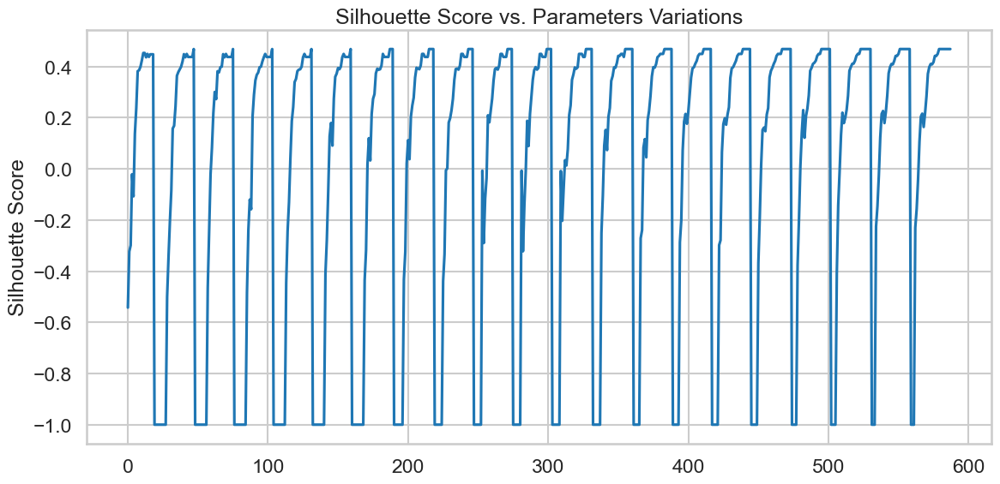

Best Parameters: EPS = 3.0, Min Samples = 25
Best Silhouette Score: 0.4685207355522043
[0.48614459735646176, 0.46762361386512785, 0.4685207355522043]


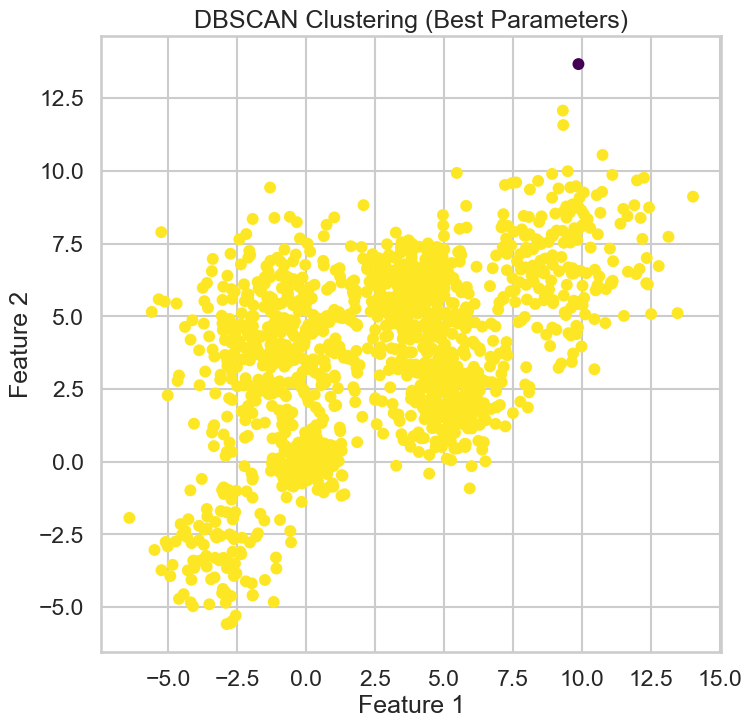

In [26]:

# Iterate over EPS and min_samples values
for min_samples in min_samples_range:
    for eps in eps_range:
        # Perform DBSCAN clustering
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        labels = dbscan.fit_predict(Multi_blob_Data)
        
        
        # Check if DBSCAN formed more than one cluster
        if len(np.unique(labels)) > 1:
            # Compute silhouette score
            silhouette = silhouette_score(Multi_blob_Data, labels)
            
            # Check if current silhouette score is better than the previous best
            if silhouette >= best_silhouette_DB:
                best_eps = eps
                best_min_samples = min_samples
                best_silhouette_DB = silhouette
        else:
            silhouette=-1
        silhouette_scores_DB.append(silhouette)


# Plot silhouette score versus variations in EPS and min_samples
plt.figure(figsize=(12, 6))
plt.plot(silhouette_scores_DB, linestyle='-')
plt.title('Silhouette Score vs. Parameters Variations')
plt.ylabel('Silhouette Score')
plt.tight_layout()
plt.show()

print(f"Best Parameters: EPS = {best_eps}, Min Samples = {best_min_samples}")
print(f"Best Silhouette Score: {best_silhouette_DB}")
Best_Silhouettes.append(best_silhouette_DB)
print(Best_Silhouettes)

# Perform DBSCAN clustering with best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_clusters = best_dbscan.fit_predict(Multi_blob_Data)

# Plot resulting clusters
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=best_clusters, cmap='viridis', marker='o', s=50)
plt.title('DBSCAN Clustering (Best Parameters)')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()


Eps value is more affecting the results  

silouhette value is not rhe best metric to evaluate DBScan, because DBScan clusters the datapoints into cores,borders and noises. which makes the cluster centers are not distinct to each others , so a point may be not likely to belong to its cluster when calculating the silhouette value.  

The resultant best clustering is making all the points in one cluster and one noise point, this gave a good silhouette however its apparently a bad clustering.  

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

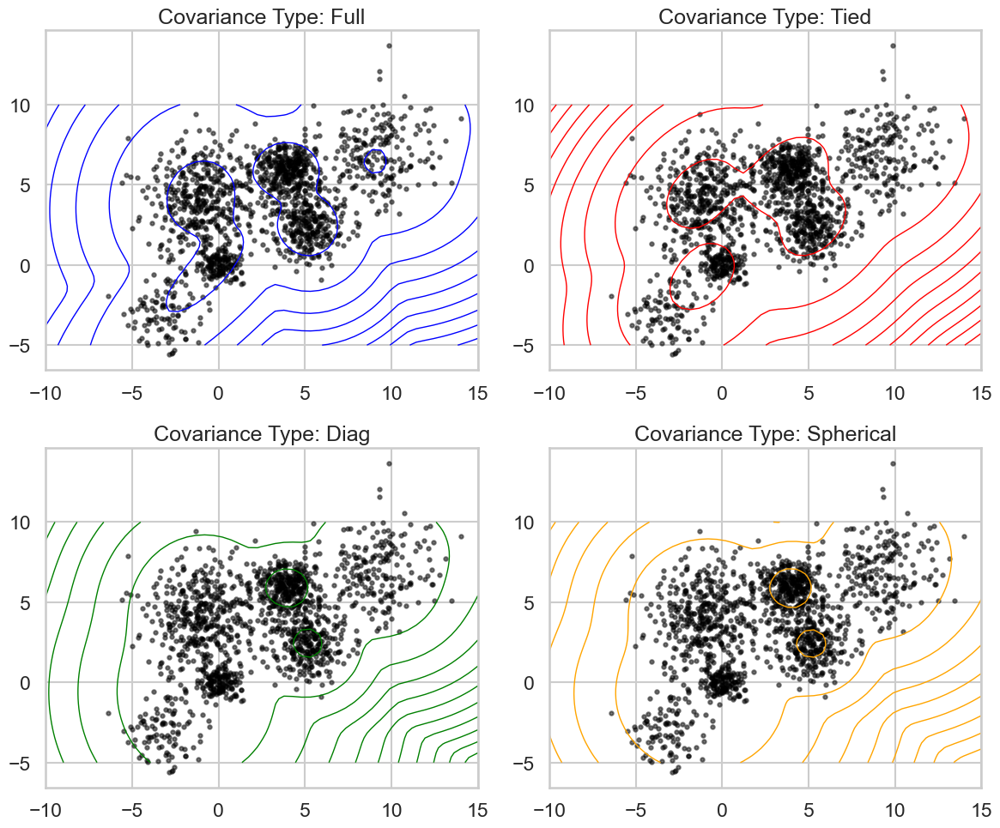

In [27]:
# Initialize covariance types
covariance_types = ['full', 'tied', 'diag', 'spherical']

# Plot colors
colors = ['blue', 'red', 'green', 'orange']

# Initialize subplot grid
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Iterate over covariance types
for i, cov_type in enumerate(covariance_types):
    # Fit GMM
    gmm = GaussianMixture(n_components=6, covariance_type=cov_type, random_state=42)
    gmm.fit(Multi_blob_Data)
    
    # Plot contours
    x = np.linspace(-10, 15)
    y = np.linspace(-5, 10)
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    
    ax = axes[i // 2, i % 2]
    ax.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], color='black', s=10, marker='o', alpha=0.5)
    ax.contour(X, Y, Z, levels=10, linewidths=1, colors=colors[i])
    ax.set_title(f'Covariance Type: {cov_type.capitalize()}')

plt.tight_layout()
plt.show()

## Note:
for the previous dataset, I implemented the code implicitly, without implementing functions and then using it, But for the upcoming code ,I made functions to avoid code redundancy.

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [28]:
from sklearn.datasets import load_iris
iris_data = load_iris()
Iris_Data=iris_data.data
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']

# print(Iris_Data.shape[1])
# print(Iris_Data[:,0])
# labels=np.zeros(Iris_Data.shape[0])
# labels[2]=1
# print(Iris_Data[labels==1,0])
# print(labels.max())
# for i in range(int(labels.max())+1):
#     print("lol")





['setosa', 'versicolor', 'virginica']

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

In [29]:

#Display function to be used for plotting every points every two possible features of the datasets

def display(data,labels,str=""):
    fig, axs = plt.subplots(data.shape[1], data.shape[1],figsize=(20,30))
    color = ['blue', 'red', 'green', 'cyan', 'magenta', 'yellow', 'black', 'orange', 'purple', 'brown']
    for i in range(data.shape[1]):
        for j in range(data.shape[1]):
            for m in range(int(labels.max())+1):
                x=data[labels==m,i]
                y=data[labels==m,j]
                axs[i,j].scatter(x,y,color=color[m])
                axs[i,j].set_xlabel(f'Feature {i}')
                axs[i,j].set_ylabel(f'Feature {j}')
                axs[i,j].set_title(str)



In [3]:
Best_Silhouettes=[]    #store the best Silhouette for every Clustering Approach to compare between them

<h3>K_Mean for Iris dataset</h3>

In [30]:
def my_K_mean(data):
    # Define a range of k values
    k_values = range(2, 11)
    distortions = []  # Store distortion value for each K
    silhouette_scores_Kmean = []  # Store silhouette score for each K

    # Loop through each k value
    for k in k_values:
        # KMeans Clustering
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        labels=kmeans.labels_
        # print(k,"  clusters")
        display(data,labels,f'{k} clusters')
    
        # Storing Distortion value for this number of clusters
        distortions.append(kmeans.inertia_)  
        #storing silhouette values
        silhouette_scores_Kmean.append(silhouette_score(data , kmeans.labels_,metric = 'euclidean'))



    #ploting distortion
    plt.figure(figsize=(7,7))
    plt.plot(k_values, distortions, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Distortion')
    plt.title('Distortion')
    plt.show()

    # Plotting silhouette score versus K
    plt.figure(figsize=(7, 7))
    plt.plot(k_values, silhouette_scores_Kmean, marker='o')
    plt.title('Silhouette Score versus K')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('Silhouette Score')
    plt.xticks(k_values)
    plt.show()

    # Choose the best K based on silhouette score
    best_k = k_values[silhouette_scores_Kmean.index(max(silhouette_scores_Kmean))]
    best_silhouette_value=max(silhouette_scores_Kmean)
    print(f'Best K based on silhouette score: {best_k} , Best Value: {best_silhouette_value}')
    Best_Silhouettes.append(best_silhouette_value)
    print(Best_Silhouettes)

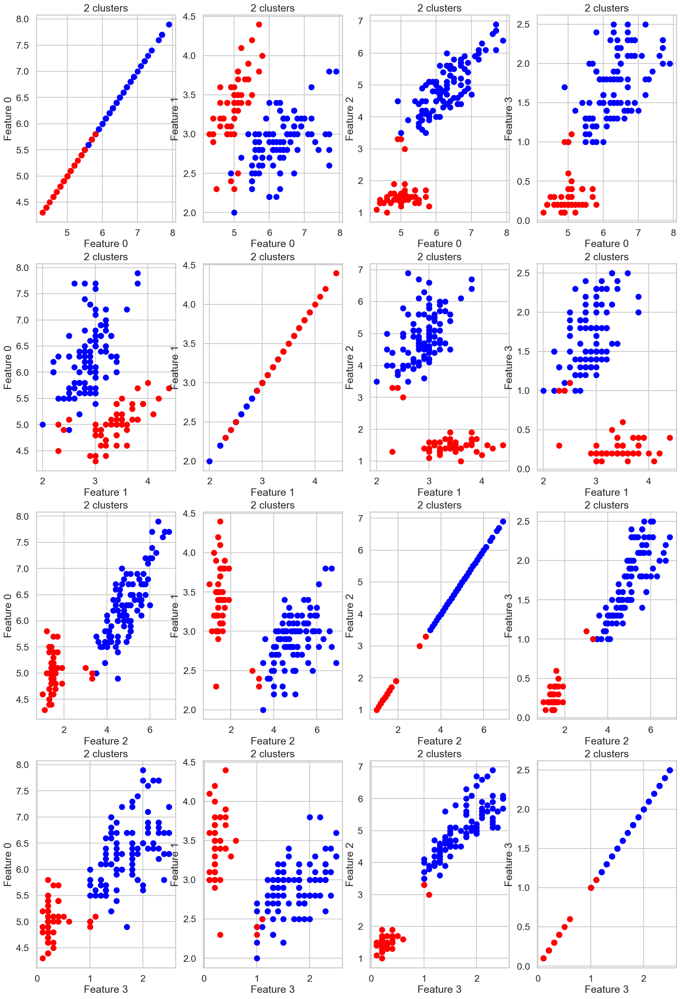

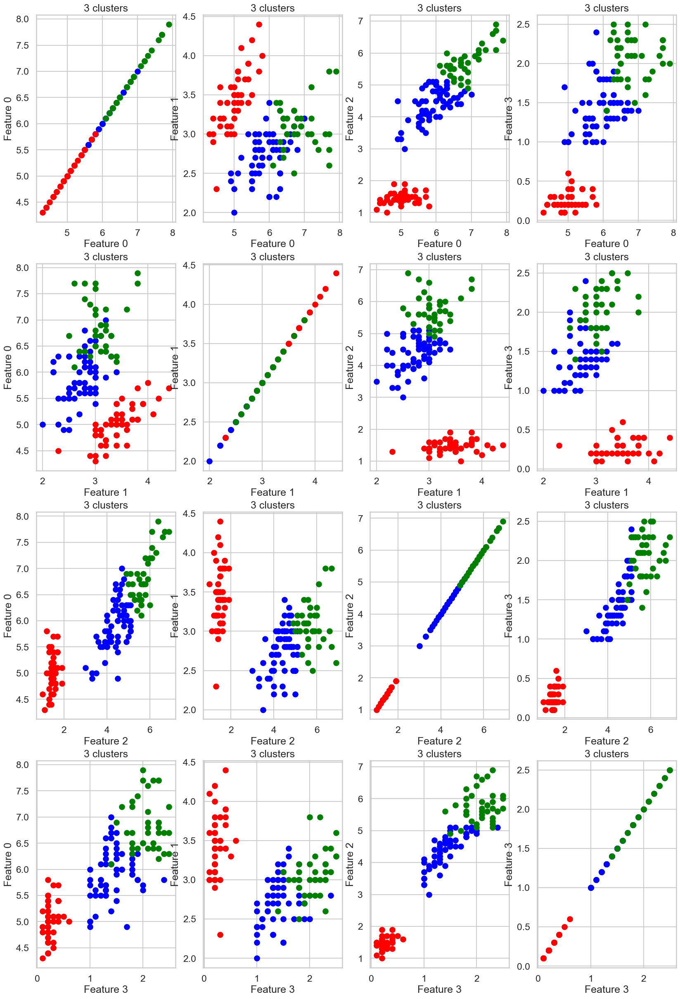

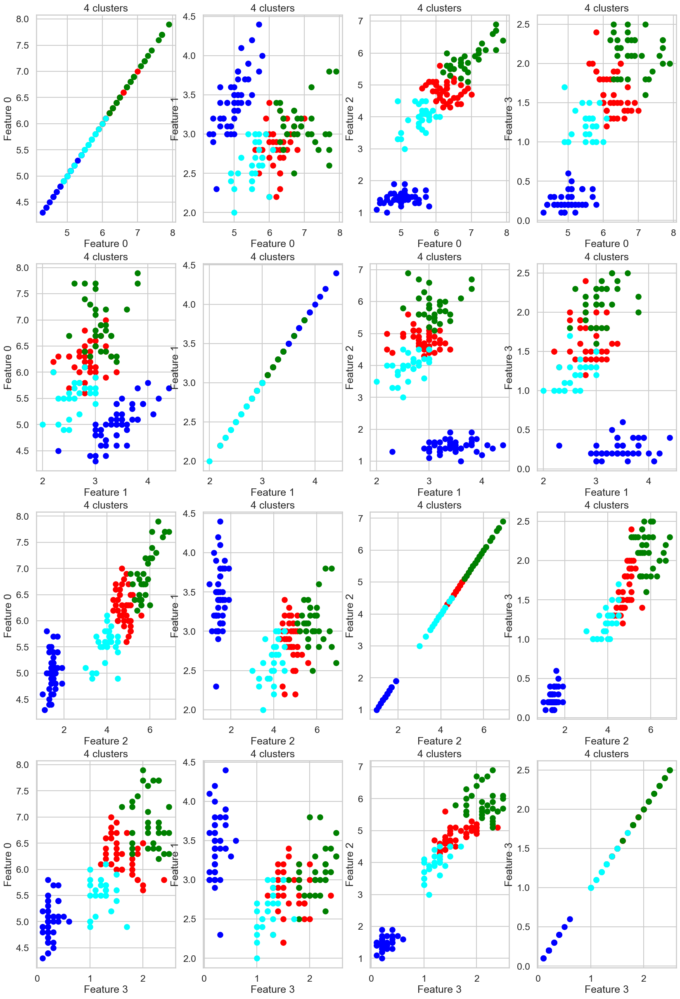

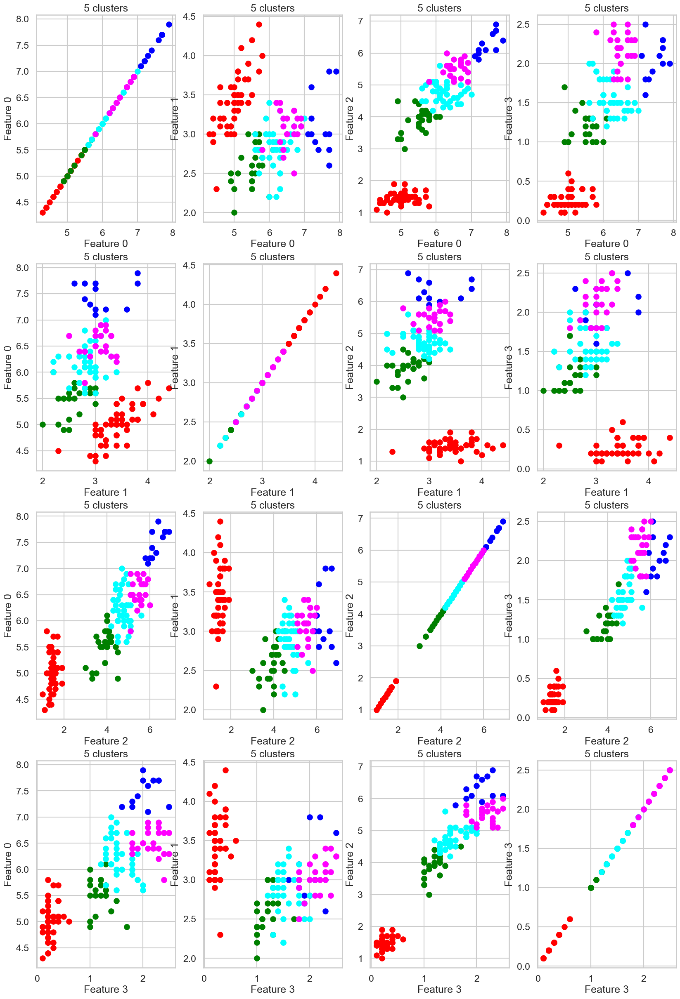

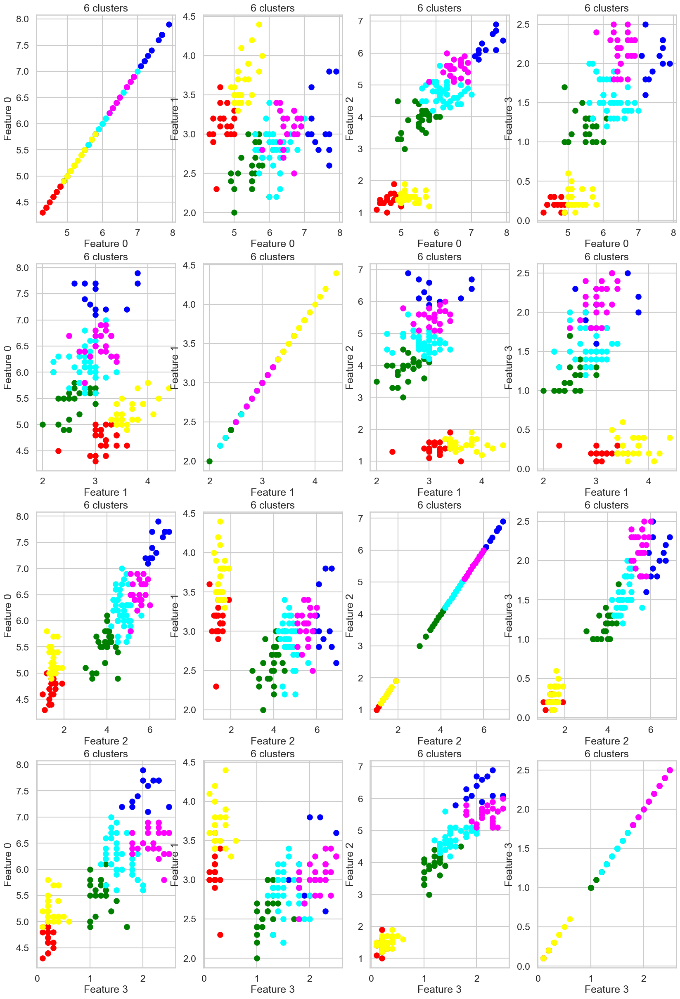

...

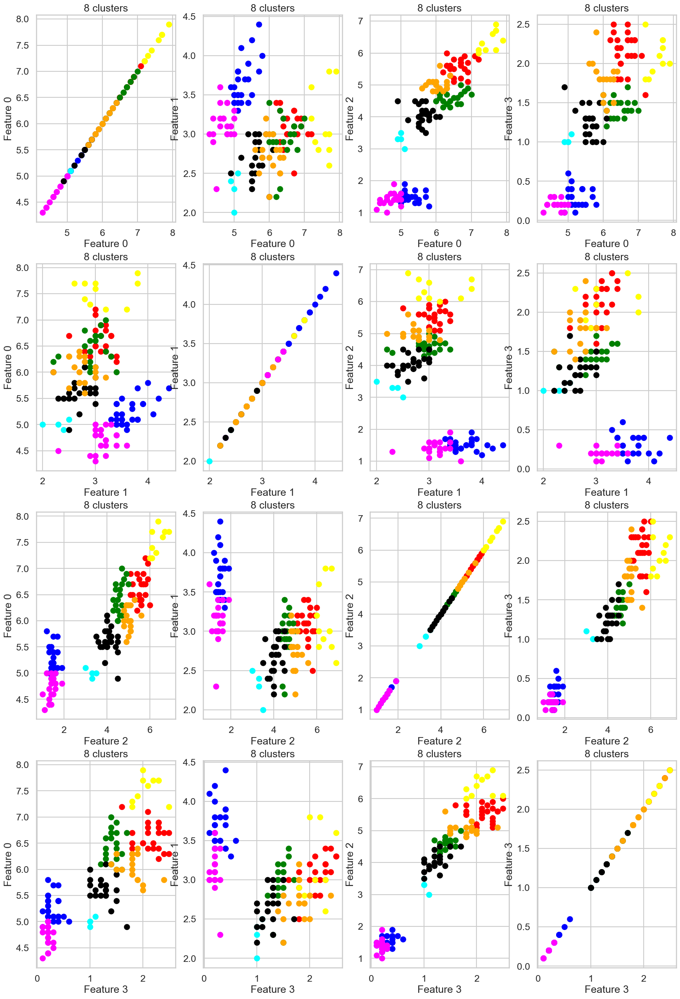

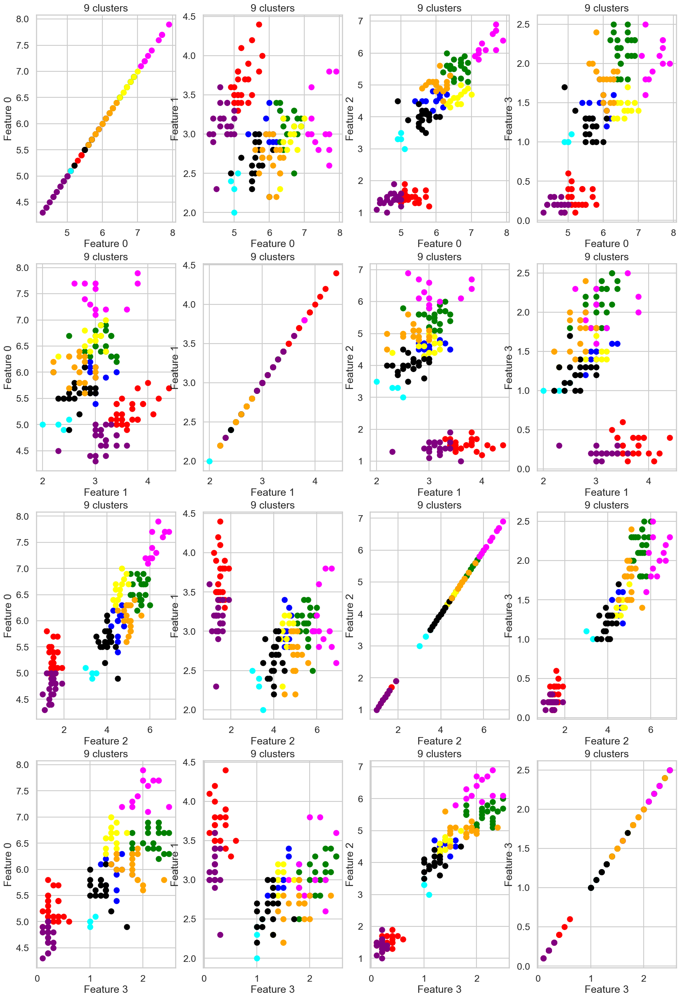

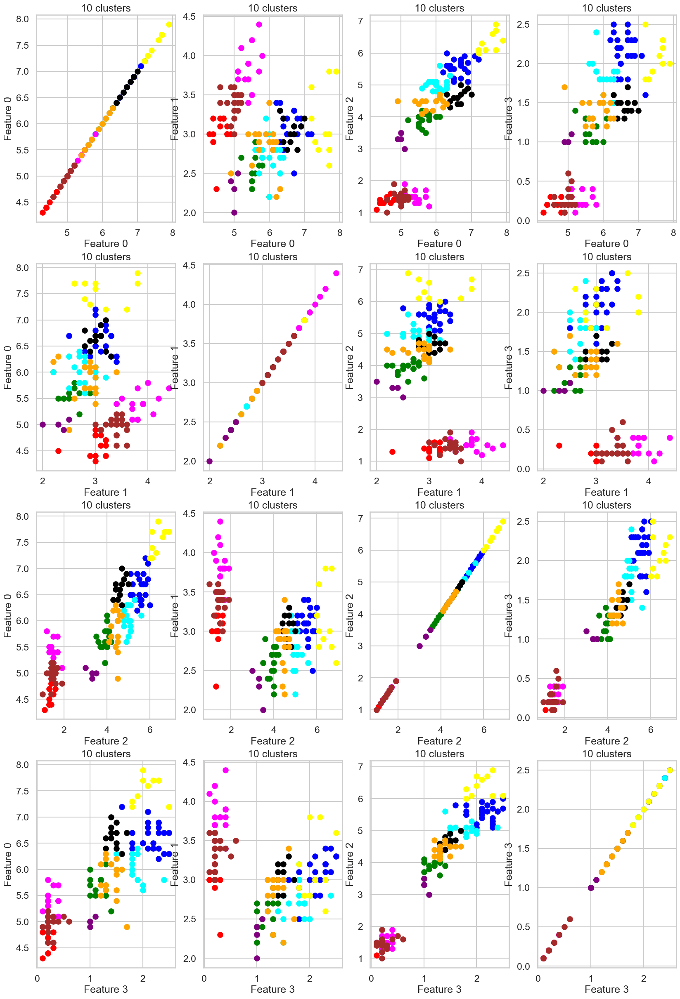

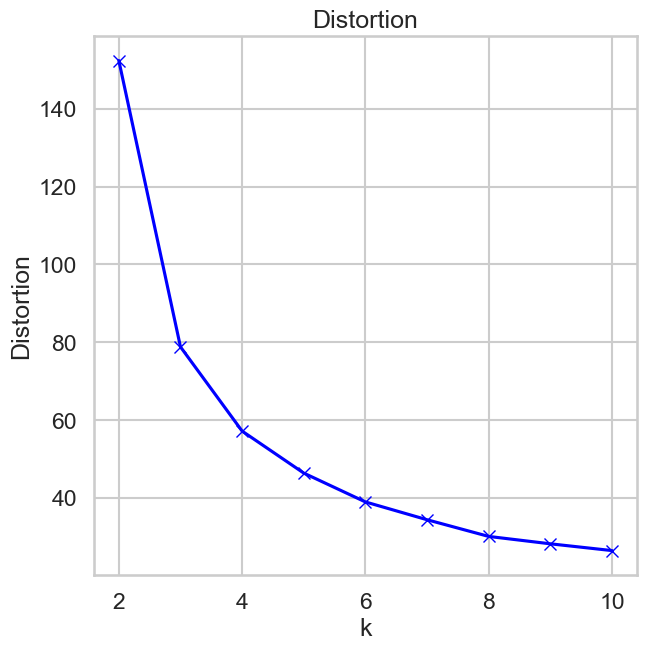

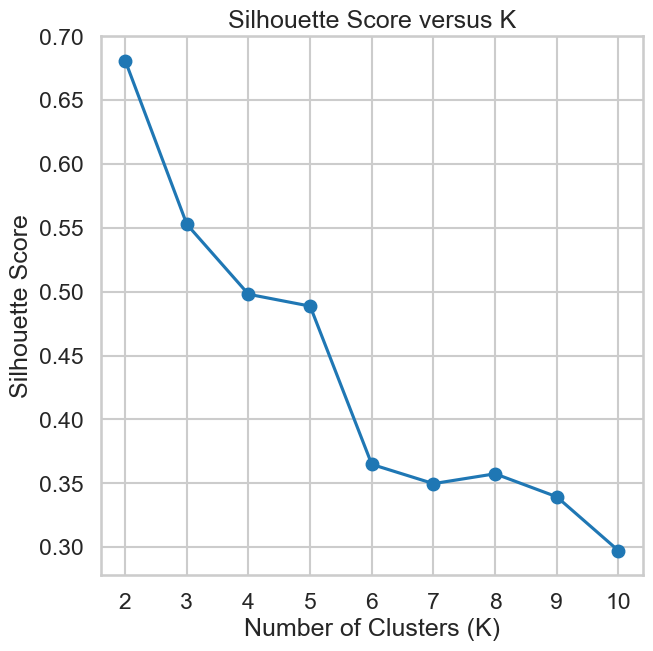

Best K based on silhouette score: 2 , Best Value: 0.6810461692117462
[0.48614459735646176, 0.46762361386512785, 0.4685207355522043, 0.6810461692117462]


In [31]:
my_K_mean(Iris_Data)

## Hierarchal 

In [32]:
def Heierarchal(data):
    Linkages=["single","average"]
    Affinities=["euclidean","manhattan","cosine"]
    Distance_thresholds=[0.0001,0.001,0.01,0.1,0,1,10,100,200,300]

    # Initialize variables to store best parameters and silhouette score
    best_params = {'affinity': None, 'linkage': None, 'distance_threshold': None}
    best_silhouette_H = float('-inf')       

    for Linkage in Linkages:
        for Affinity in Affinities:
            Affinity2=Affinity
            if (Affinity=="manhattan"):
                #cityblock metric corresponds to manhattan in linkage function
                Affinity2="cityblock"
        
            #Plotting the Dendogram
            Z = linkage(data, method=Linkage,metric=Affinity2)
            plt.figure(figsize=(10, 6))
            plt.title(f'Dendrogram {Affinity}&{Linkage}')
            dendrogram(Z, truncate_mode='level', p=3)
            plt.xlabel('Sample Index')
            plt.ylabel('Distance')
            plt.show()
            for Distance_Threshold in Distance_thresholds:
                # Perform Hierarchical Clustering
                model = AgglomerativeClustering(n_clusters=None, affinity=Affinity, linkage=Linkage, distance_threshold=Distance_Threshold)
                model.fit(data)
                labels = model.labels_

            
                try:
                    silhouette = silhouette_score(data, labels)
                    # Visualize resulting clusters: only successful clusterings
                    fig, axs = plt.subplots(data.shape[1], data.shape[1],figsize=(20,30))
                    for i in range(data.shape[1]):
                        for j in range(data.shape[1]):
                            x=data[:,i]
                            y=data[:,j]
                            axs[i,j].scatter(x,y,c=labels, cmap='viridis')
                            axs[i,j].set_xlabel(f'Feature {i}')
                            axs[i,j].set_ylabel(f'Feature {j}')
                            axs[i,j].set_title(f' {Affinity} , {Linkage} , {Distance_Threshold}')
                        
                    print(f'Silhouette Score: {silhouette}')
                    if silhouette > best_silhouette_H:
                        best_silhouette_H = silhouette
                        best_params['affinity'] = Affinity
                        best_params['linkage'] = Linkage
                        best_params['distance_threshold'] = Distance_Threshold
                except ValueError as e:
                    print(f"Silhouette score calculation failed: {e}")


    print(f'Best Parameters: {best_params}')
    print(f'Best Silhouette Score: {best_silhouette_H}')
    Best_Silhouettes.append(best_silhouette_H)
    print(Best_Silhouettes)

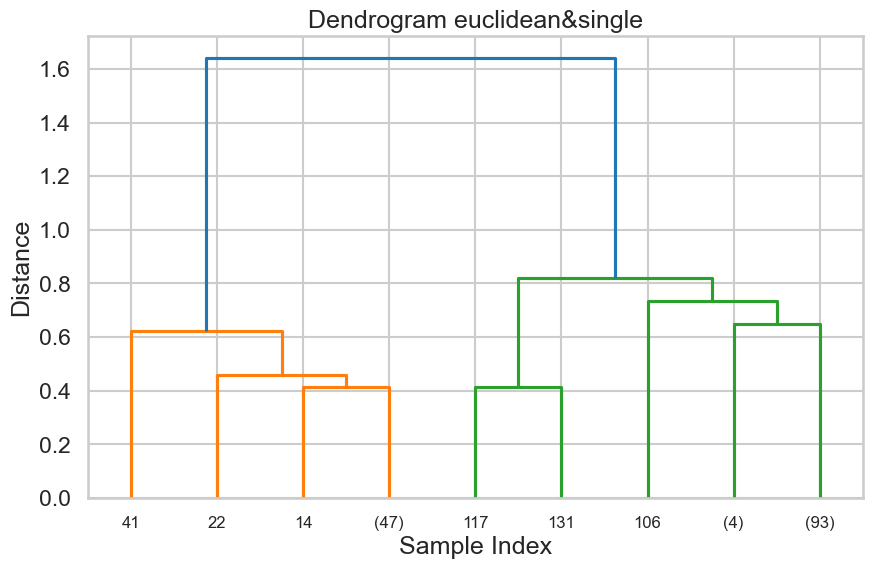

Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.02114381916836208
Silhouette score calculation failed: Number of labels is 150. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette Score: 0.6867350732769777
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


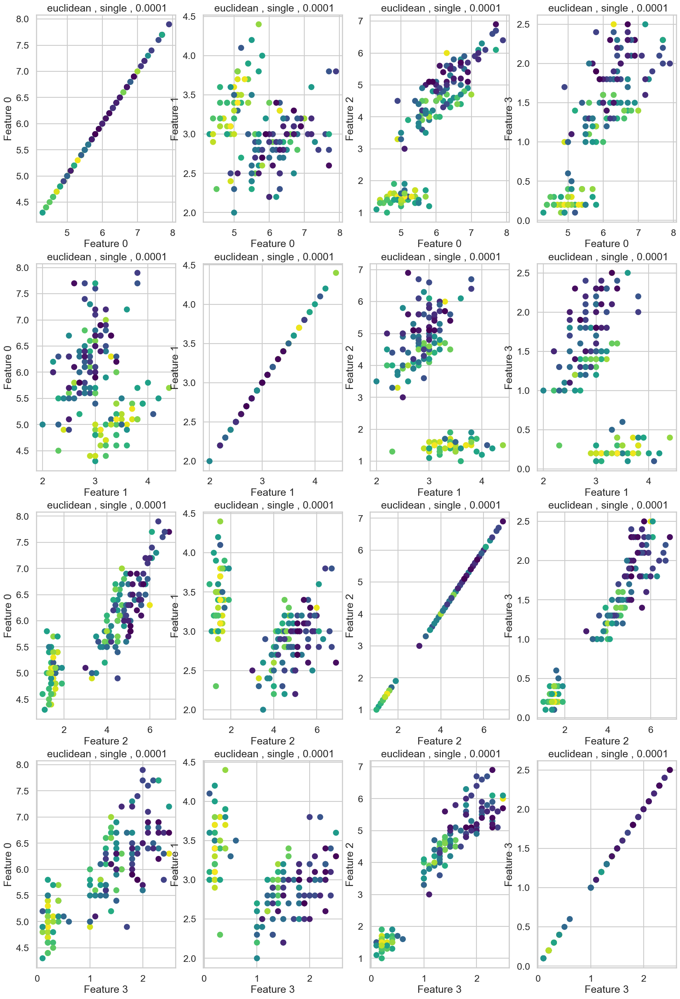

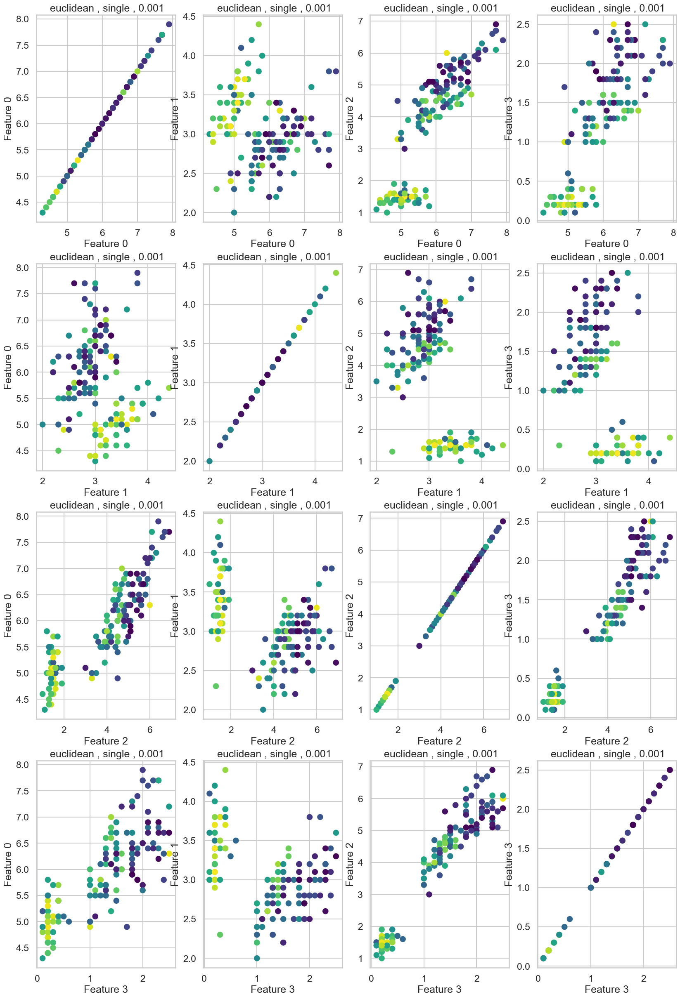

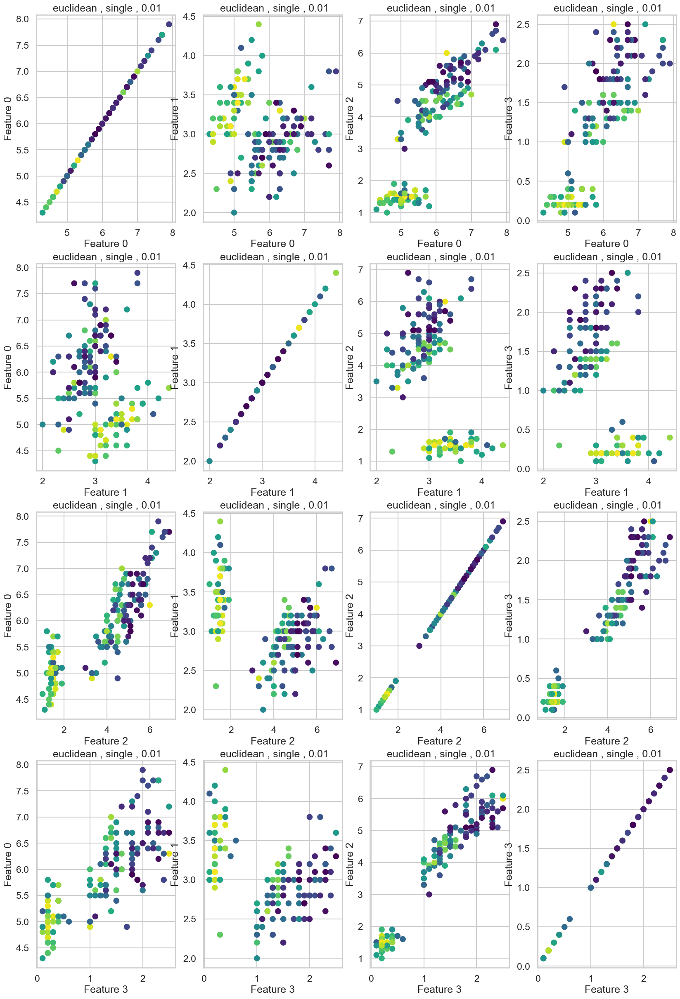

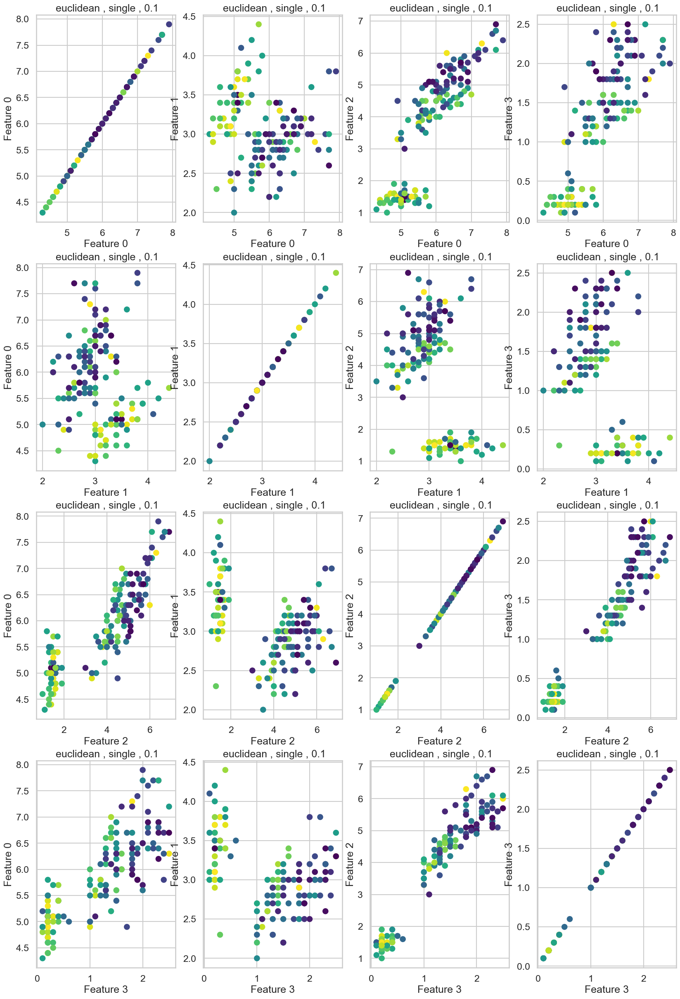

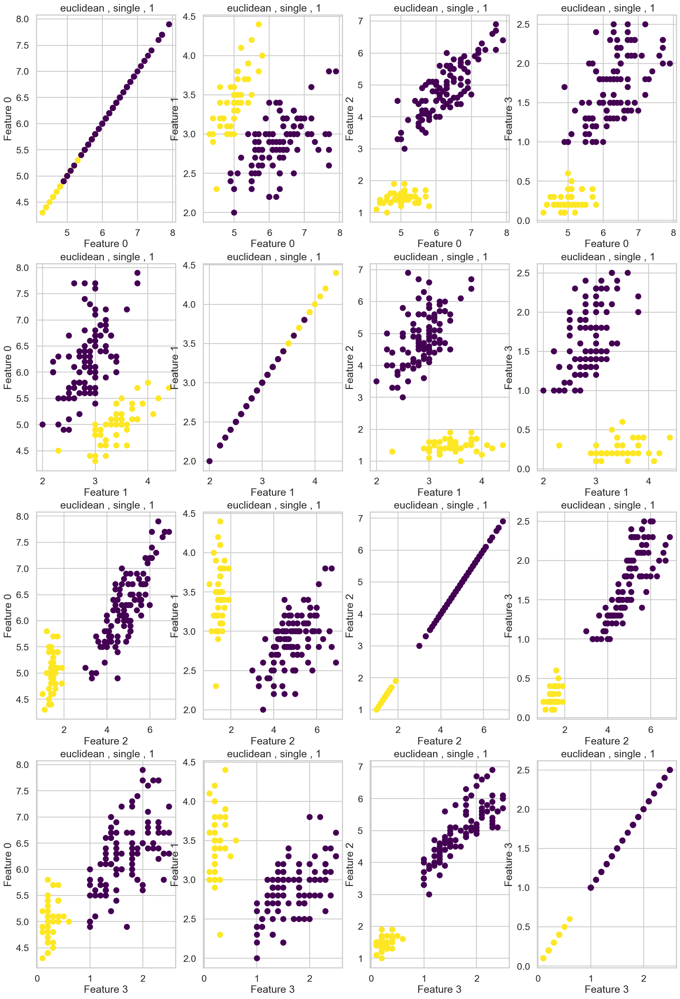

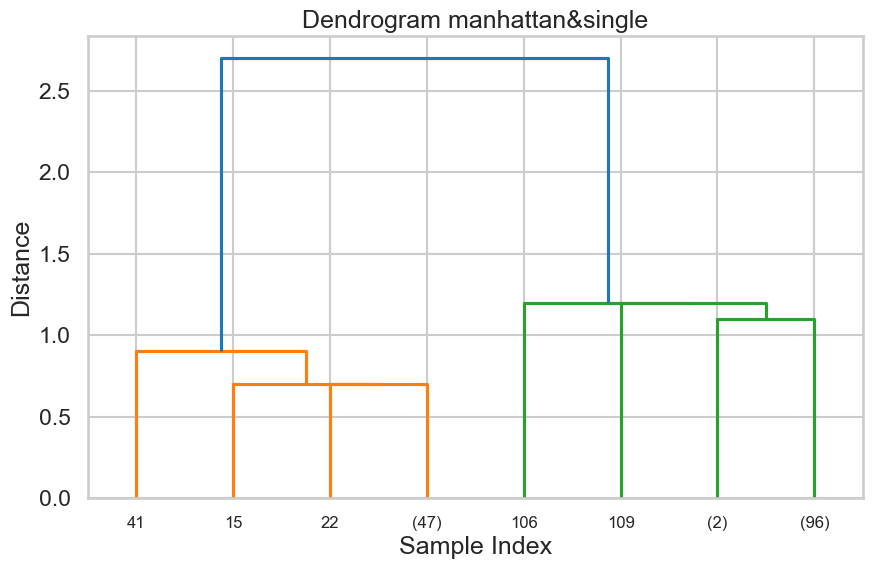

Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.02114381916836208
Silhouette score calculation failed: Number of labels is 150. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette Score: 0.14738244260973818
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


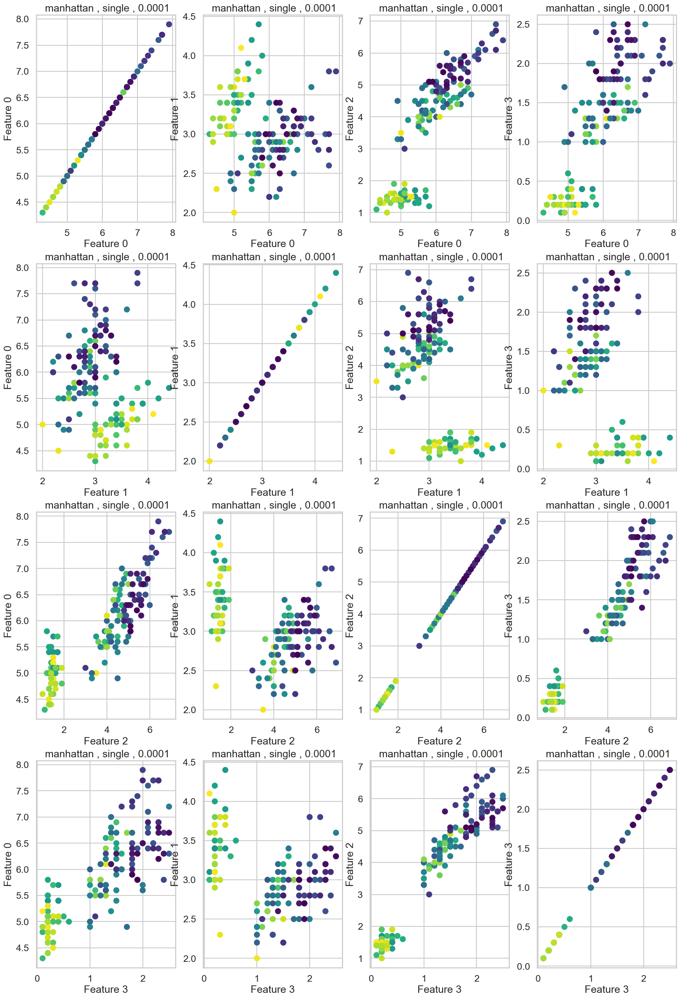

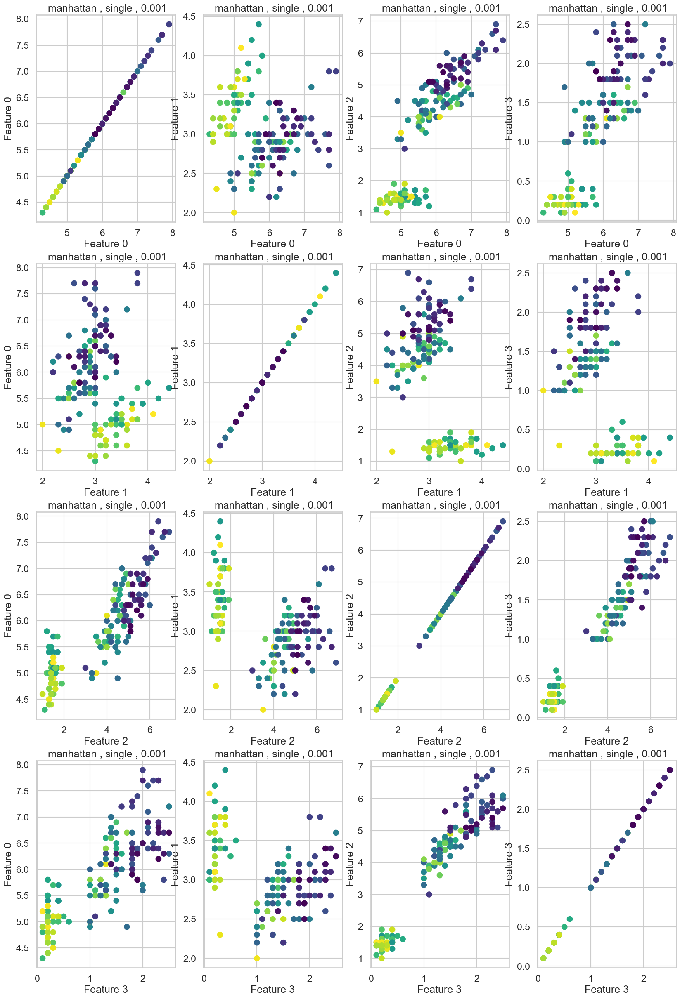

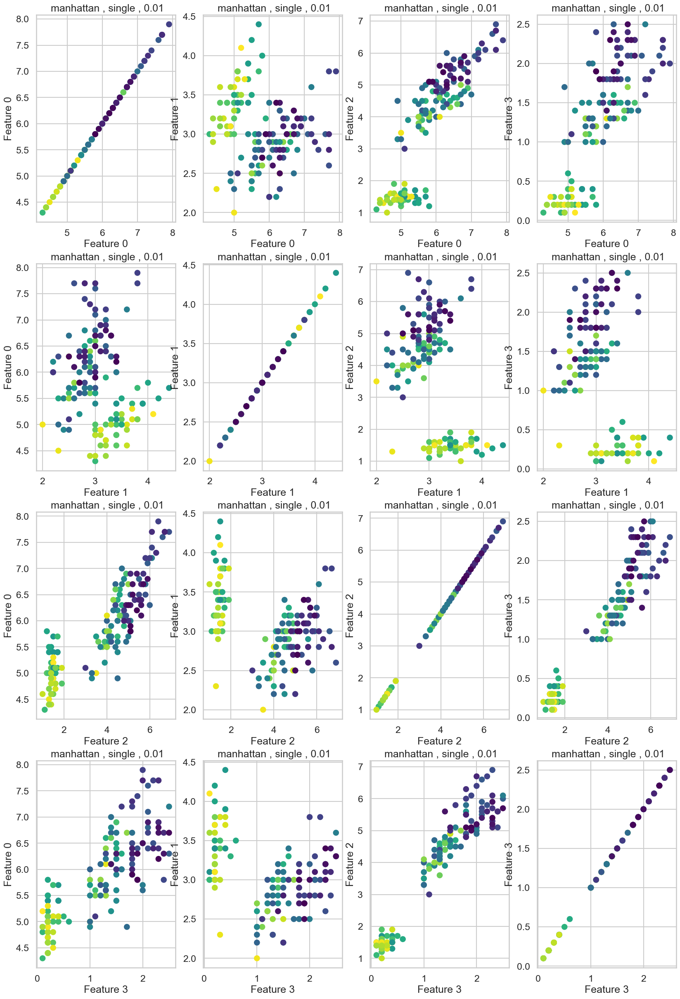

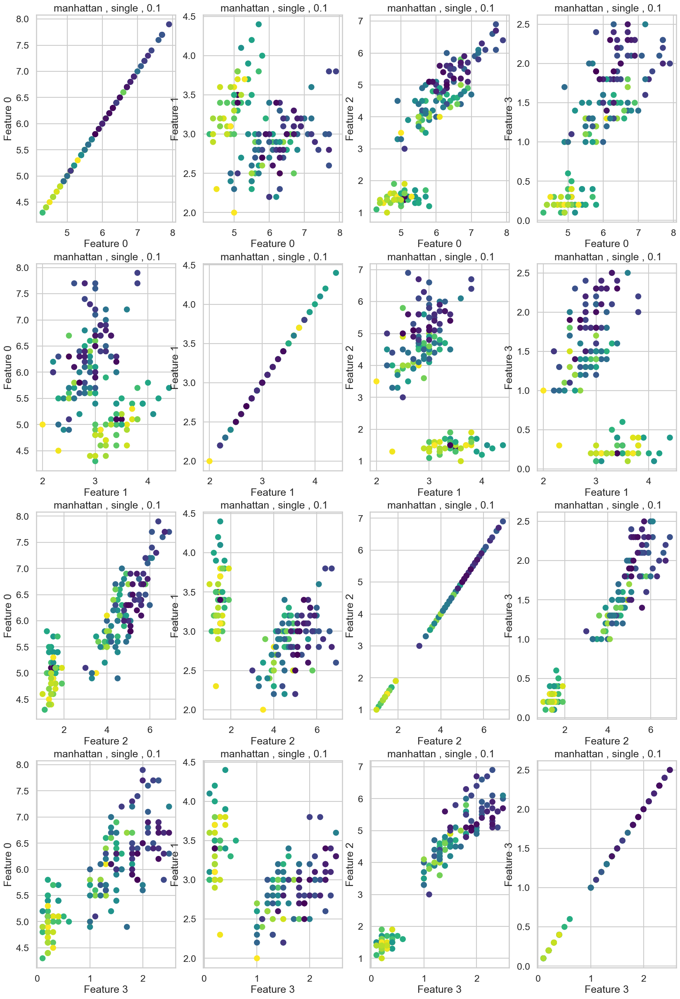

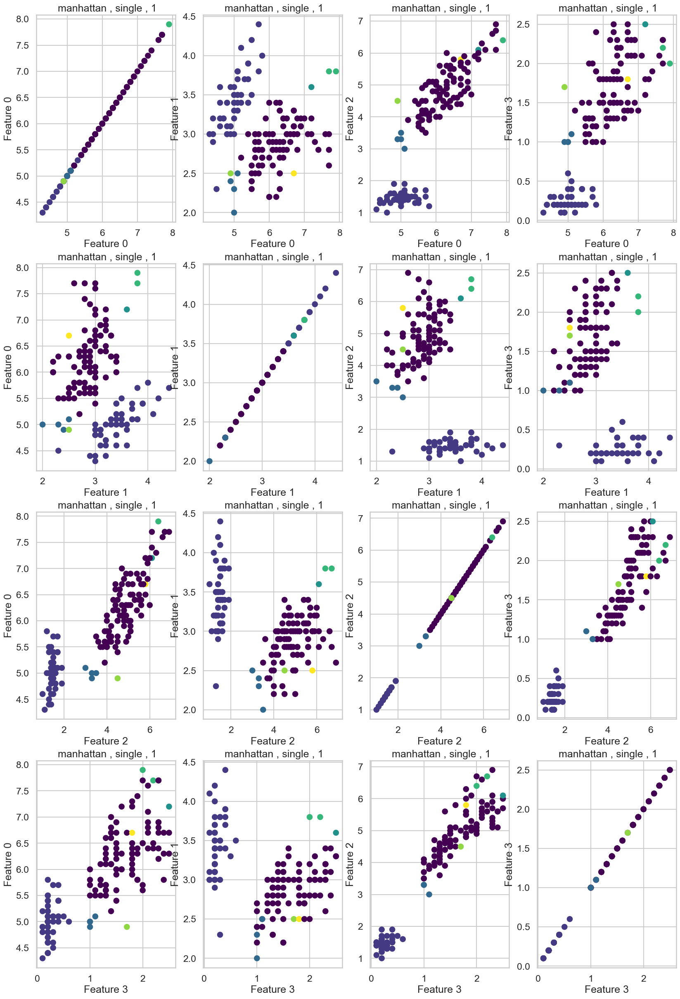

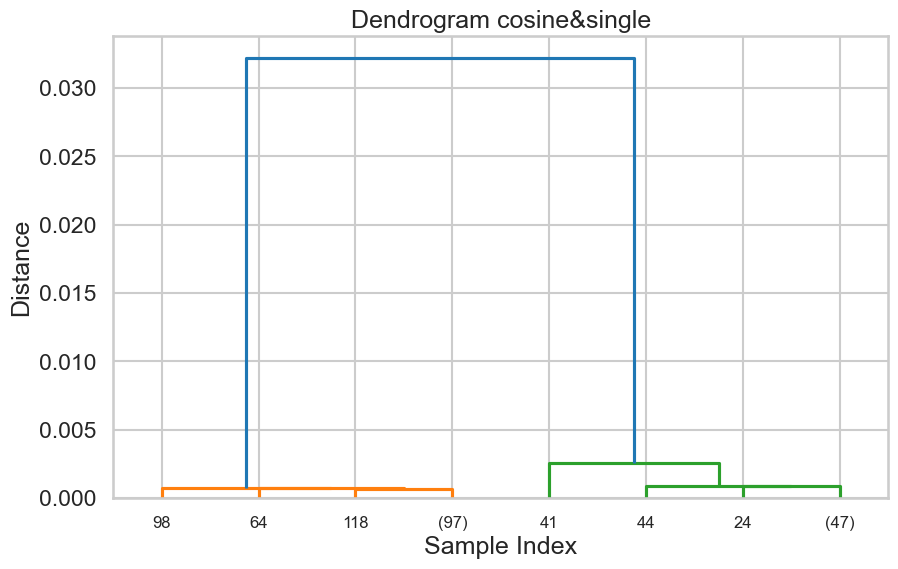

Silhouette Score: -0.29967661324927247
Silhouette Score: 0.5538078922044992
Silhouette Score: 0.6867350732769777
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 150. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


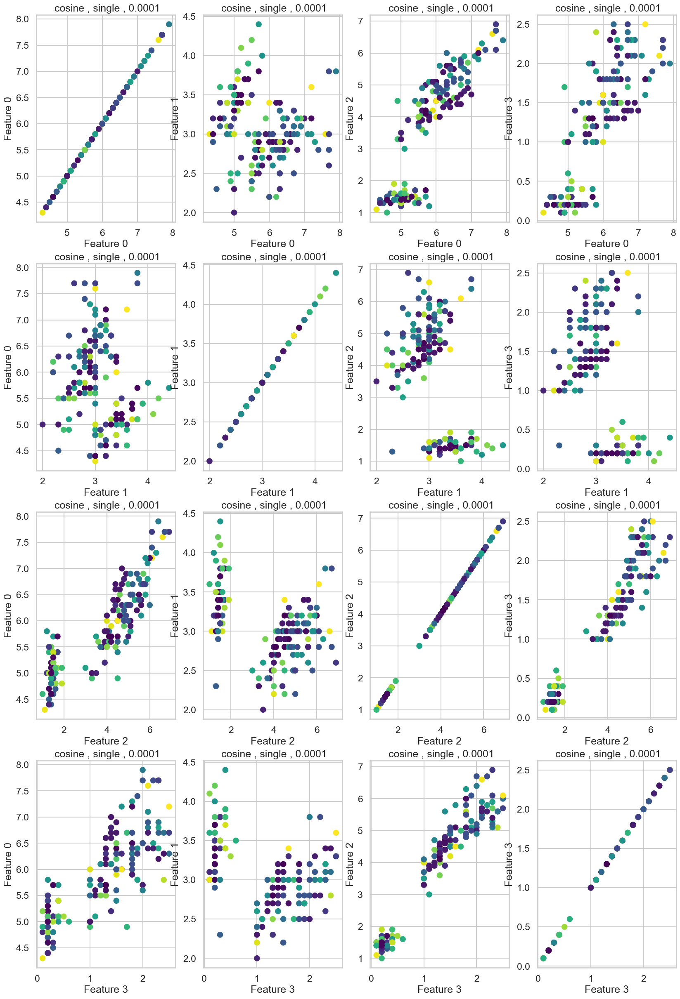

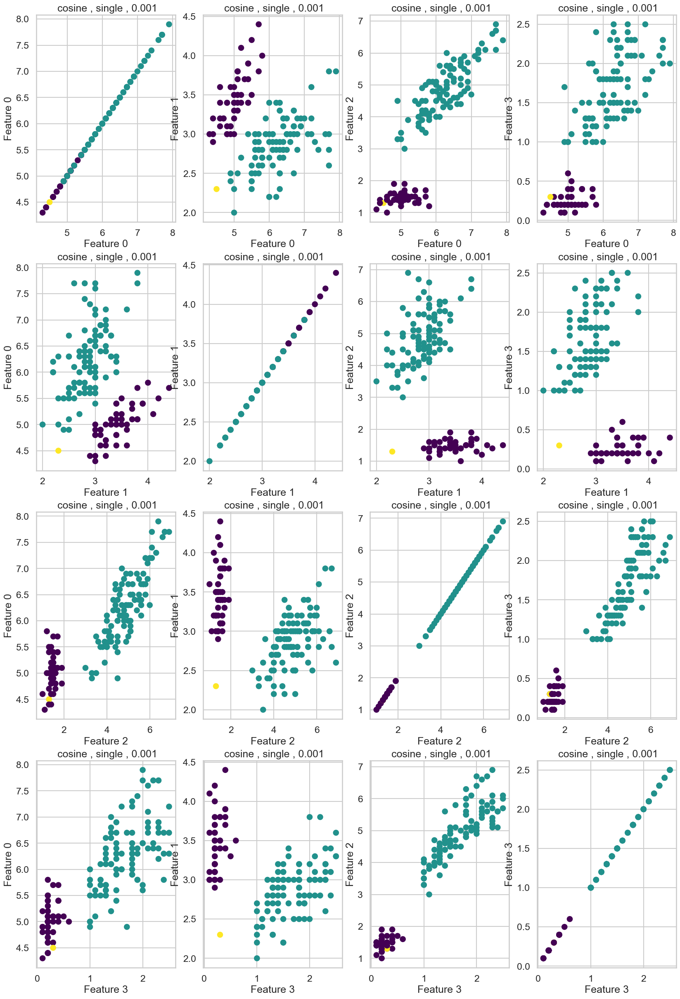

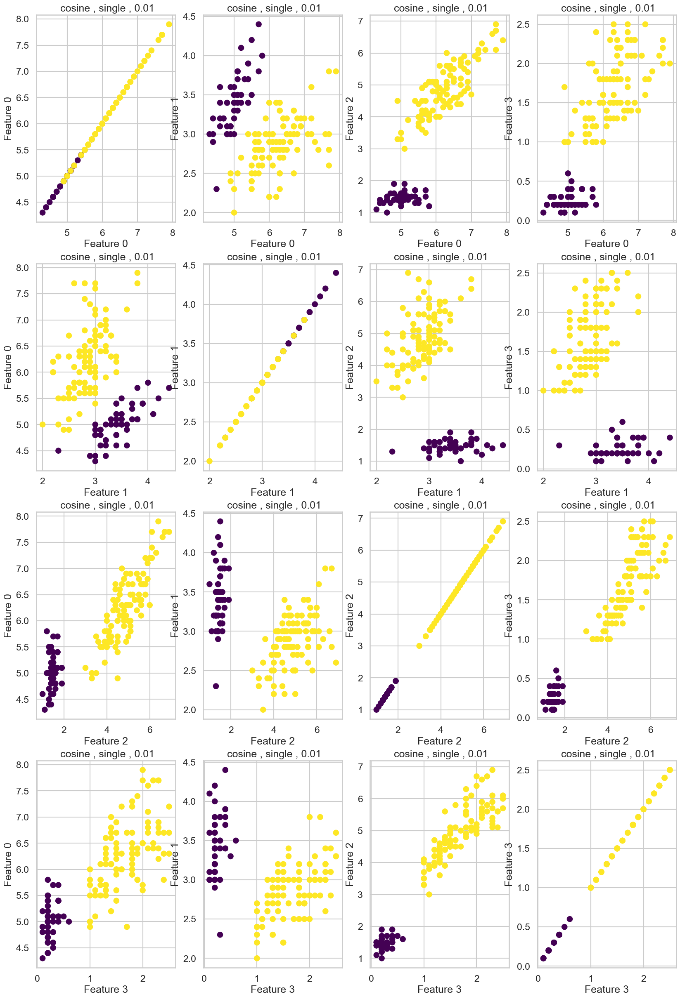

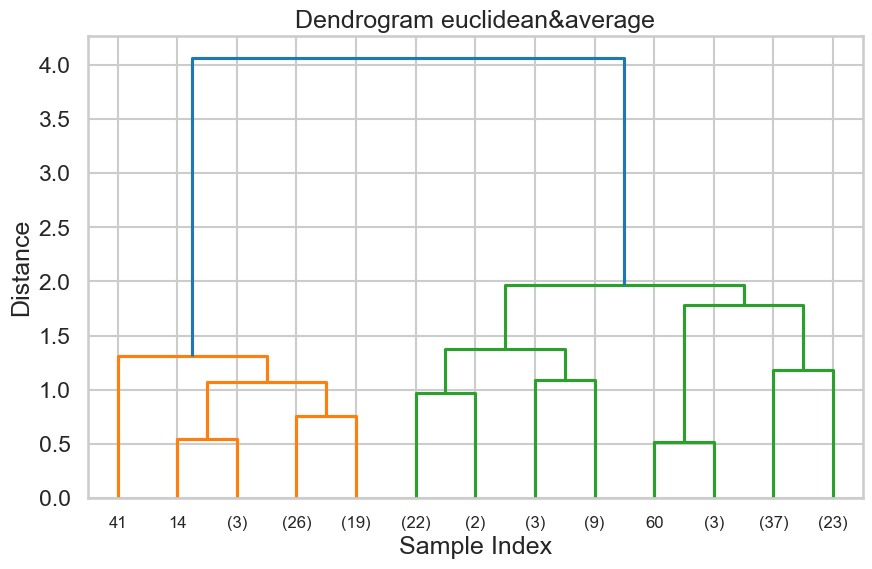

Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.02114381916836208
Silhouette score calculation failed: Number of labels is 150. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette Score: 0.30828513418773884
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


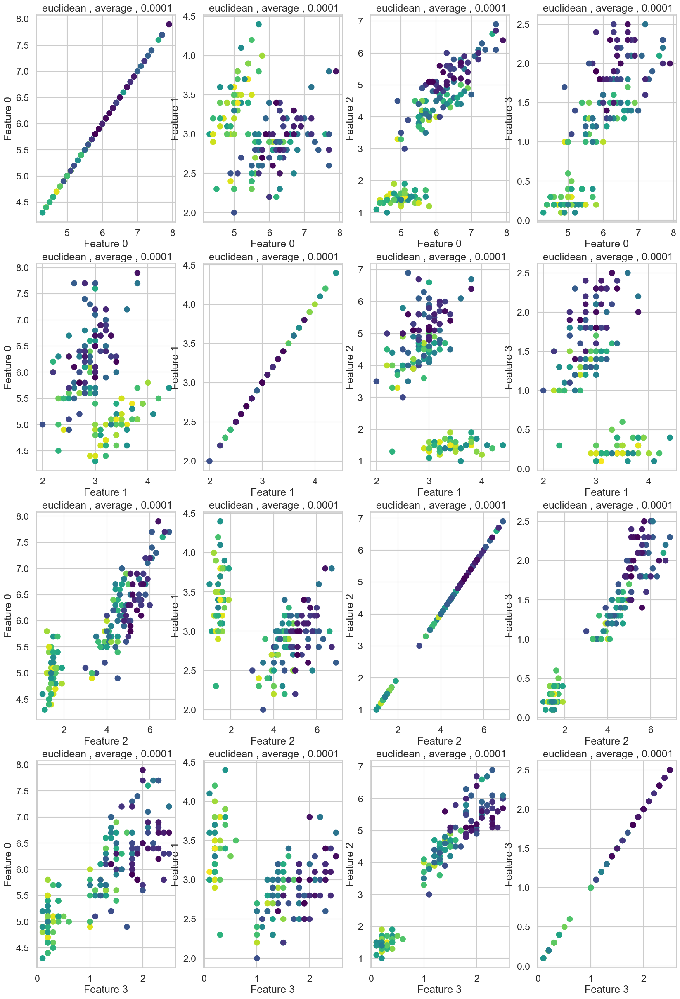

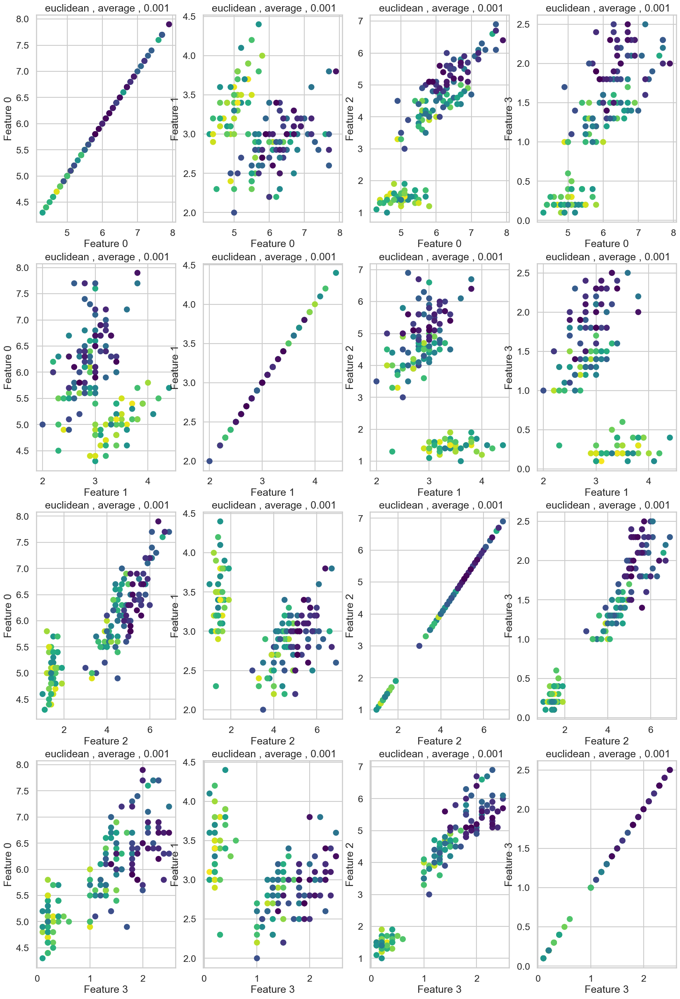

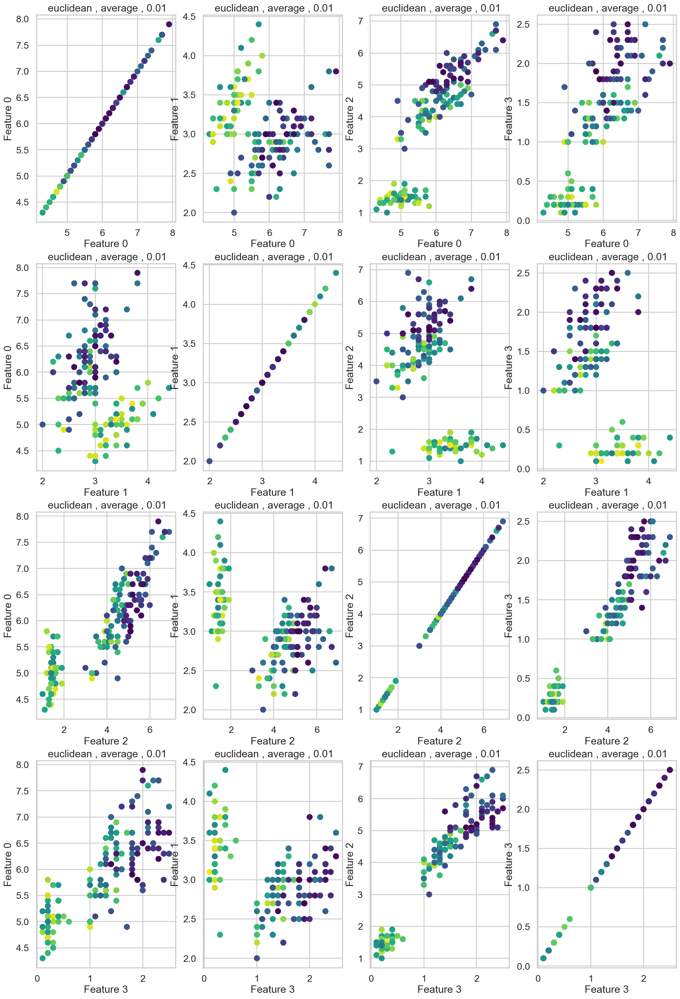

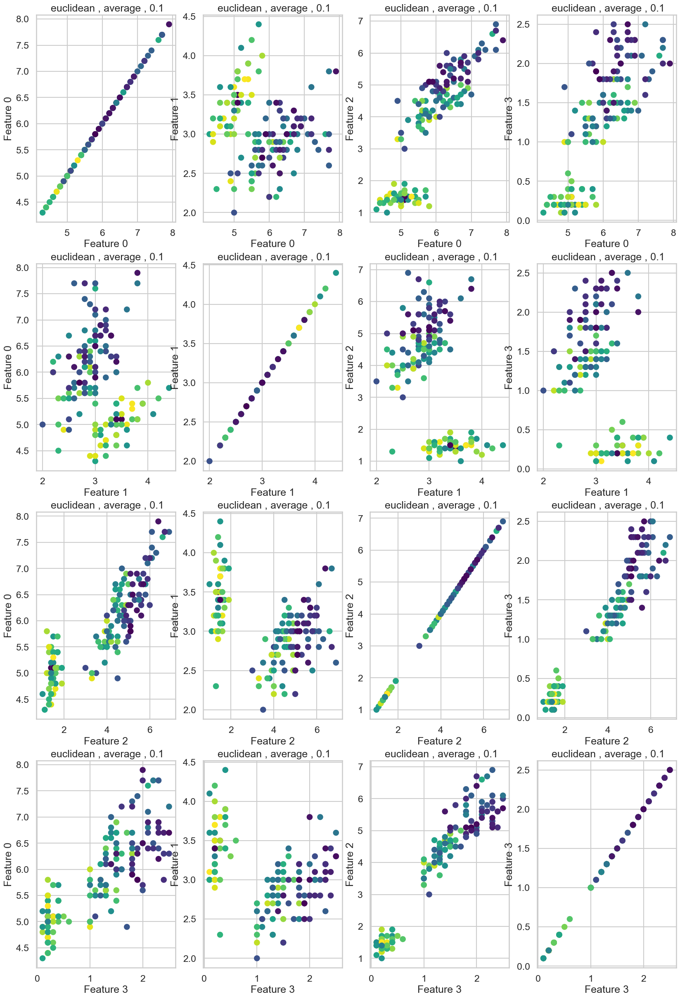

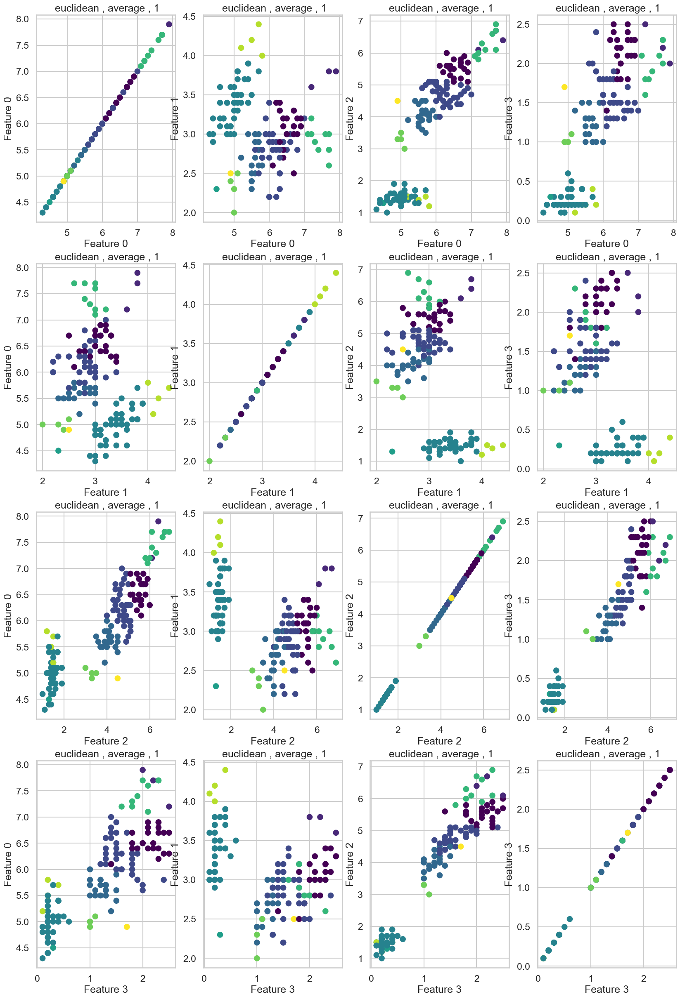

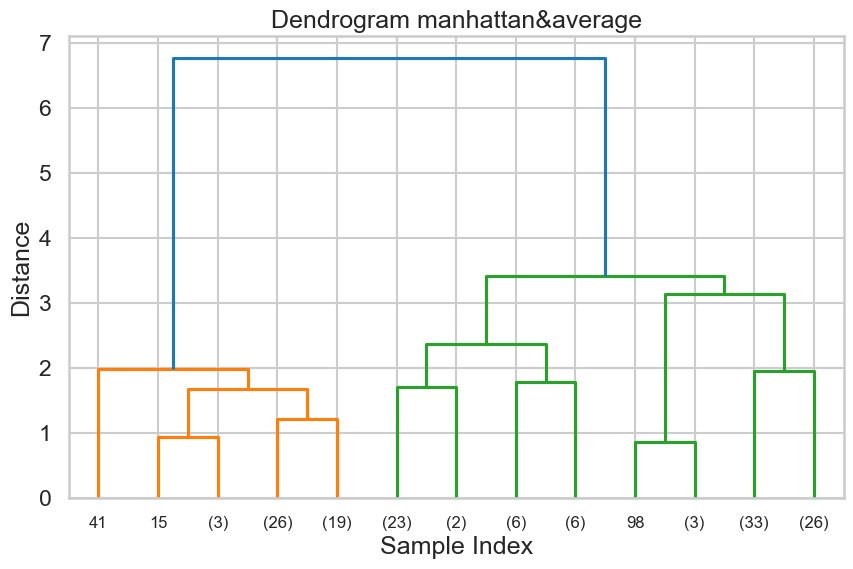

Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.013333333333333334
Silhouette Score: 0.02114381916836208
Silhouette score calculation failed: Number of labels is 150. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette Score: 0.26306030563698024
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


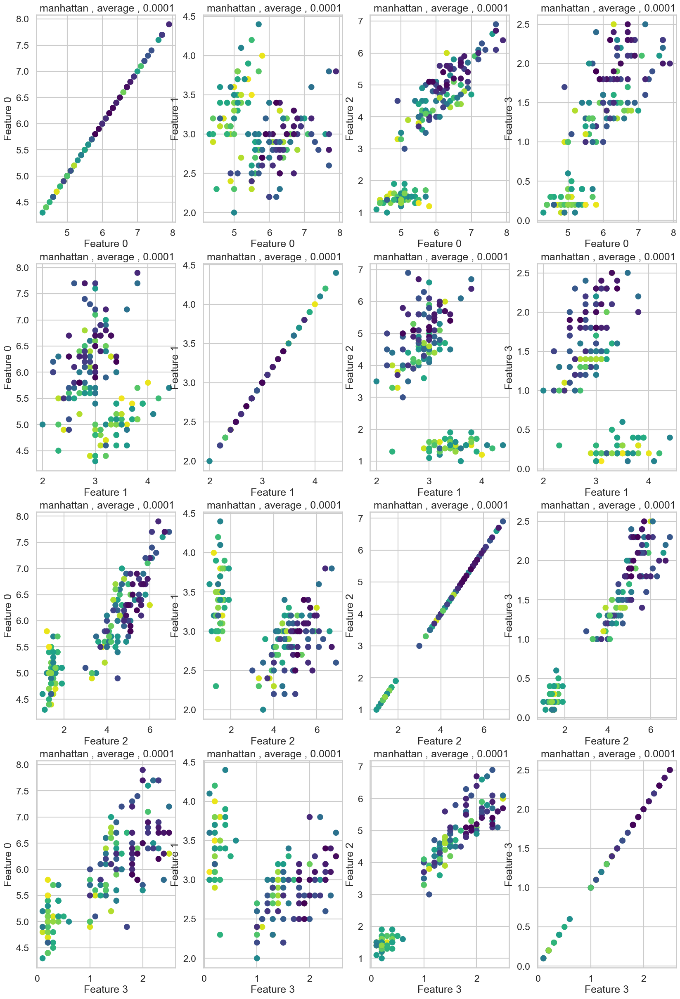

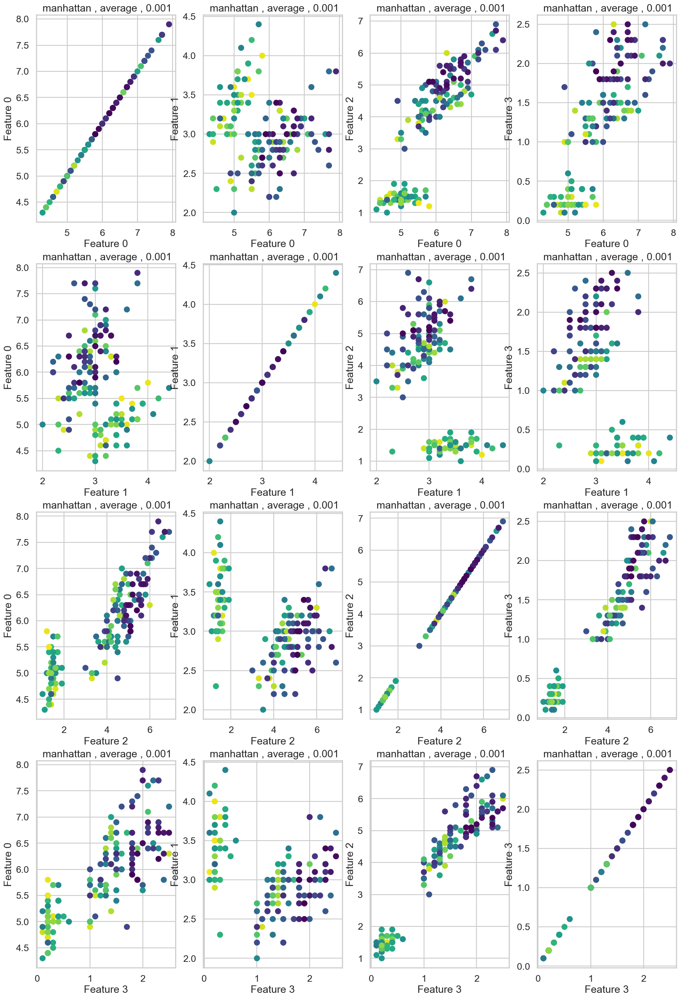

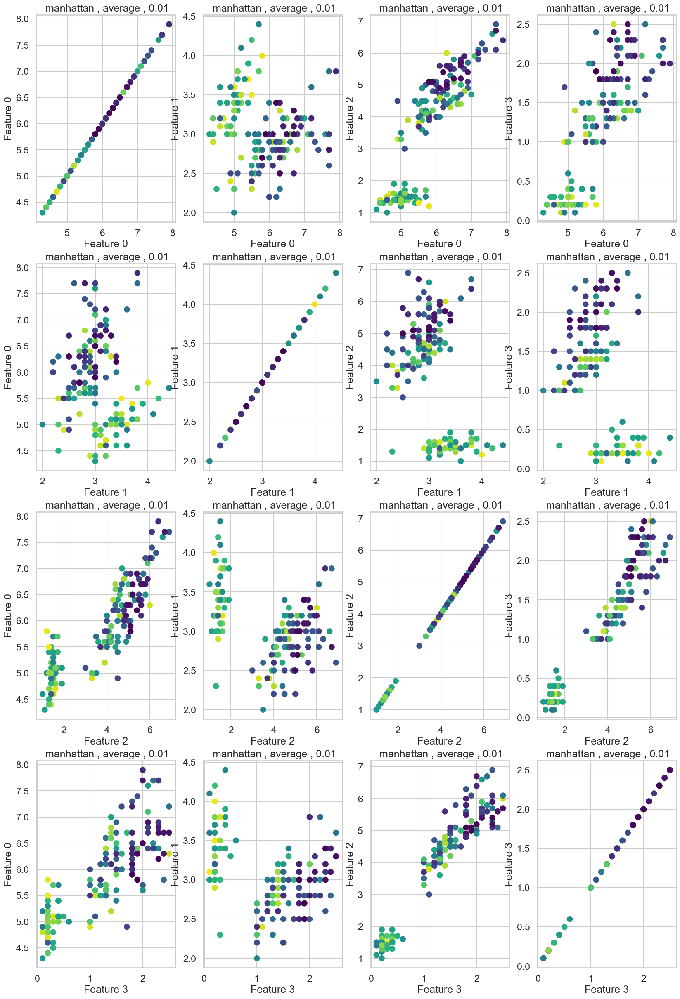

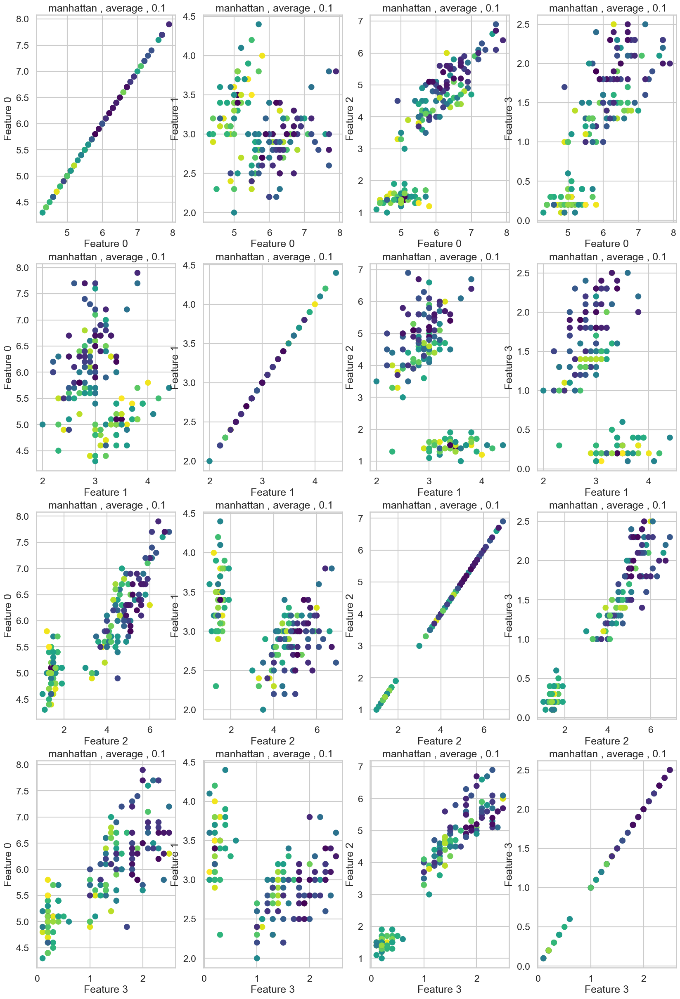

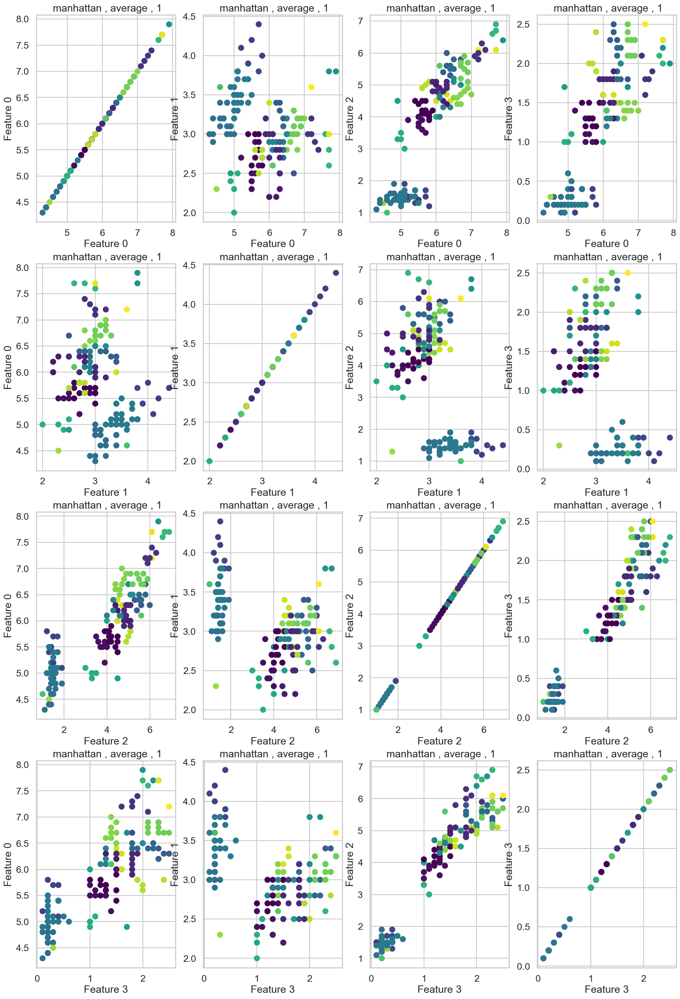

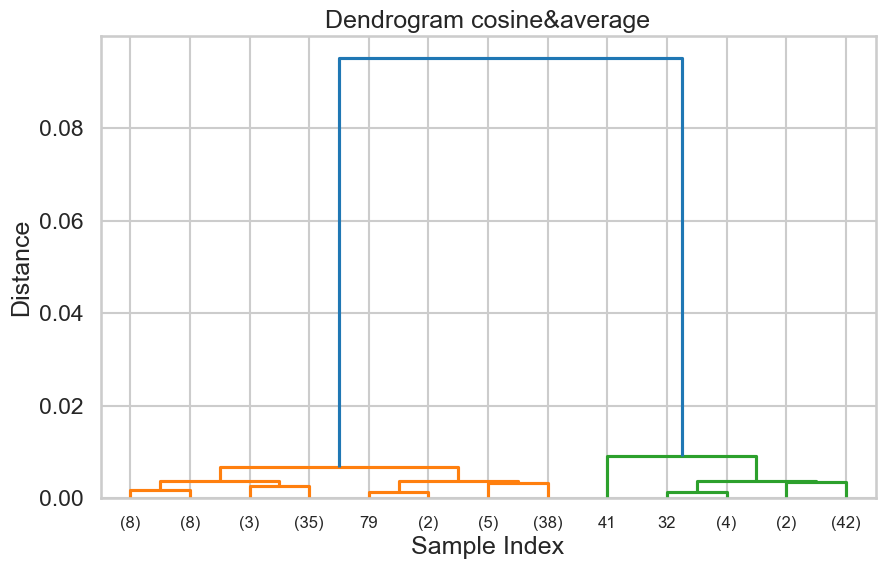

Silhouette Score: -0.27614069199313457
Silhouette Score: -0.15875307166342179
Silhouette Score: 0.6867350732769777
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 150. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Silhouette score calculation failed: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
Best Parameters: {'affinity': 'euclidean', 'linkage': 'single', 'distance_threshold': 1}
Best Silhouette Score: 0.6867350732769

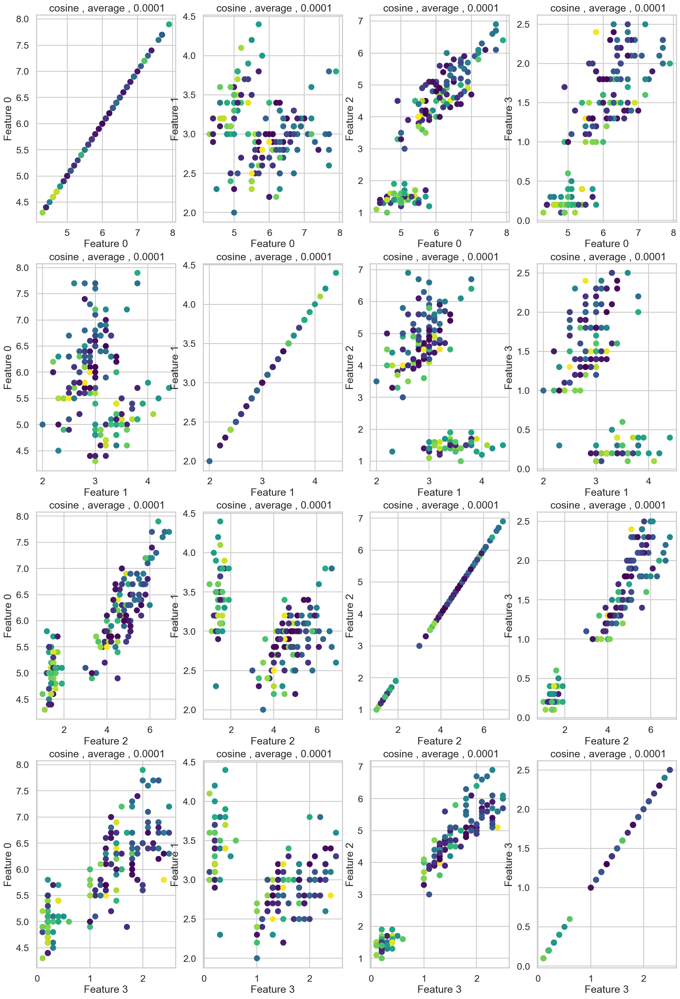

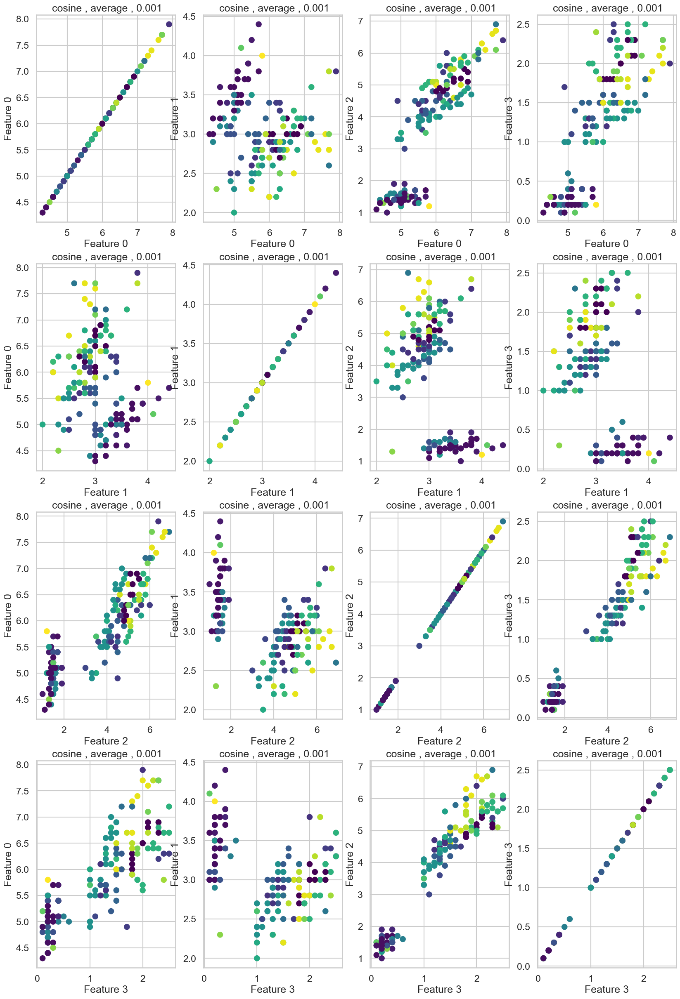

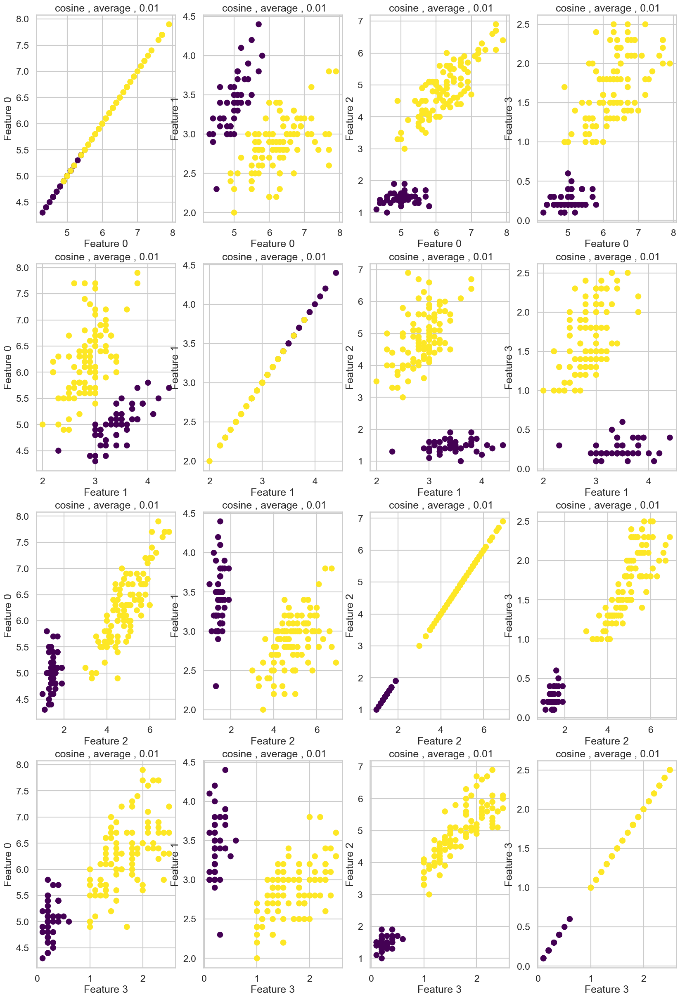

In [33]:
Heierarchal(Iris_Data)

<h2>DBScan for Iris</h2>

In [34]:
def DBScan(data):
    
    # Initialize parameters range
    eps_range = np.linspace(0.1, 3, 28)
    min_samples_range = np.arange(5, 26)

    #best parameters
    best_eps = 0.1
    best_min_samples = 5
    best_silhouette_DB = -1
    # Initialize lists to store silhouette scores for plotting
    silhouette_scores_DB = []
    
    # Iterate over EPS and min_samples values
    for min_samples in min_samples_range:
        for eps in eps_range:
            # Perform DBSCAN clustering
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)
        
        
            # Check if DBSCAN formed more than one cluster
            if data.shape[0]>len(np.unique(labels)) > 1:
                # Compute silhouette score
                silhouette = silhouette_score(data, labels)
            
                # Check if current silhouette score is better than the previous best
                if silhouette >= best_silhouette_DB:
                    best_eps = eps
                    best_min_samples = min_samples
                    best_silhouette_DB = silhouette
            else:
                silhouette=-1
            silhouette_scores_DB.append(silhouette)


    # Plot silhouette score versus variations in EPS and min_samples
    plt.figure(figsize=(12, 6))
    plt.plot(silhouette_scores_DB, linestyle='-')
    plt.title('Silhouette Score vs. Parameters Variations')
    plt.ylabel('Silhouette Score')
    plt.tight_layout()
    plt.show()

    print(f"Best Parameters: EPS = {best_eps}, Min Samples = {best_min_samples}")
    print(f"Best Silhouette Score: {best_silhouette_DB}")
    Best_Silhouettes.append(best_silhouette_DB)
    print(Best_Silhouettes)

    # Perform DBSCAN clustering with best parameters
    best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
    best_clusters = best_dbscan.fit_predict(data)

    display(data,best_clusters,'DBSCAN Clustering (Best Parameters)')


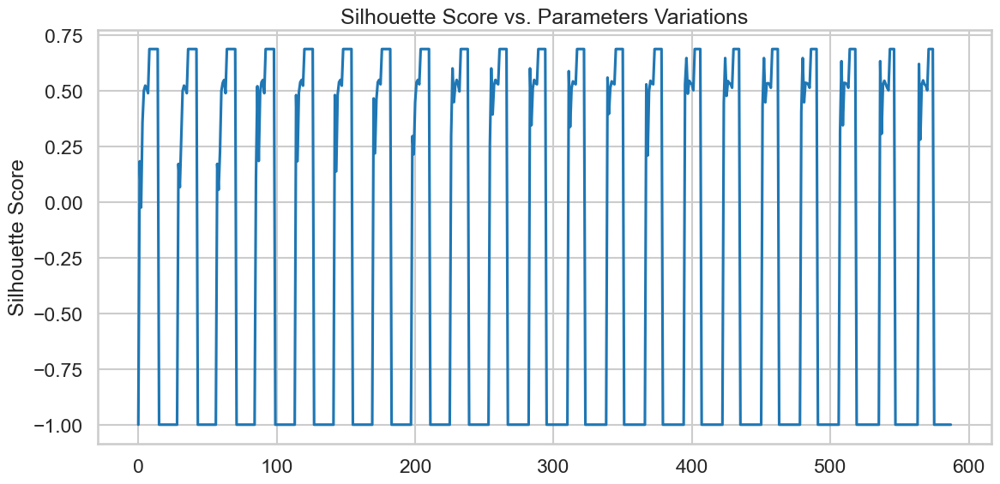

Best Parameters: EPS = 1.6037037037037039, Min Samples = 25
Best Silhouette Score: 0.6867350732769777
[0.48614459735646176, 0.46762361386512785, 0.4685207355522043, 0.6810461692117462, 0.6867350732769777, 0.6867350732769777]


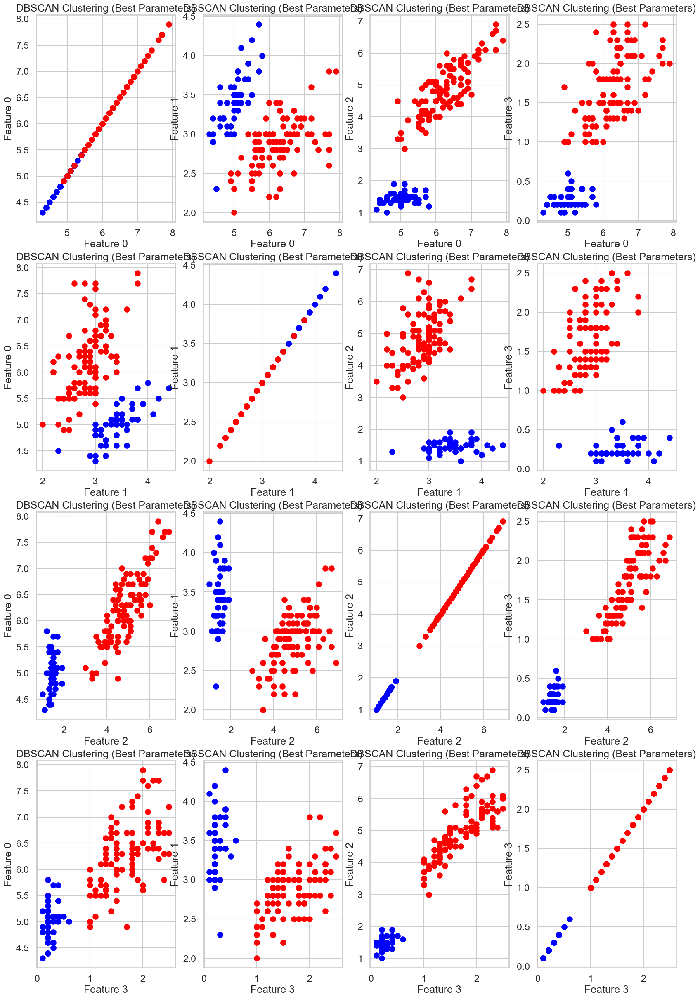

In [35]:
DBScan(Iris_Data)

<h2>Gaussian mixture for iris</h2>

In [36]:
def plot_gmm(data, covariance_types=['full', 'tied', 'diag', 'spherical'], colors=['blue', 'red', 'green', 'orange']):
    num_features = data.shape[1]
    fig, axes = plt.subplots(num_features, num_features, figsize=(12, 10))
    
    for i in range(num_features):
        for j in range(num_features):
            for k, cov_type in enumerate(covariance_types):
                # Fit GMM
                gmm = GaussianMixture(n_components=6, covariance_type=cov_type, random_state=42)
                gmm.fit(data[:, [i, j]])  # Select only two features for each plot
                
                # Plot contours
                x = data[:, i]
                y = data[:, j]
                x_min, x_max = x.min() - 1, x.max() + 1
                y_min, y_max = y.min() - 1, y.max() + 1
                X, Y = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
                XX = np.array([X.ravel(), Y.ravel()]).T
                Z = -gmm.score_samples(XX)
                Z = Z.reshape(X.shape)

                ax = axes[i, j]
                ax.scatter(x, y, color='black', s=10, marker='o', alpha=0.5)
                ax.contour(X, Y, Z, levels=10, linewidths=1, colors=colors[k])
                ax.set_xlabel(f'Feature {i}')
                ax.set_ylabel(f'Feature {j}')

    plt.tight_layout()
    plt.show()



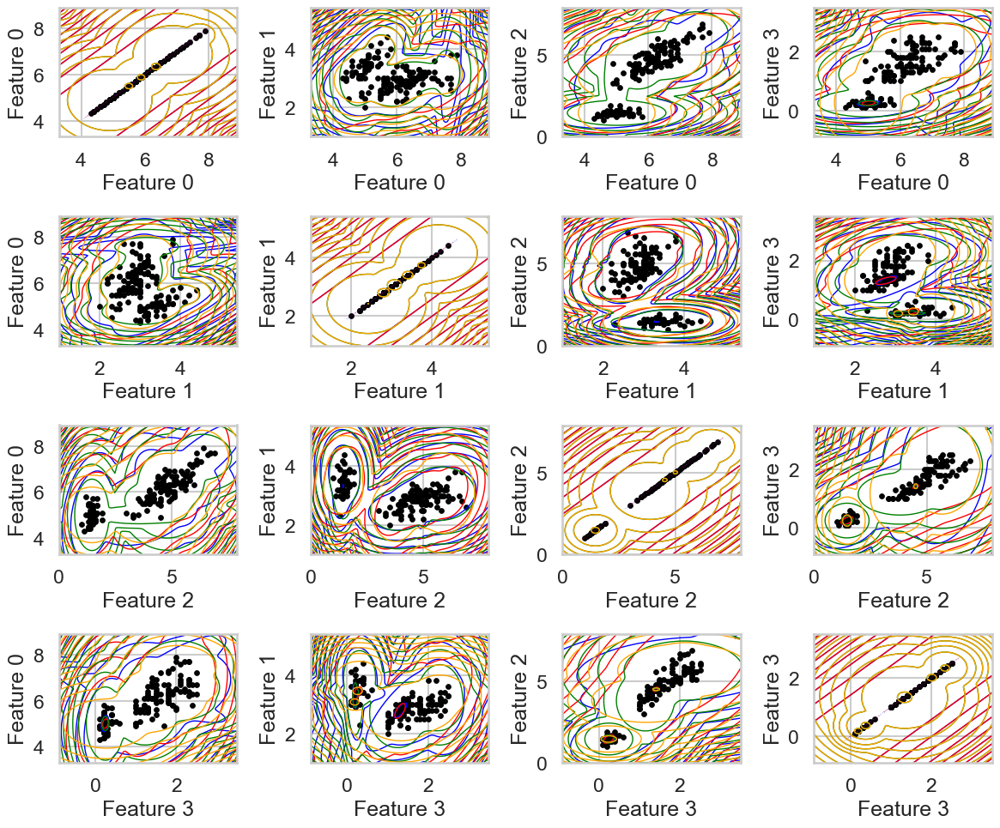

In [37]:
plot_gmm(Iris_Data)

<h1>Iris Dataset Normalized</h1>

In [38]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
Iris_normalized = scaler.fit_transform(Iris_Data)

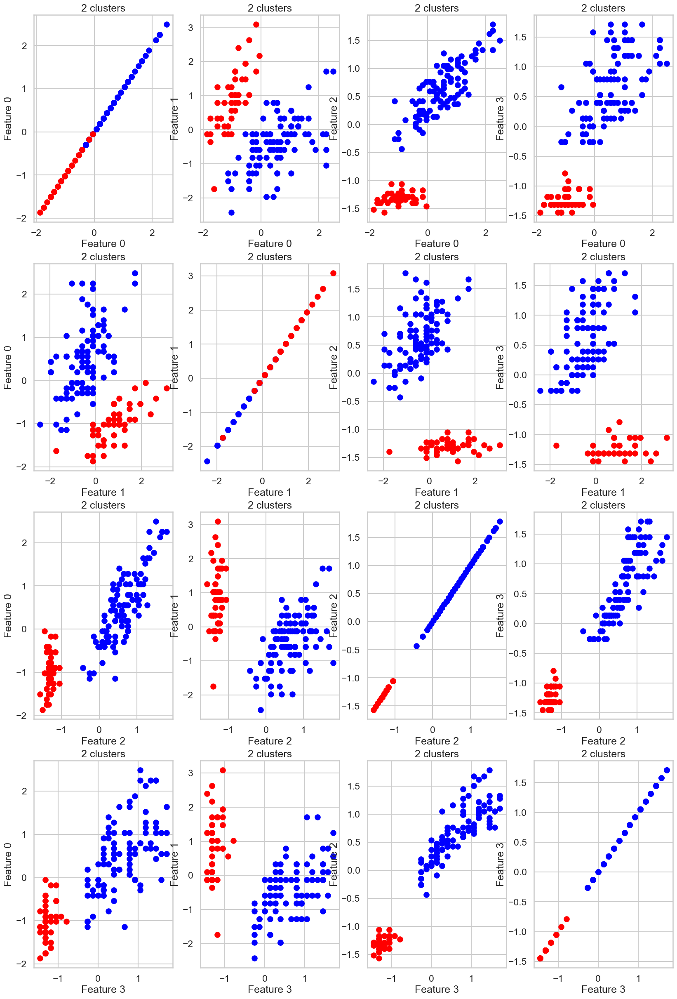

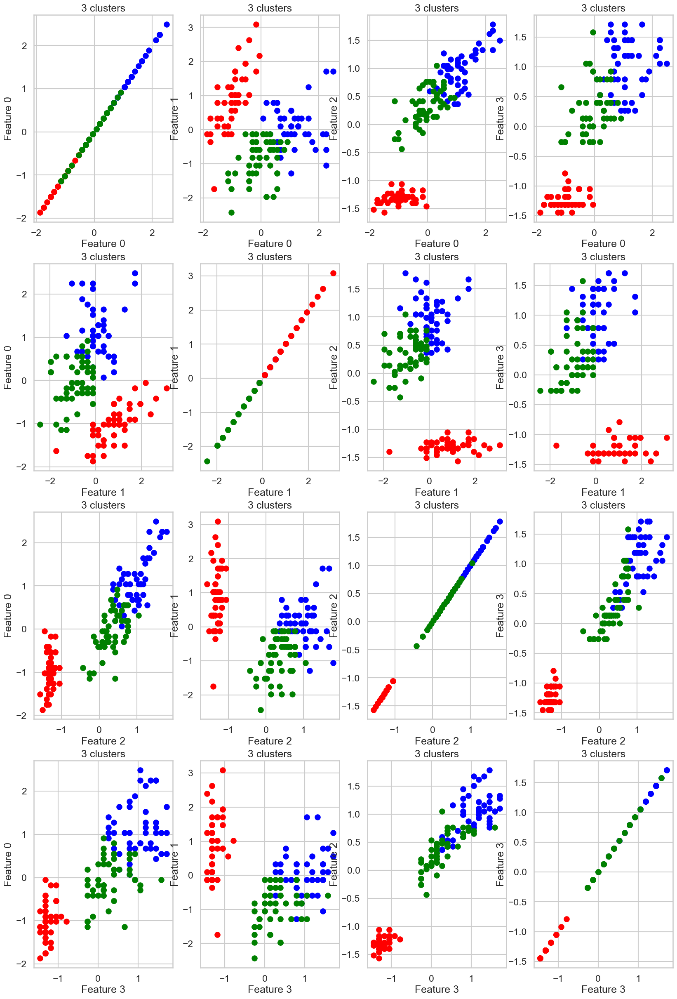

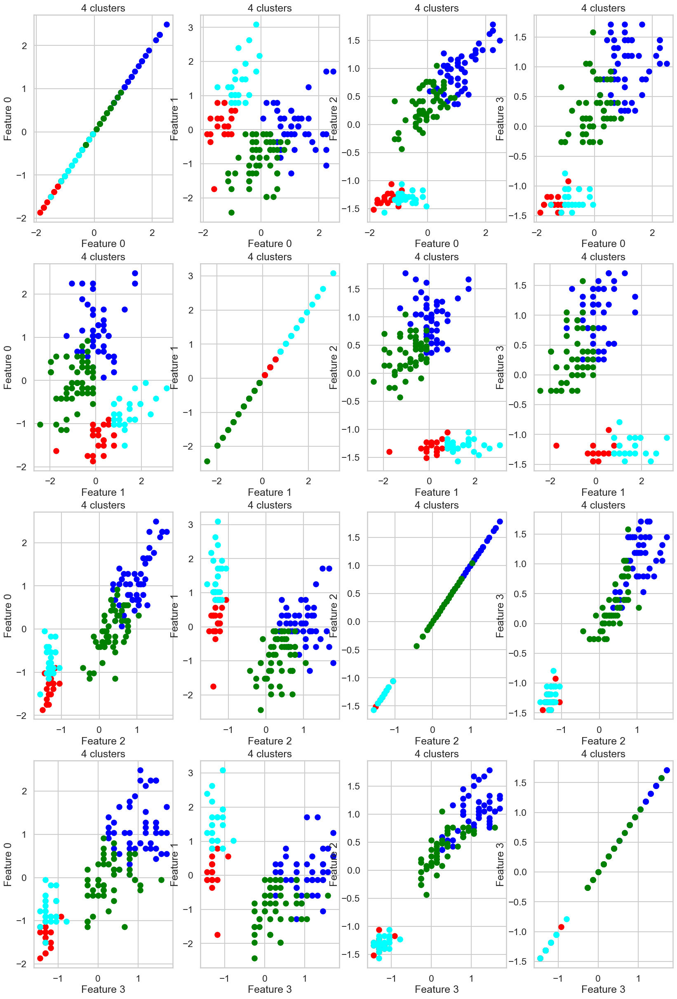

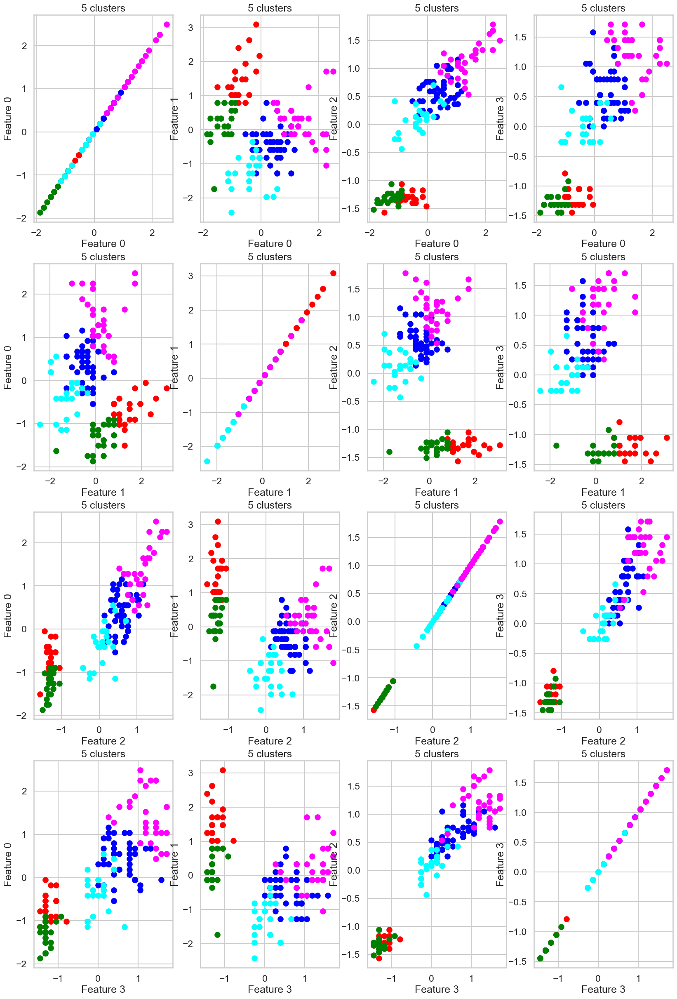

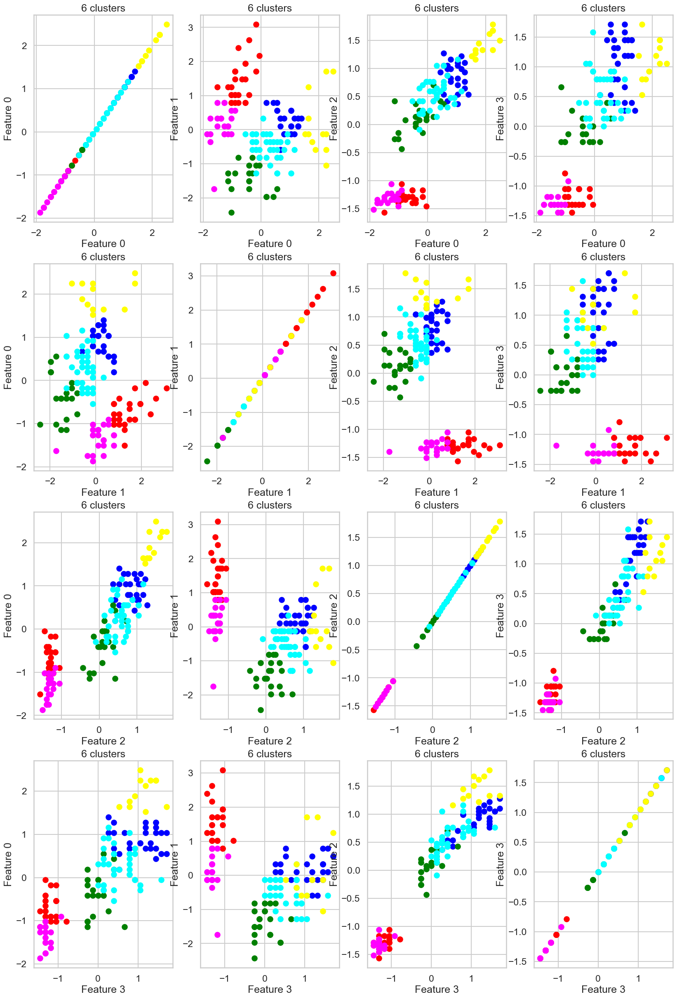

...

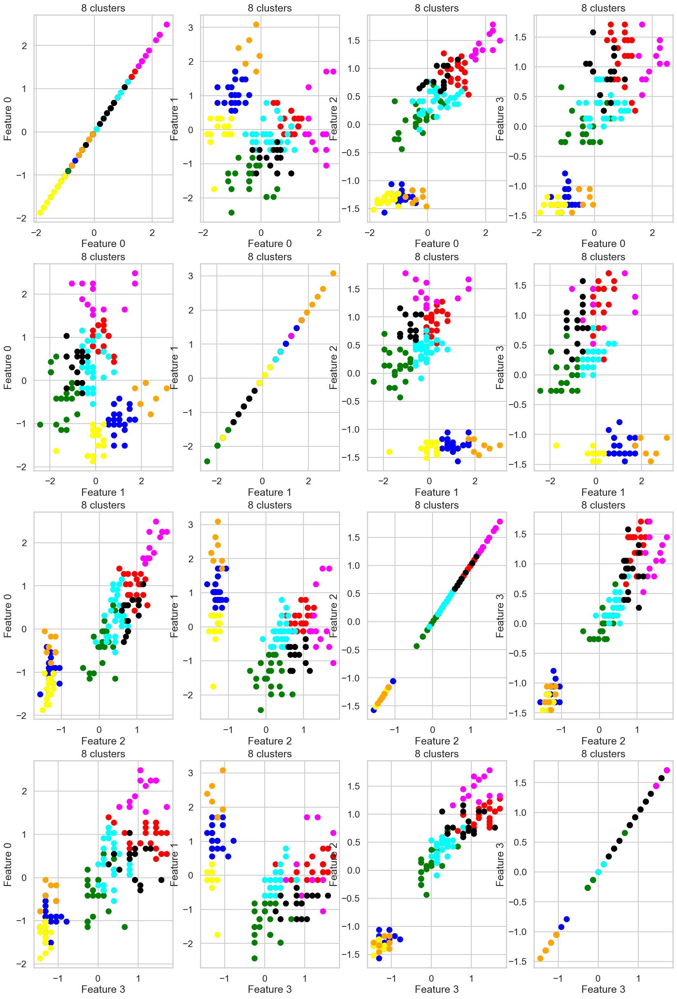

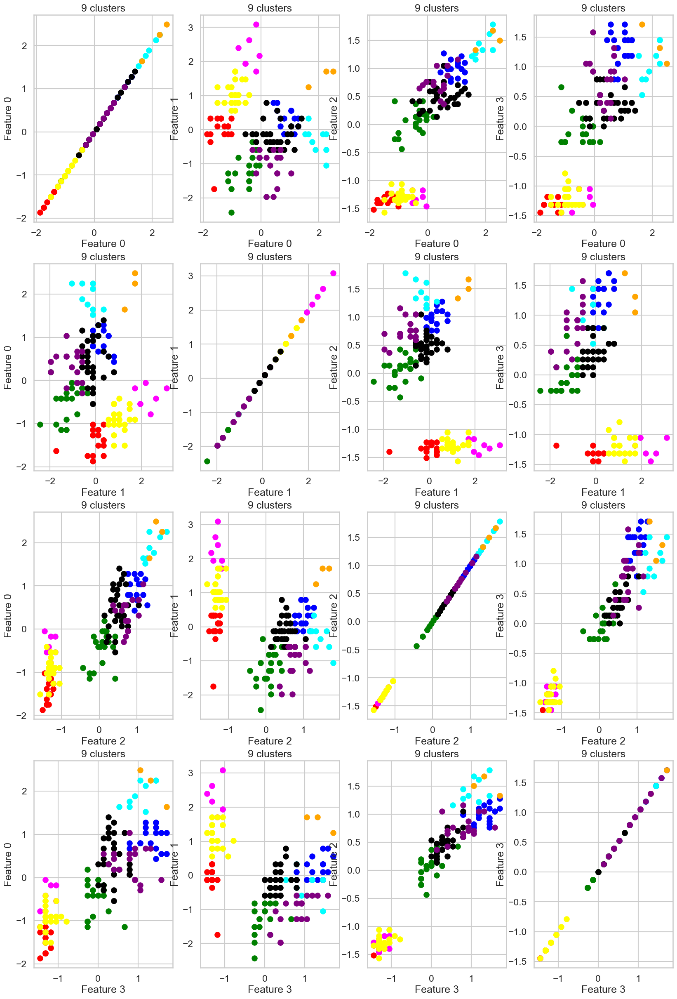

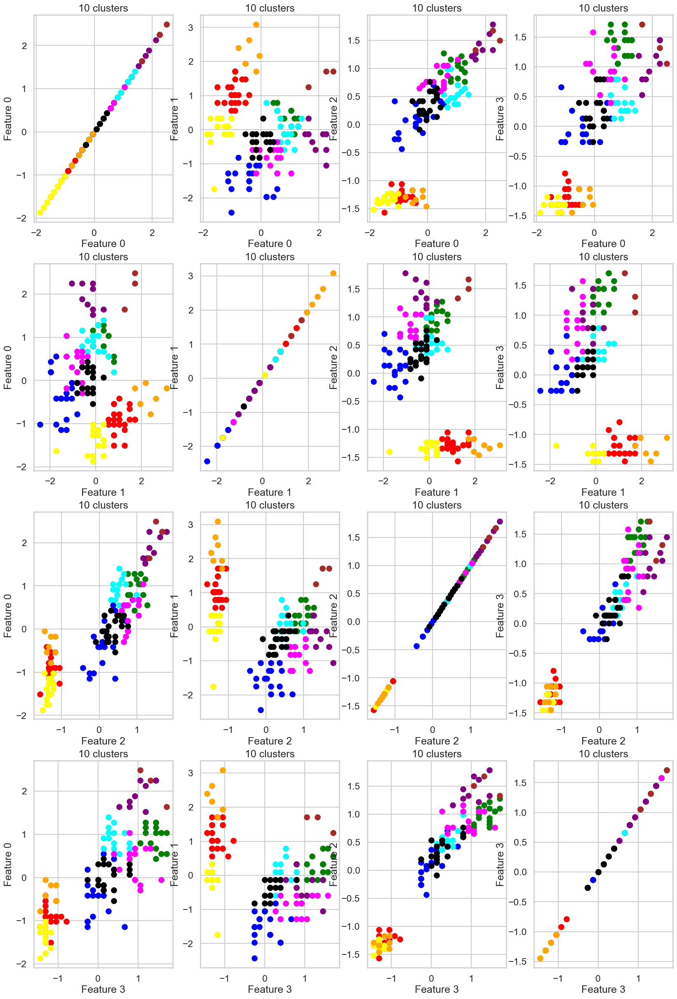

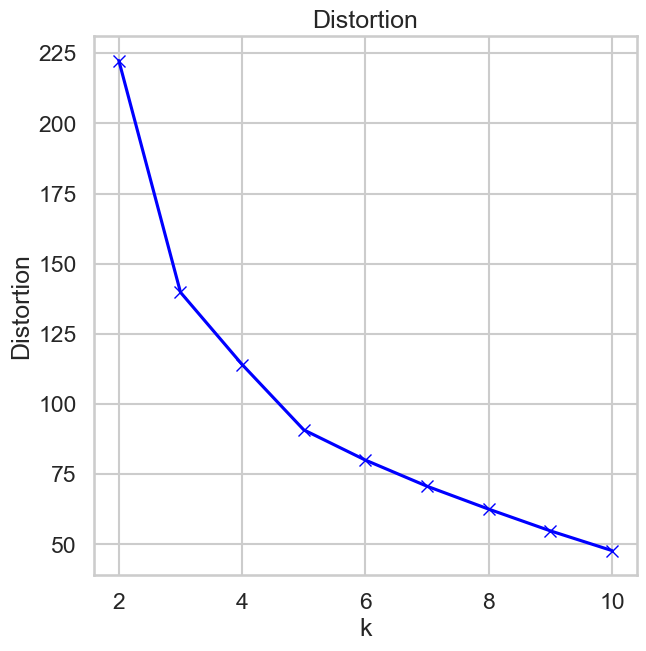

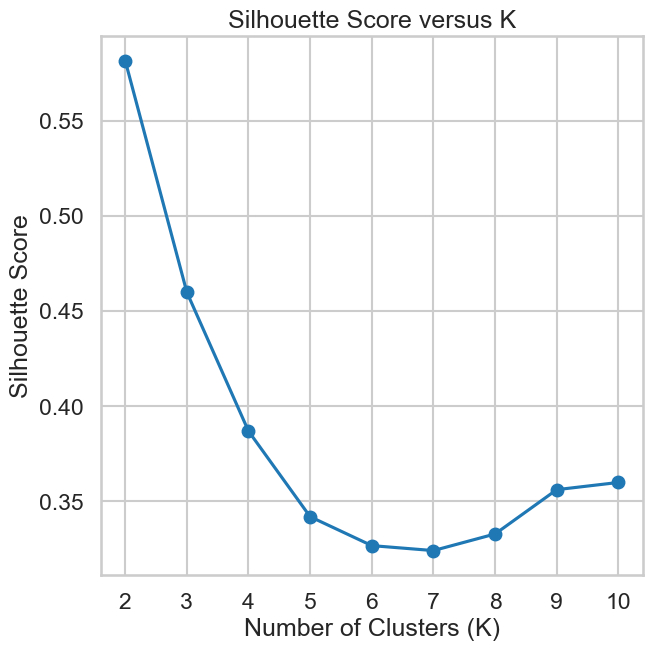

Best K based on silhouette score: 2 , Best Value: 0.5817500491982808
[0.48614459735646176, 0.46762361386512785, 0.4685207355522043, 0.6810461692117462, 0.6867350732769777, 0.6867350732769777, 0.5817500491982808]


In [39]:
my_K_mean(Iris_normalized)

In [ ]:
Heierarchal(Iris_normalized)
#this will give many plotts,

## Note:  
the problem of varying ranges of distance threshold is solved with normalizing the data, now we can use a single array that could fit for almost all the combinations of linkage and affinity

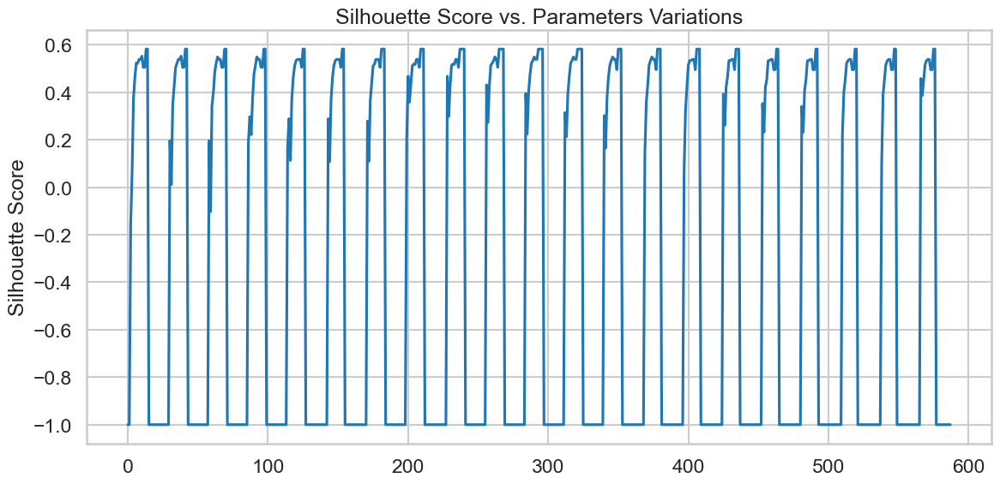

Best Parameters: EPS = 1.8185185185185186, Min Samples = 25
Best Silhouette Score: 0.5817500491982808
[0.48614459735646176, 0.46762361386512785, 0.4685207355522043, 0.6810461692117462, 0.6867350732769777, 0.6867350732769777, 0.5817500491982808, 0.5817500491982808]


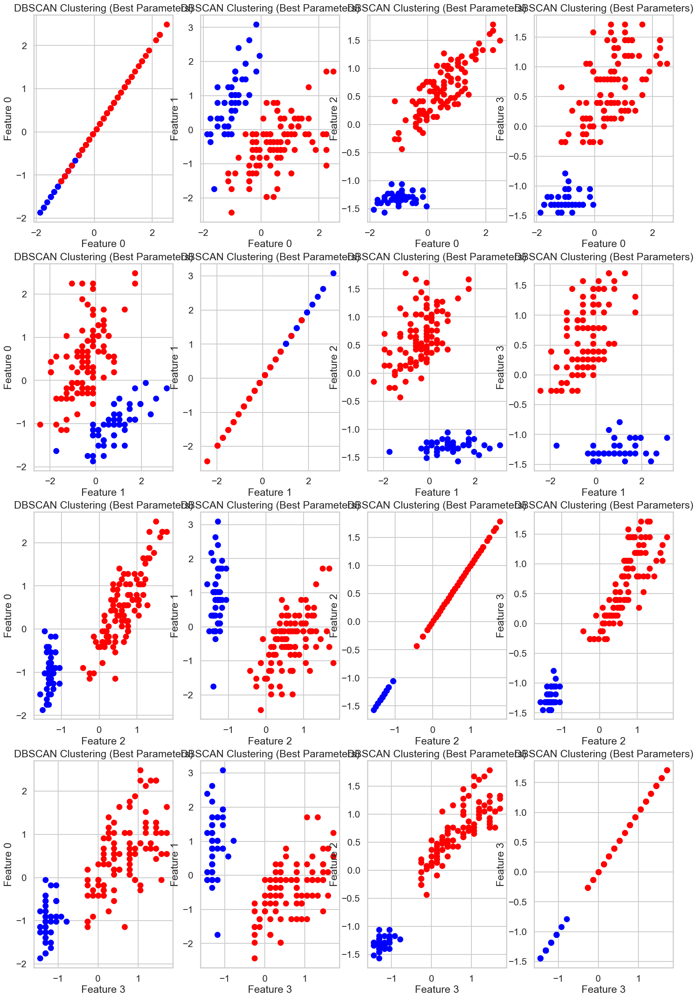

In [40]:
DBScan(Iris_normalized)

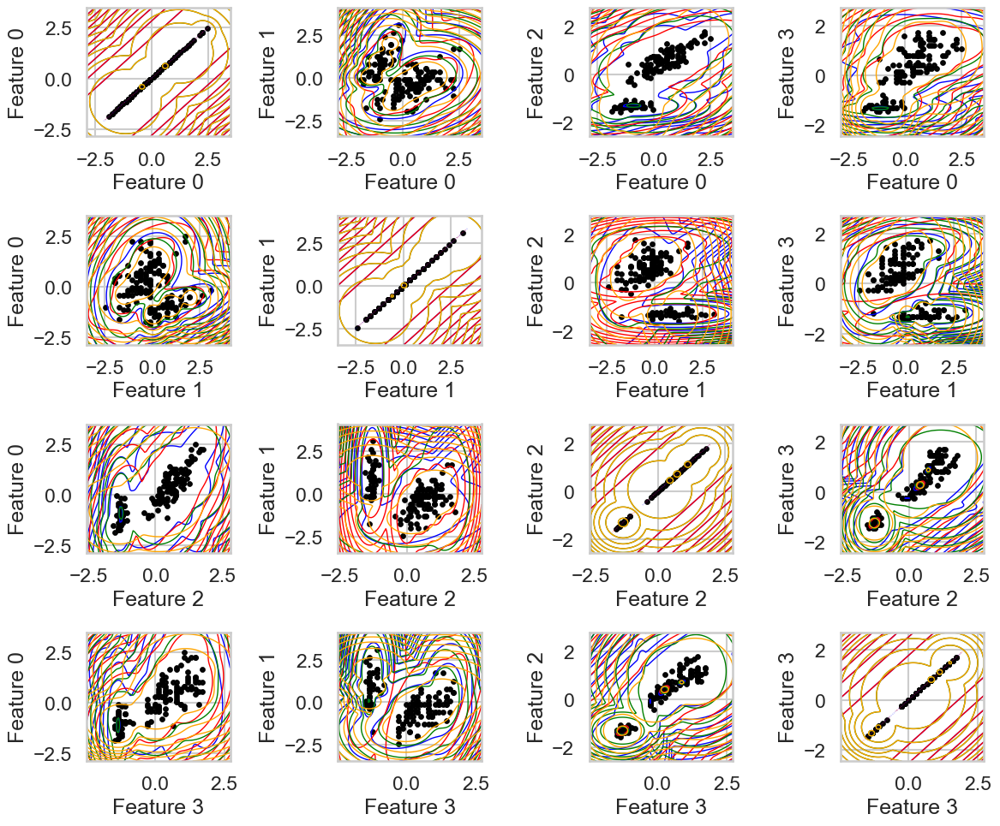

In [41]:
plot_gmm(Iris_normalized)

## Customer dataset
Repeat all the above on the customer data set 

In [42]:
import csv

with open('Customer data.csv', 'r') as f:
    reader = csv.reader(f)
    data = list(reader)
print(data)
data_array = np.array(data[1:], dtype=float)

print(data_array)

[['ID', 'Sex', 'Marital status', 'Age', 'Education', 'Income', 'Occupation', 'Settlement size'], ['100000001', '0', '0', '67', '2', '124670', '1', '2'], ['100000002', '1', '1', '22', '1', '150773', '1', '2'], ['100000003', '0', '0', '49', '1', '89210', '0', '0'], ['100000004', '0', '0', '45', '1', '171565', '1', '1'], ['100000005', '0', '0', '53', '1', '149031', '1', '1'], ['100000006', '0', '0', '35', '1', '144848', '0', '0'], ['100000007', '0', '0', '53', '1', '156495', '1', '1'], ['100000008', '0', '0', '35', '1', '193621', '2', '1'], ['100000009', '0', '1', '61', '2', '151591', '0', '0'], ['100000010', '0', '1', '28', '1', '174646', '2', '0'], ['100000011', '1', '1', '25', '1', '108469', '1', '0'], ['100000012', '1', '1', '24', '1', '127596', '1', '0'], ['100000013', '1', '1', '22', '1', '108687', '1', '2'], ['100000014', '0', '0', '60', '2', '89374', '0', '0'], ['100000015', '1', '1', '28', '1', '102899', '1', '1'], ['100000016', '1', '1', '32', '1', '88428', '0', '0'], ['10000001

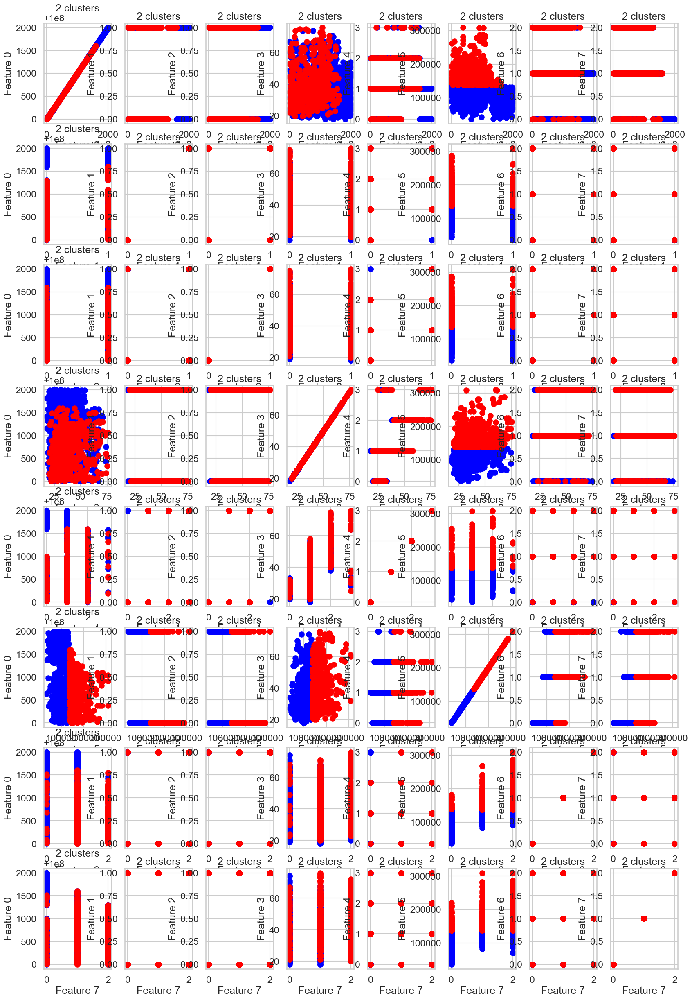

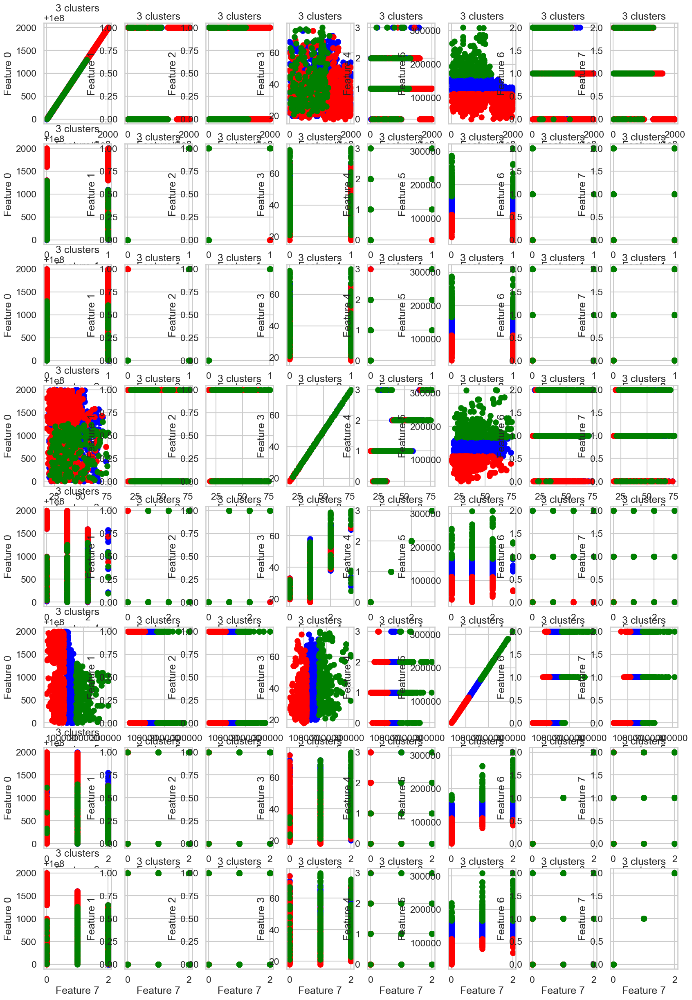

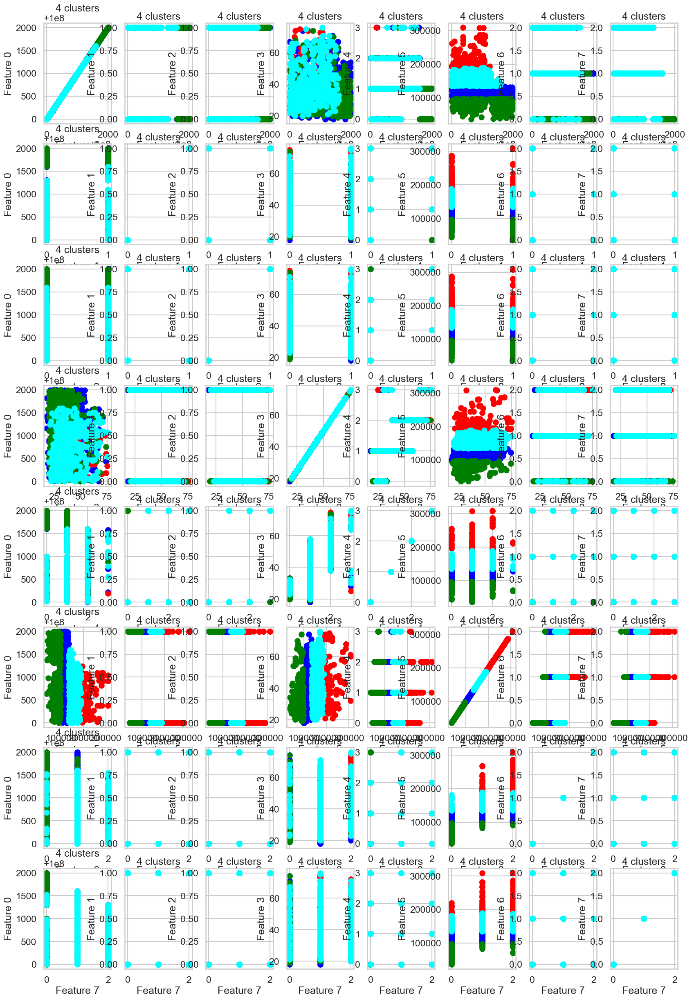

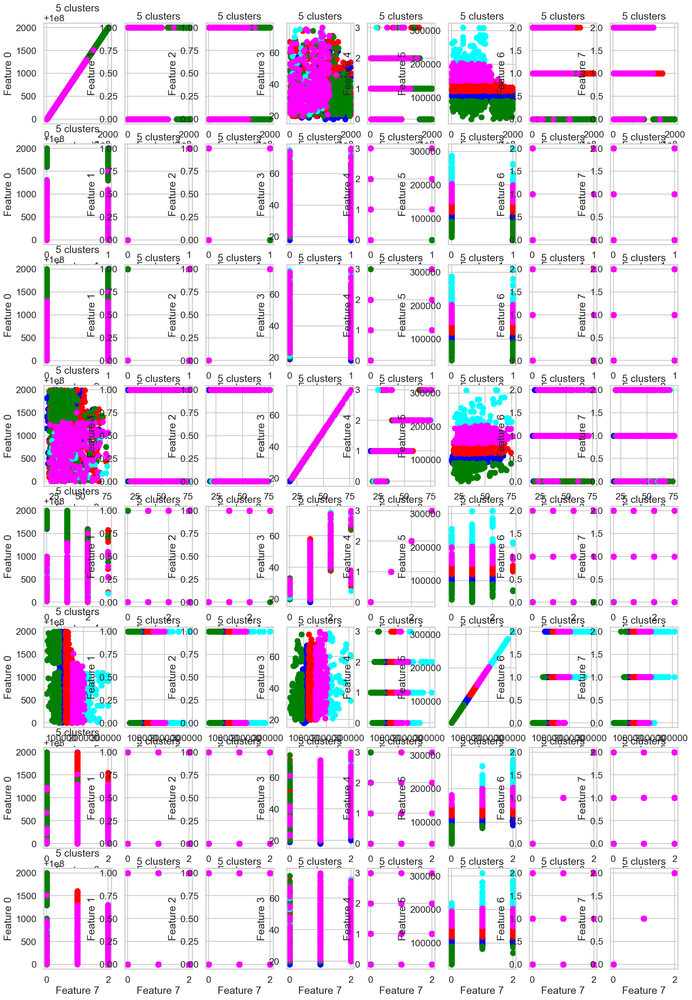

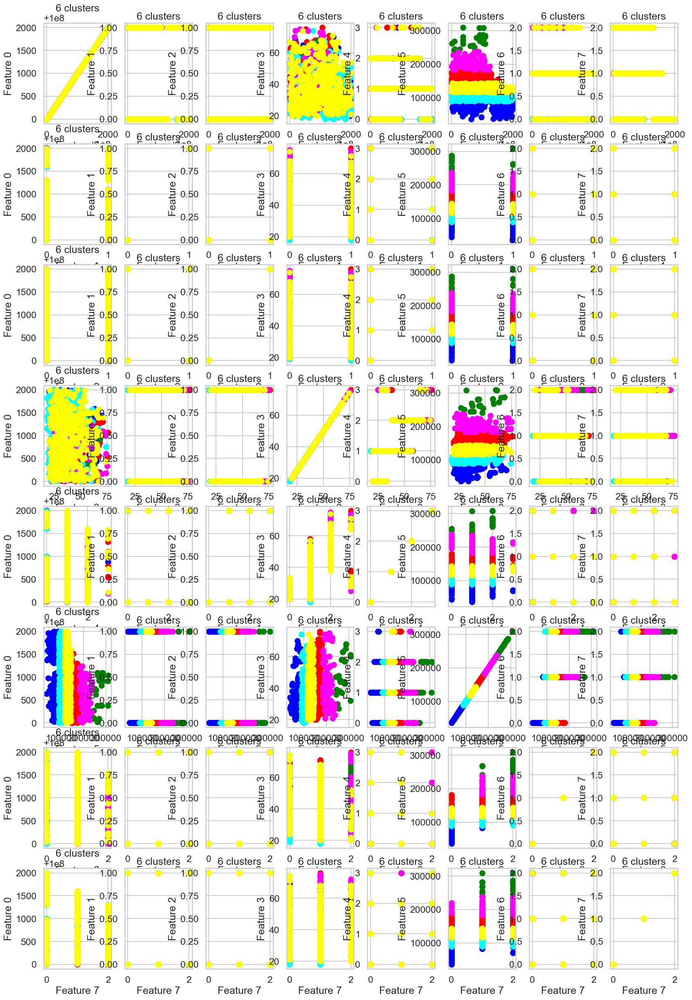

...

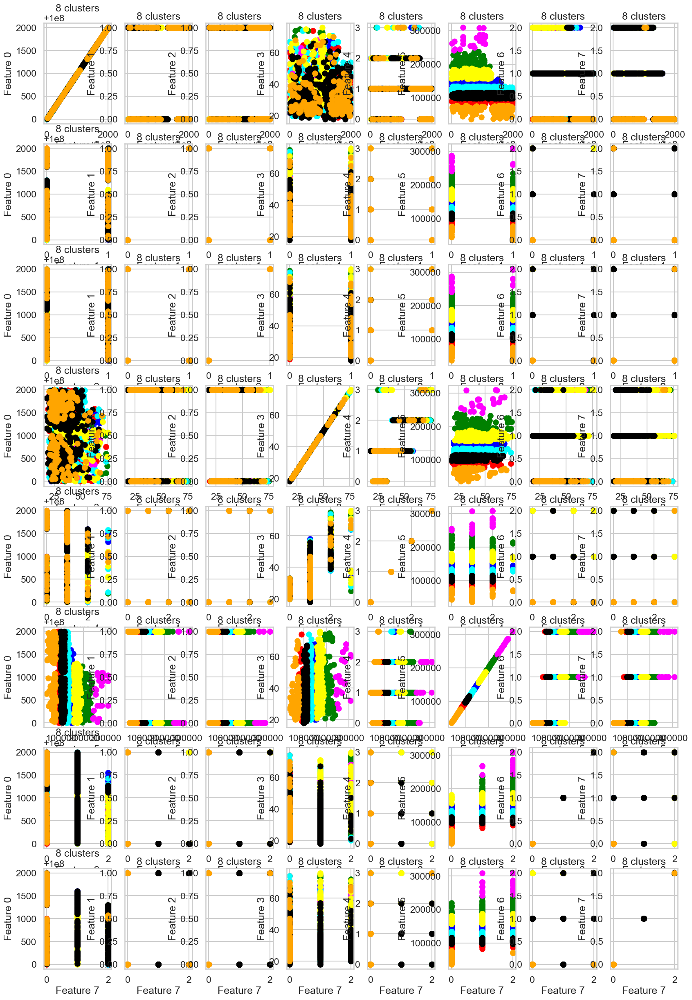

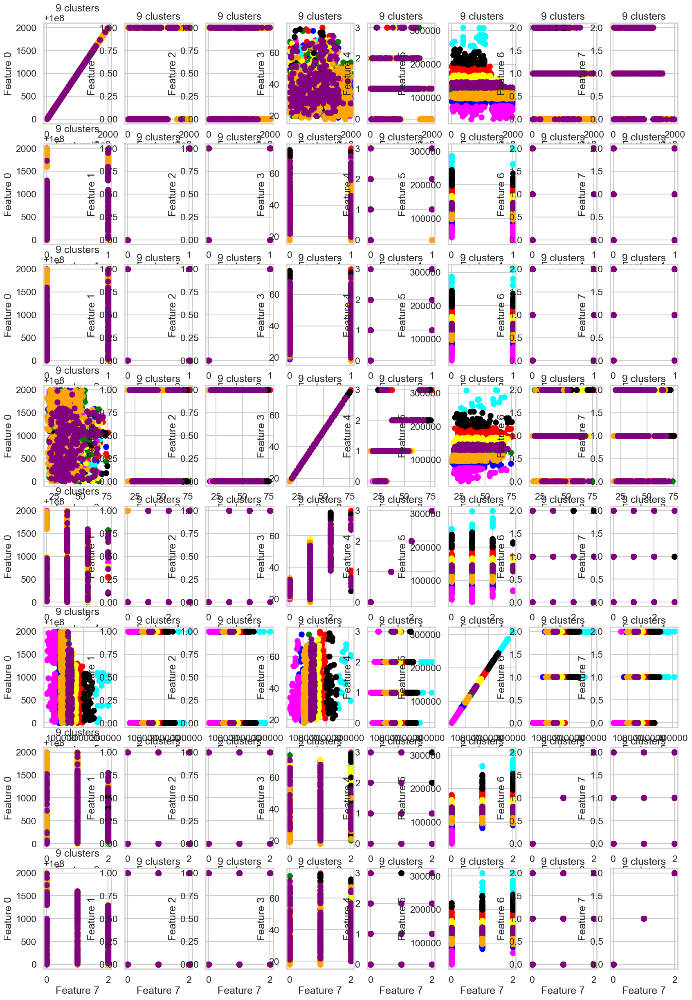

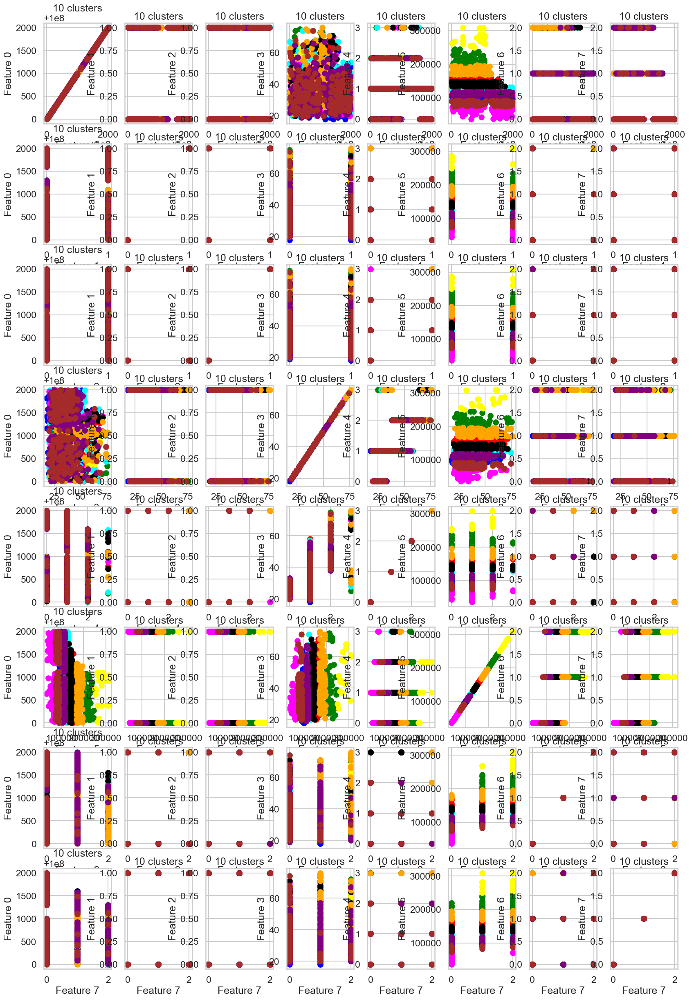

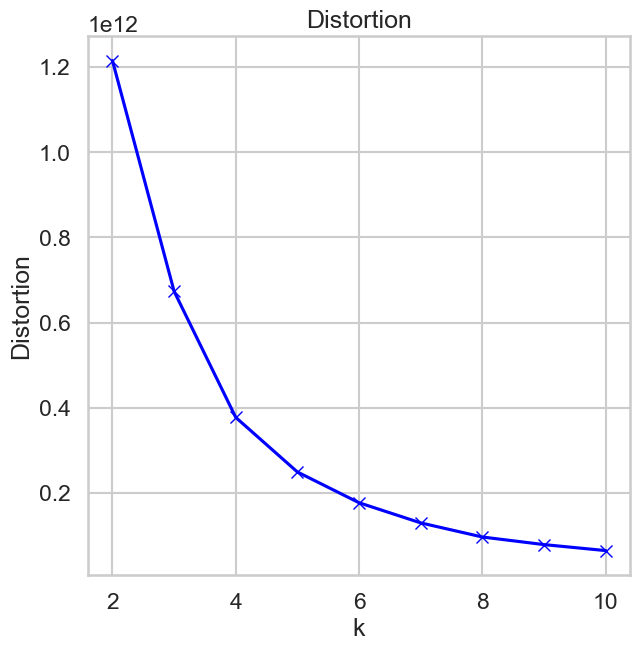

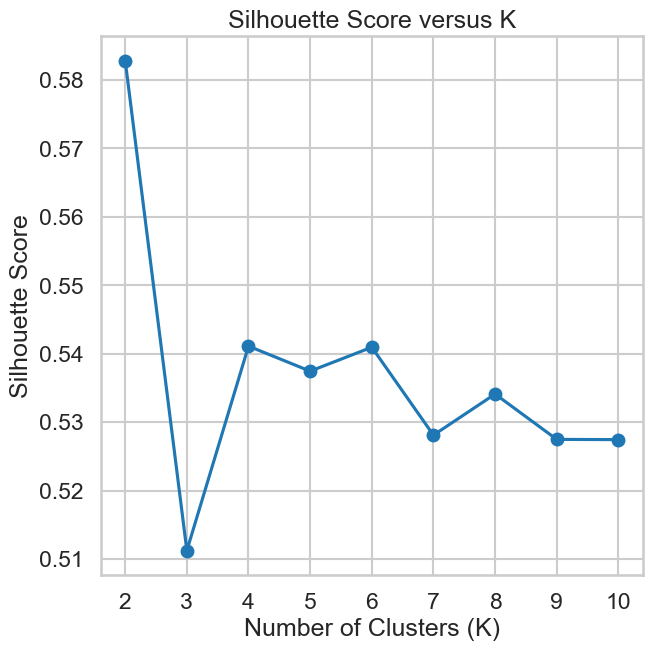

Best K based on silhouette score: 2 , Best Value: 0.5828454662631584
[0.48614459735646176, 0.46762361386512785, 0.4685207355522043, 0.6810461692117462, 0.6867350732769777, 0.6867350732769777, 0.5817500491982808, 0.5817500491982808, 0.5828454662631584]


In [43]:
my_K_mean(data_array)

In [ ]:
Heierarchal(data_array)
#this will give a huge number of plots

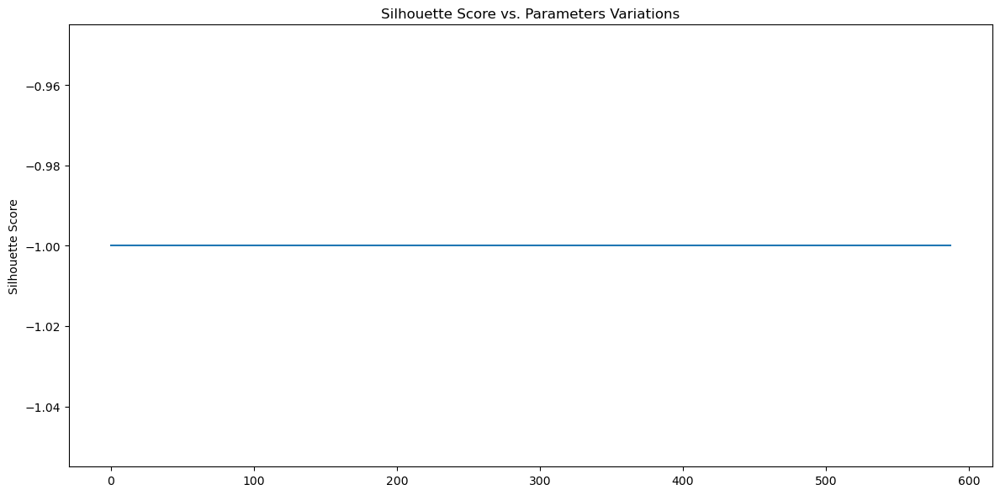

Best Parameters: EPS = 0.1, Min Samples = 5
Best Silhouette Score: -1
[0.6867350732769777, -1, 0.6867350732769777, -1, -1]


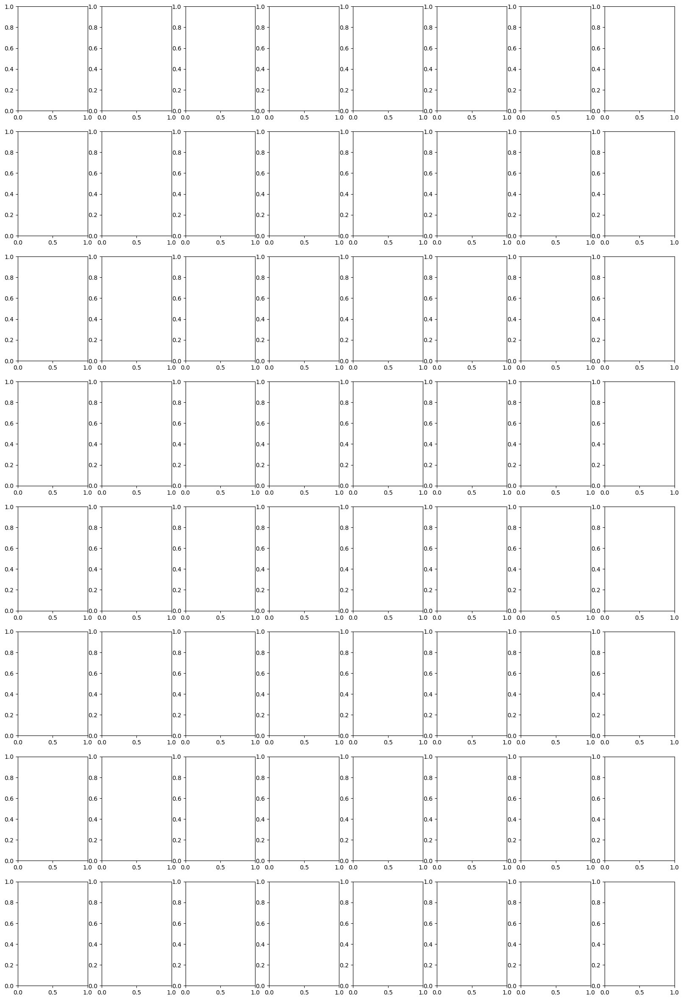

In [15]:
DBScan(data_array)

## DBScan didn't work for this dataset, points are either clustered to one cluster or not clustered for all values of parameters

In [ ]:
plot_gmm(data_array)